In [1]:
import numpy as np
import h5py
import glob
from pathlib import Path 
import scipy.io
import xarray as xr
import cartopy
import matplotlib.pyplot as plt
import matplotlib
from datetime import datetime
import pandas as pd
import warnings; warnings.simplefilter('ignore')
import cartopy.feature as cfeature
import matplotlib.ticker as mticker
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from pyresample import kd_tree, geometry
from pyresample.geometry import GridDefinition
import math

In [2]:
nws_dir = Path('/Users/severinf/Data/raw/sic_nws/') 
smos_dir=Path('/Users/severinf/Data/raw/smos_locean_arctic/')
oisst_dir=Path('/Users/severinf/Data/raw/oisst/')
fig_dir = Path('/Users/severinf/Figures/SASSIE/SASSIE-satellite/')

In [3]:
lonmin=-180
lonmax=-119 #135
latmin=65
latmax=80
lon0=-150

latstep = 10
lonstep=30
land=True

year=2019

In [4]:
def convert_wg_time_to_td64(wg_jd_apres_ref_date, wg_ref = np.datetime64('0000-01-01')):
    """
    Input: wg_jd_apres_ref_date ==> julian date to convert
           wg_ref ==> ref date
    Output: wg_date ==> standard date
    """
    # must be integer
    wg_day_apres_ref_date = int(np.floor(wg_jd_apres_ref_date))
    # must be integer
    wg_seconds  = int(3600*24*( wg_jd_apres_ref_date - wg_day_apres_ref_date))
    wg_date = np.timedelta64(wg_day_apres_ref_date-1, 'D') + np.timedelta64(wg_seconds, 's') +  wg_ref
    return wg_date

In [5]:
def ffgridrms(x,y,data,xgrid,ygrid):
    datagrid_mean = np.empty((len(ygrid),len(xgrid)))
    datagrid_median = np.empty((len(ygrid),len(xgrid)))
    ngrid = np.empty((len(ygrid),len(xgrid)))
    datagridrms = np.empty((len(ygrid),len(xgrid)))
    datagridstd = np.empty((len(ygrid),len(xgrid)))
    datagrid_mean[:] = np.nan
    datagrid_median[:] = np.nan
    ngrid[:] = np.nan
    datagridrms[:] = np.nan
    datagridstd[:] = np.nan
    resx = float(xgrid[1]-xgrid[0]) 
    resy = float(ygrid[1]-ygrid[0])     
    for i in range(0,len(xgrid)):
        for j in range(0,len(ygrid)):
            ind = np.where((abs(xgrid[i]-x)<=resx/2) & (abs(ygrid[j]-y)<=resy/2) & (np.isfinite(data)))
            if len(ind[0])>0:
                datagrid_mean[j,i] = np.nanmean(data[ind],axis=0)
                datagrid_median[j,i] = np.nanmedian(data[ind],axis=0)
                datagridrms[j,i] = np.sqrt(np.nansum(data[ind]**2,axis=0)/len(ind[0]))
                datagridstd[j,i] = np.nanstd(data[ind],axis=0)
                ngrid[j,i] = len(ind[0])
    
    datagrid_mean = np.ma.array(datagrid_mean,mask=(~np.isfinite(datagrid_mean)))
    datagrid_median = np.ma.array(datagrid_median,mask=(~np.isfinite(datagrid_median)))
    datagridrms = np.ma.array(datagridrms,mask=(~np.isfinite(datagridrms)))
    datagridstd = np.ma.array(datagridstd,mask=(~np.isfinite(datagridstd)))
    ngrid = np.ma.array(ngrid,mask=(~np.isfinite(ngrid)))

    return datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms

# Sea Ice Concentration

In [6]:
mat = h5py.File(str(nws_dir) + '/nws_'+str(year)+'.mat')
mat.keys()

<KeysViewHDF5 ['LAT', 'LON', 'amt_poly', 'area', 'date', 'eggcode', 'flag', 'iceconc', 'rangeconc']>

In [7]:
lat_sic=np.array(mat['LAT'])
lon_sic=np.array(mat['LON'])
time_sic=np.array(mat['date'])
date_sic=[]
for itime in np.arange(np.array(mat['date']).size):
    tmp=convert_wg_time_to_td64(time_sic[itime],wg_ref=np.datetime64('0000-01-01'))
    date_sic.append(tmp)                      
# date_sic = " ".join(str(convert_wg_time_to_td64(time_sic[itime],wg_ref=np.datetime64('0000-01-01')))[slice(0,10,1)]\
            # for itime in np.arange(np.array(mat['date'].squeeze()).size)).split()
date_sic[0]

numpy.datetime64('2019-01-01T00:30:00')

In [8]:
#change lon to -180,180
ind=np.where(np.array(mat['LON'][:,0].squeeze())>180)
ind1=np.where(np.array(mat['LON'][:,0].squeeze())<=180)
lon = np.array(mat['LON'][:,0].squeeze()) + 0
lon[ind] = lon[ind]-360
lat=mat['LAT'][0,:].squeeze()

In [9]:
sic_all = xr.DataArray(np.transpose(np.array(mat['iceconc']), (2, 1, 0)), 
coords={'lat': np.array(mat['LAT'])[0,:].squeeze(),'lon': np.array(mat['LON'])[:,0].squeeze(),'time': time_sic.squeeze()}, 
dims=["lat", "lon", "time"])
sic_all

<xarray.DataArray (lat: 501, lon: 1003, time: 365)>
array([[[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
...
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]])
Coordinates:
  * lat      (lat) float64 55.12 55.17 55.23 55.27 ... 79.97 80.03 80.08 80.12
  * lon      (lon) float64 174.8 174.8 174.8 174.9 ... 224.7 224.8 224.8 224.8
  * time     (time) float64 7.374e+05 7.374e+05 ... 7.378e+05 7.378e+05

In [10]:
#mask land temporary, just use "else" when new files from Astrid
if year==2015 or year==2017 or year==2021:
    ind=np.where(~np.isfinite(np.nanmean(sic_all[:,:,0:60],axis=2)))
    mask_land_tmp=np.ones(sic_all[:,:,363].shape)
    mask_land_tmp[ind]=0
    mask_land_tmp=mask_land_tmp.reshape((mask_land_tmp.shape[0], mask_land_tmp.shape[1], 1))
    mask_land=np.tile(mask_land_tmp,(1,1,sic_all.shape[2]))
elif year==2016:
    ind=np.where(~np.isfinite(np.nanmean(sic_all[:,:,-60:],axis=2)))
    mask_land_tmp=np.ones(sic_all[:,:,363].shape)
    mask_land_tmp[ind]=0
    mask_land_tmp=mask_land_tmp.reshape((mask_land_tmp.shape[0], mask_land_tmp.shape[1], 1))
    mask_land=np.tile(mask_land_tmp,(1,1,sic_all.shape[2]))
else:
    ind=np.where(~np.isfinite(np.nanmean(sic_all,axis=2)))
    mask_land_tmp=np.ones(sic_all[:,:,363].shape)
    mask_land_tmp[ind]=0
    mask_land_tmp=mask_land_tmp.reshape((mask_land_tmp.shape[0], mask_land_tmp.shape[1], 1))
    mask_land=np.tile(mask_land_tmp,(1,1,sic_all.shape[2]))

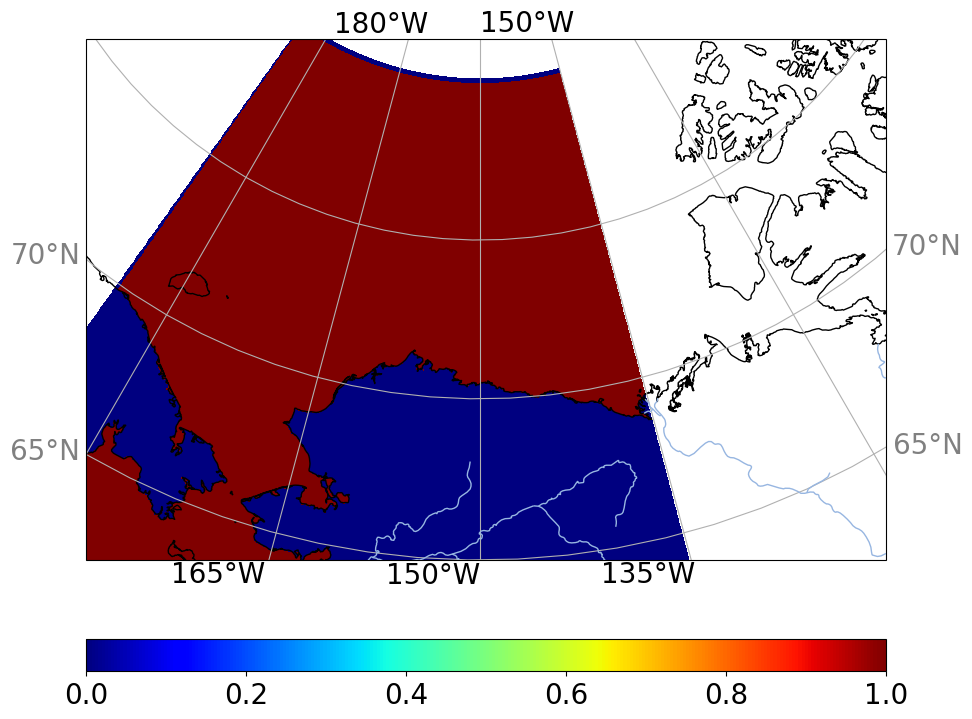

In [11]:
# mask land
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
# ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(sic_all.lon, sic_all.lat, mask_land[:,:,0].squeeze(),cmap=palette,vmin=0,vmax=1,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

In [12]:
# put 0 in all open ocean except when maps are all empty
sic_all2=[]
for i in range(0,sic_all.shape[2]):
    tmp=sic_all.data[:,:,i].squeeze()+0
    ind=np.where(np.isfinite(tmp))
    if len(ind[0])>1:
        ind=np.where(~np.isfinite(tmp))
        tmp[ind]=0
    try:
        sic_all2=np.dstack((sic_all2,tmp))
    except:
        sic_all2=tmp
sic_all2.shape

(501, 1003, 365)

In [13]:
sic_all = xr.DataArray(sic_all2, 
coords={'lat': lat,'lon': lon,'time': time_sic.squeeze()}, 
dims=["lat", "lon", "time"])
sic_all=sic_all.where(mask_land)
sic_all

<xarray.DataArray (lat: 501, lon: 1003, time: 365)>
array([[[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
...
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]])
Coordinates:
  * lat      (lat) float64 55.12 55.17 55.23 55.27 ... 79.97 80.03 80.08 80.12
  * lon      (lon) float64 174.8 174.8 174.8 174.9 ... -135.2 -135.2 -135.2
  * time     (time) float64 7.374e+05 7.374e+05 ... 7.378e+05 7.378e+05

In [14]:
#before 2015 has sic only every 4 days, some other years have data missing
sic_all_interp=sic_all.interpolate_na(dim=('time'), method='nearest')

In [15]:
sic = xr.DataArray(sic_all_interp.data, 
coords={'lat': sic_all_interp.lat.data,'lon': sic_all_interp.lon.data,'time': date_sic}, 
dims=["lat", "lon", "time"]).sel(time=slice(str(year)+'-08-31',str(year)+'-12-30'),lat=slice(latmin,latmax))#,lon=slice(lonmin,lonmax))
sic

<xarray.DataArray (lat: 300, lon: 1003, time: 122)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
...
        ...,
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5],
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5],
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5],
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5],
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5],
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5],
        [9.5, 9.5, 9.5, ..., 9.5, 9.5, 9.5]]])
Coordinates:
  * lat      (lat) float64 65.03 65.08 65.12 65.17 ... 79.83 79.88 79.92 79.97
  * lon      (lon) float64 174.8 174.8 174.8 174.9 ... -135.2 -135.2 -135.2
  * time     (time) datetime64[ns] 2019-08-31T00:30:00 ... 2019-12-30T00:30:00

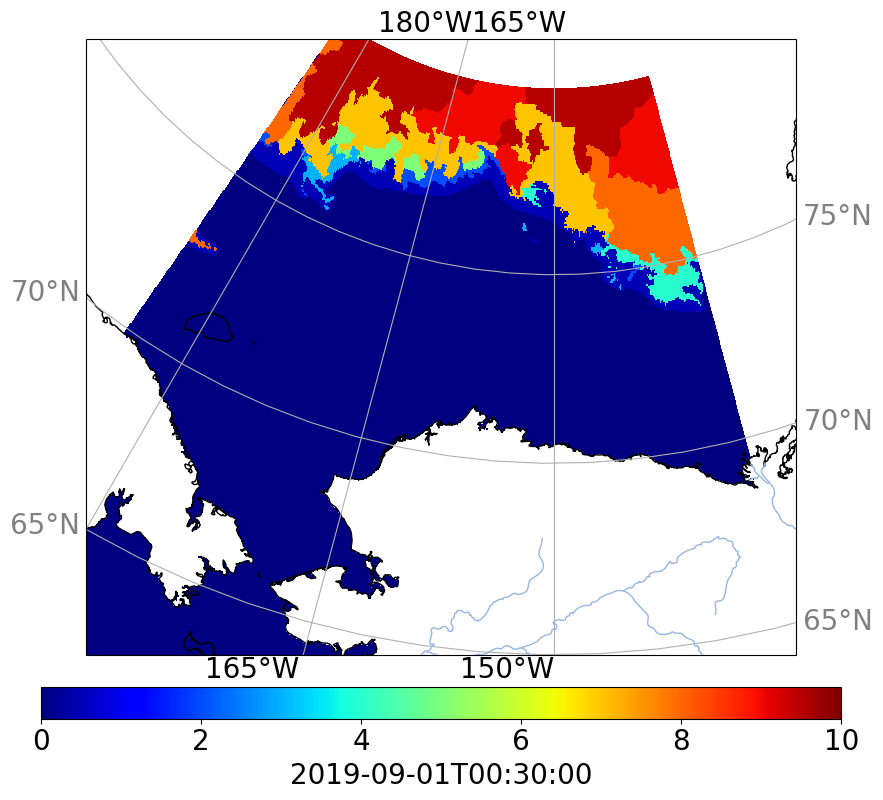

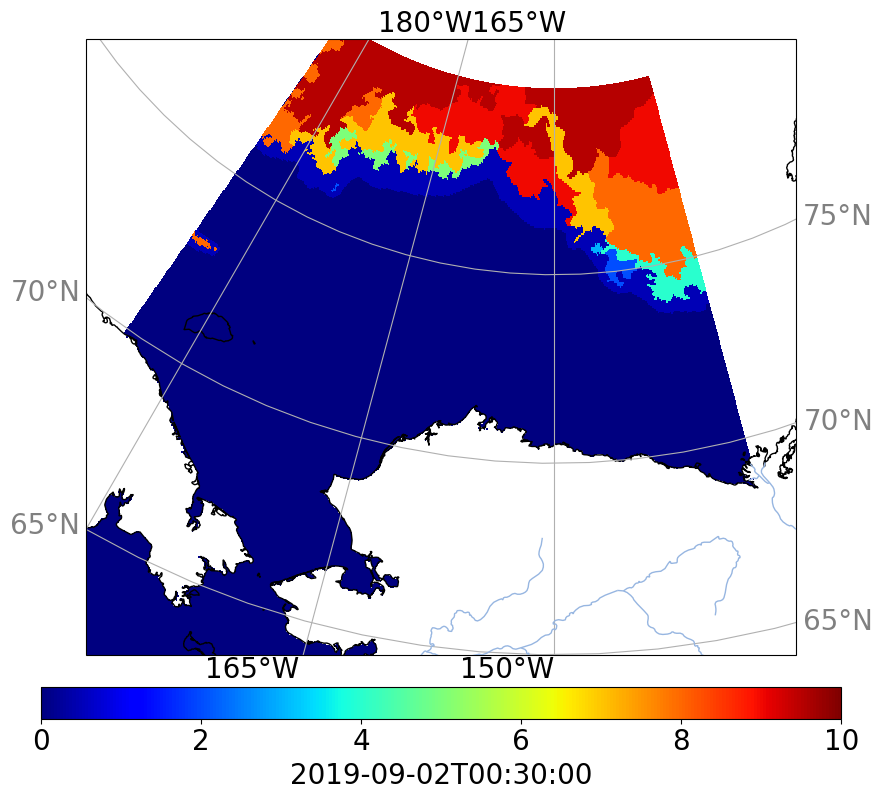

In [16]:
# raw Astrid data
for i in range(243,245):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    # ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(mat['LON'][:,0].squeeze(), mat['LAT'][0,:].squeeze(), np.transpose(mat['iceconc'][i,:,:].squeeze(), (1, 0)),cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label(str(date_sic[i]),fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

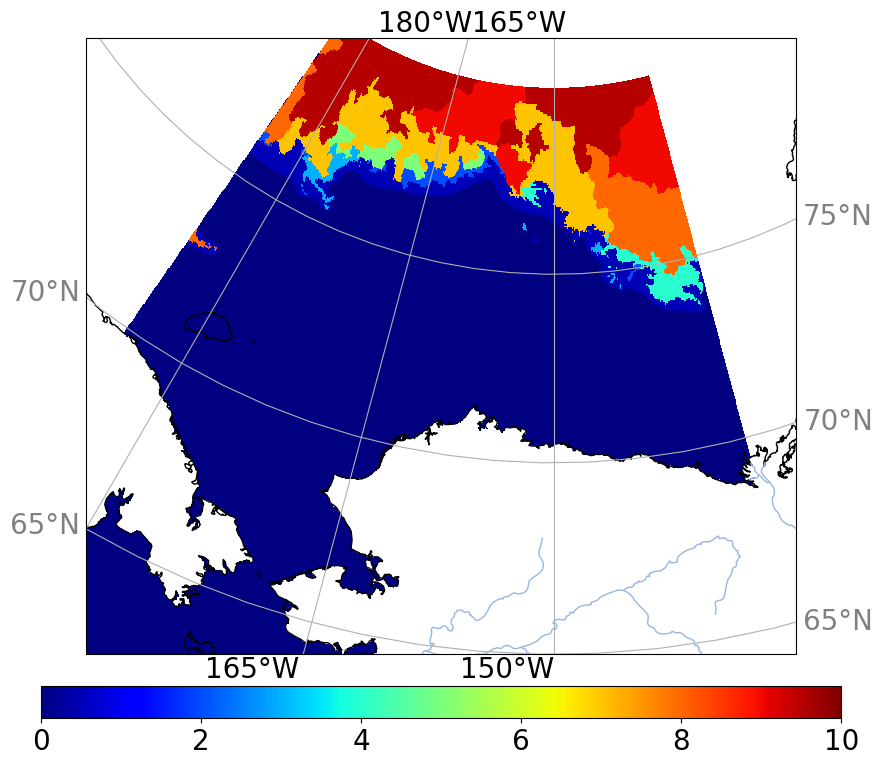

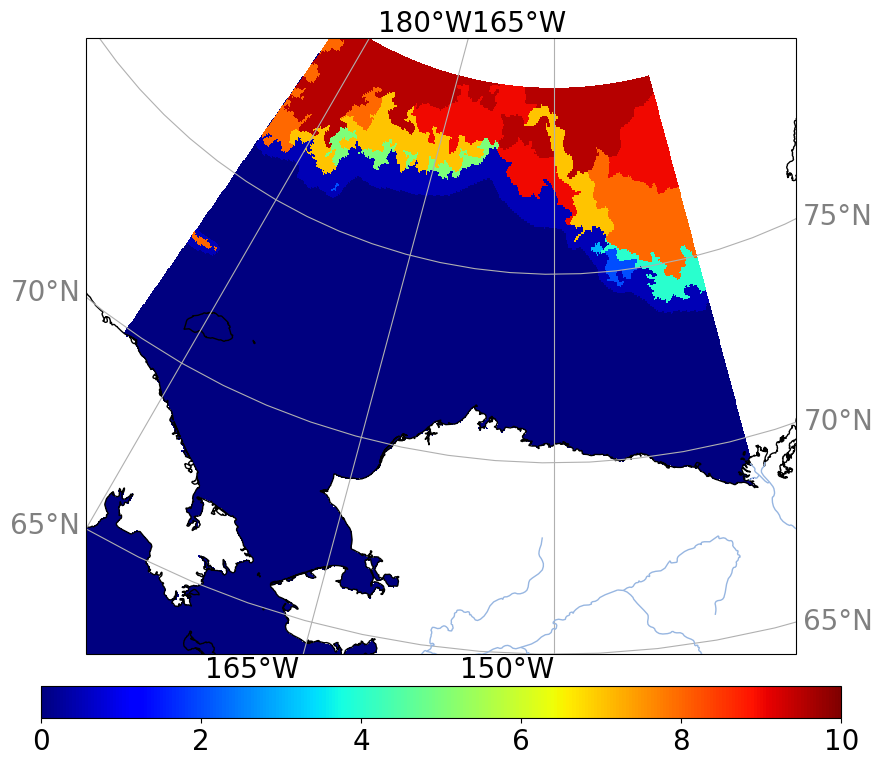

In [17]:
for i in range(243,245):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    # ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(sic_all.lon,sic_all.lat,sic_all[:,:,i].squeeze(),cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

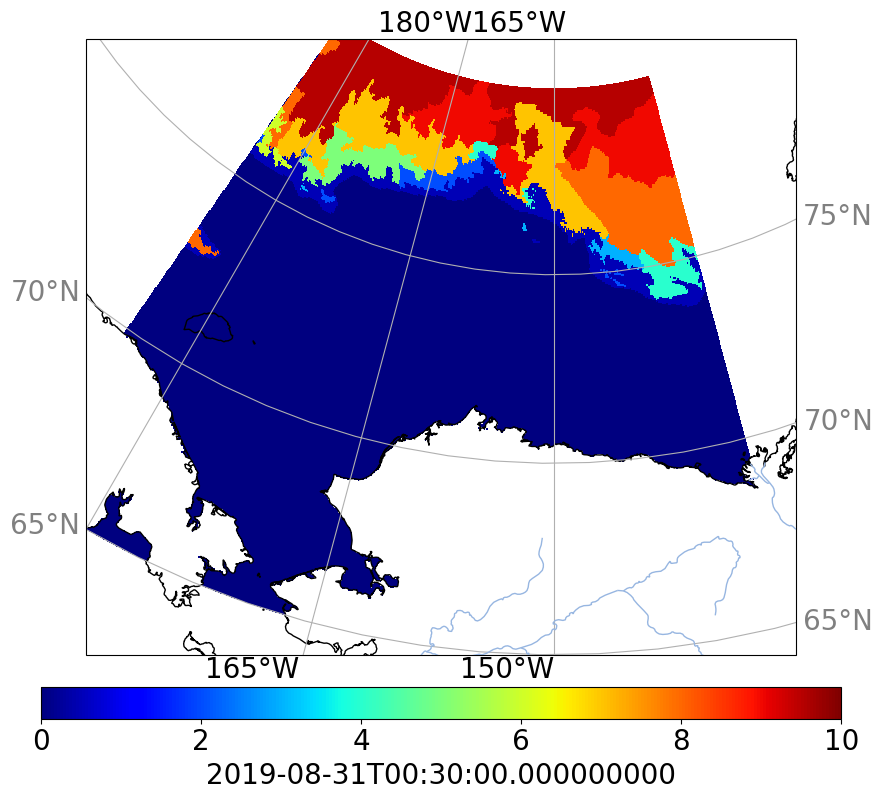

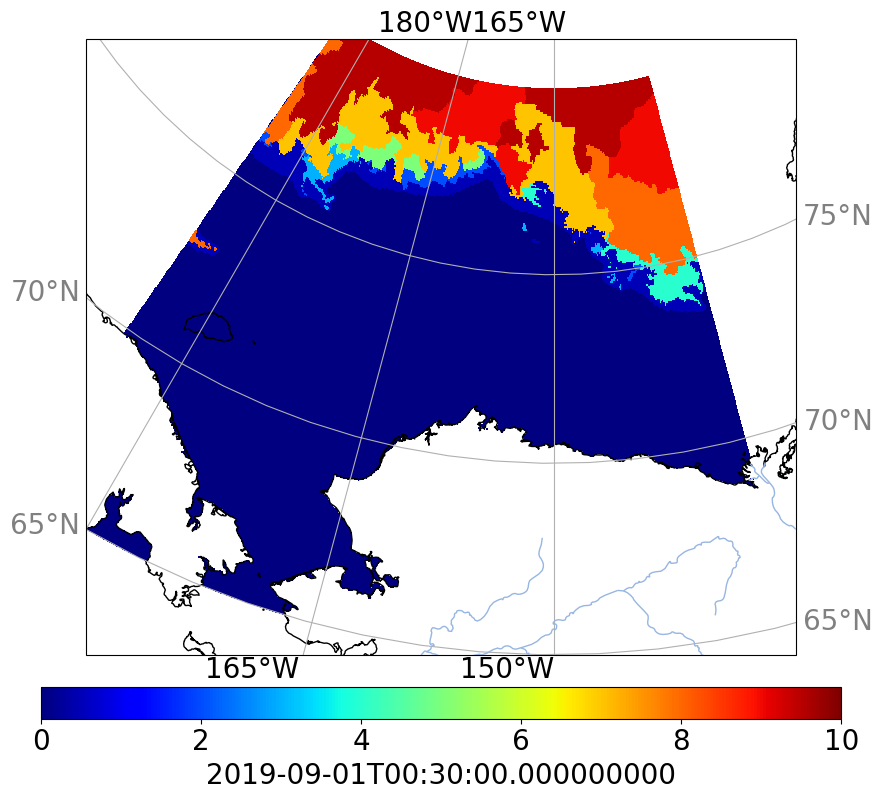

In [18]:
for i in range(0,2):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    # ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(sic.lon,sic.lat,sic[:,:,i].squeeze(),cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label(str(sic.time[i].data),fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

In [19]:
#ice at least 1
freeze=np.zeros(sic.shape)
freeze[:]=np.nan
ind=np.where(sic.data<=1)
freeze[ind]=0
ind=np.where(sic.data>1)
freeze[ind]=1
freeze.shape

(300, 1003, 122)

In [20]:
#ice at least 1 for 5 days
mask_freeze=np.zeros(sic.shape)
ind=np.where(~np.isfinite(freeze))
mask_freeze[ind]=np.nan             
for i in range(5,sic.shape[2]+1):
    tmp=np.nansum(freeze[:,:,i-5:i],axis=2)
    ind=np.where(tmp>=5)
    tmp[:]=0
    tmp[ind]=1
    for j in np.arange(-5,0,1):
        mask_freeze[:,:,i+j]=mask_freeze[:,:,i+j]+tmp
mask_freeze[np.where(mask_freeze>=1)]=1

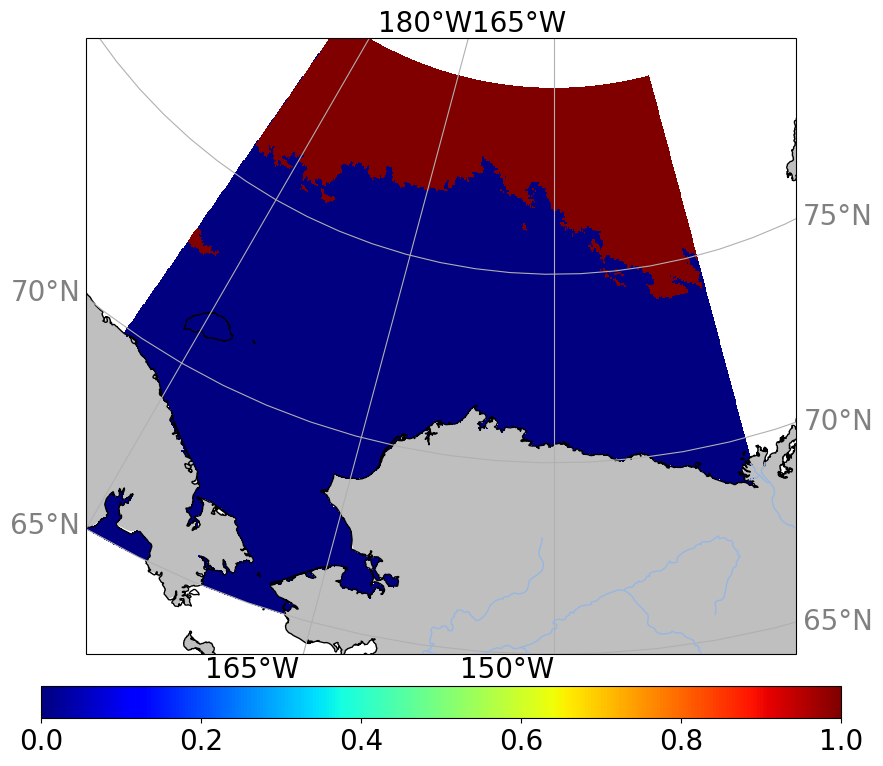

In [21]:
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(sic.lon,sic.lat,freeze[:,:,0].squeeze(),cmap=palette,vmin=0,vmax=1,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

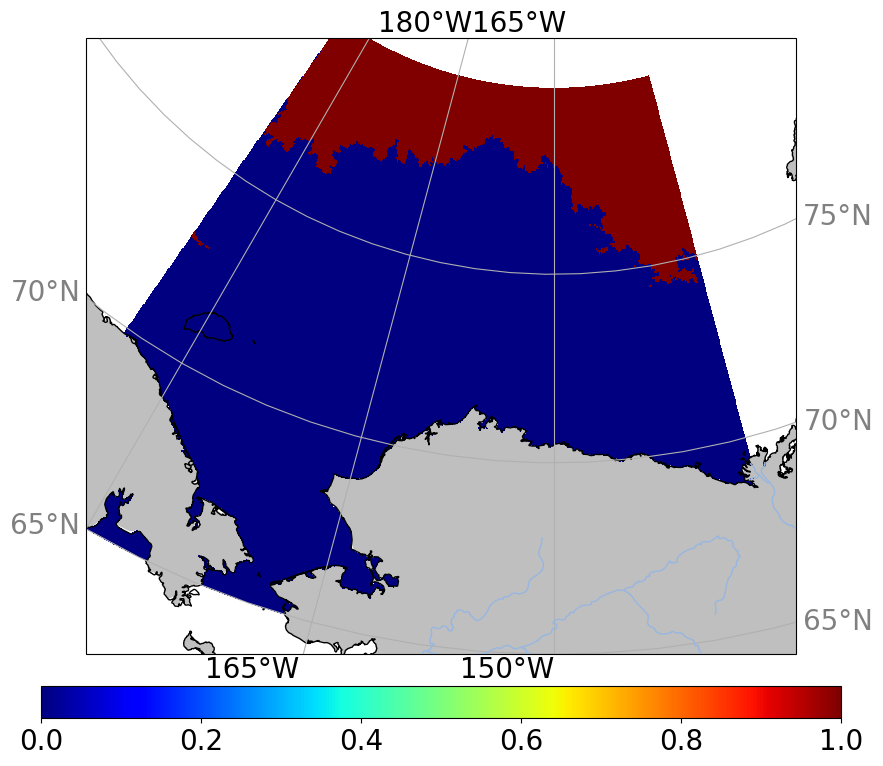

In [22]:
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(sic.lon,sic.lat,mask_freeze[:,:,0].squeeze(),cmap=palette,vmin=0,vmax=1,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

In [23]:
data_vars = {'sic':(['lat','lon','time'], sic.data, {'units': 'tenth', 'long_name':'sea ice concentration in tenth'}),
             'freeze':(['lat','lon','time'], freeze, {'long_name':'pixels higher than 1 tenth in sic'}),
             'mask_freeze':(['lat','lon','time'], mask_freeze, {'long_name':'1: pixel frozen for at least 5 consecutive days, otherwise 0'})
            }
coords = {'lat': (['lat'], sic.lat.data),'lon': (['lon'], sic.lon.data),'time': (['time'], sic.time.data)}
attrs = {'creation_date':str(datetime.now().year)+'-'+str(datetime.now().month).zfill(2)+'-'+str(datetime.now().day).zfill(2), 
         'author':'Severine Fournier'}
nws = xr.Dataset(data_vars=data_vars, 
                coords=coords, 
                attrs=attrs)
nws

<xarray.Dataset>
Dimensions:      (lat: 300, lon: 1003, time: 122)
Coordinates:
  * lat          (lat) float64 65.03 65.08 65.12 65.17 ... 79.88 79.92 79.97
  * lon          (lon) float64 174.8 174.8 174.8 174.9 ... -135.2 -135.2 -135.2
  * time         (time) datetime64[ns] 2019-08-31T00:30:00 ... 2019-12-30T00:...
Data variables:
    sic          (lat, lon, time) float64 nan nan nan nan ... 9.5 9.5 9.5 9.5
    freeze       (lat, lon, time) float64 nan nan nan nan ... 1.0 1.0 1.0 1.0
    mask_freeze  (lat, lon, time) float64 nan nan nan nan ... 1.0 1.0 1.0 1.0
Attributes:
    creation_date:  2024-09-24
    author:         Severine Fournier

In [24]:
date = pd.to_datetime(nws.time)
doy_open_first=np.empty((nws.mask_freeze.data[:,:,0].squeeze().shape))
doy_open_first[:]=np.nan
doy_open_last=np.empty((nws.mask_freeze.data[:,:,0].squeeze().shape))
doy_open_last[:]=np.nan
for i in range(nws.mask_freeze.data.shape[0]):
    for j in range(nws.mask_freeze.data.shape[1]):
        idx=np.where(nws.mask_freeze.data[i,j,:]==0) #where we have no ice
        if len(idx[0])>1:
            doy_open_first[i,j]=date.dayofyear[idx[0][0]] #doy_open_first: first day of no 'ice for at least 5 days' after September
            doy_open_last[i,j]=date.dayofyear[idx[0][-1]]+1 #doy_open_last: last day of no 'ice for at least 5 days' after September

In [25]:
doy_start=date.dayofyear[0]
doy_freeze_first=np.empty((nws.mask_freeze.data[:,:,0].squeeze().shape))
doy_freeze_first[:]=np.nan
for i in range(nws.mask_freeze.data.shape[0]):
    for j in range(nws.mask_freeze.data.shape[1]):
        idx=np.where(nws.mask_freeze.data[i,j,:]==1)[0] #where we have ice
        if len(idx)>1 and np.isfinite(doy_open_first[i,j]):
            idx=np.delete(idx,np.where(idx<=int(doy_open_first[i,j]-doy_start)))
            if len(idx)>1: #otherwise it means it never freezes past the first day of open after september
                doy_freeze_first[i,j]=date.dayofyear[idx[0]] #first day of 'ice for at least 5 days' after 'first day of no 'ice for at least 5 days'

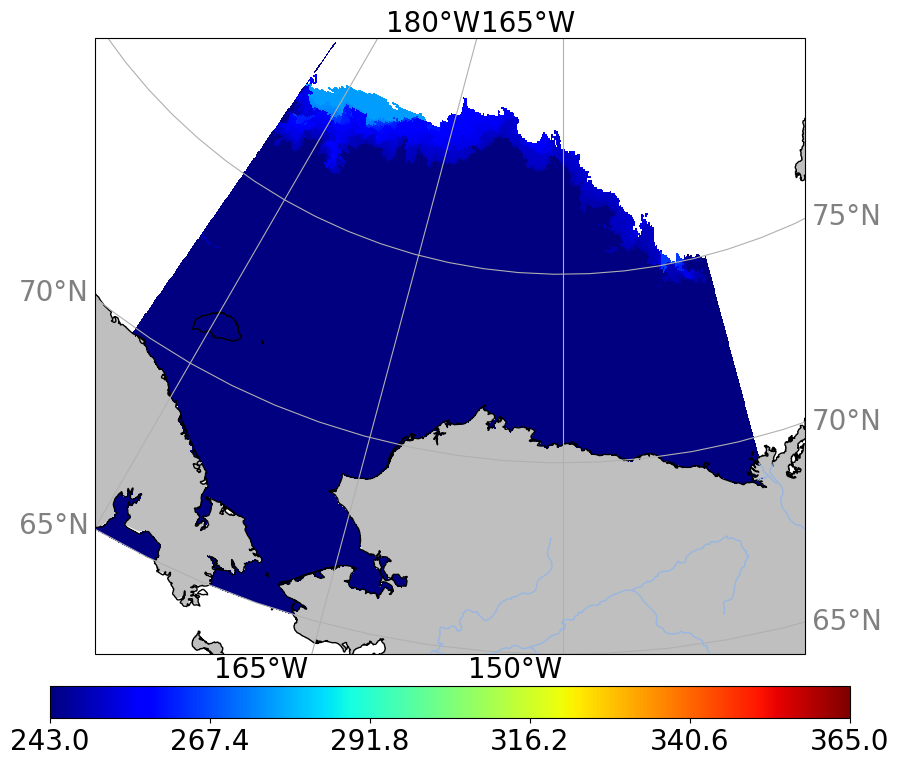

In [26]:
# Map of the first day of no 'ice for at least 5 days' after September

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,doy_open_first,cmap=palette,vmin=243,vmax=365,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_day1noice_after09'+str(year)+'.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

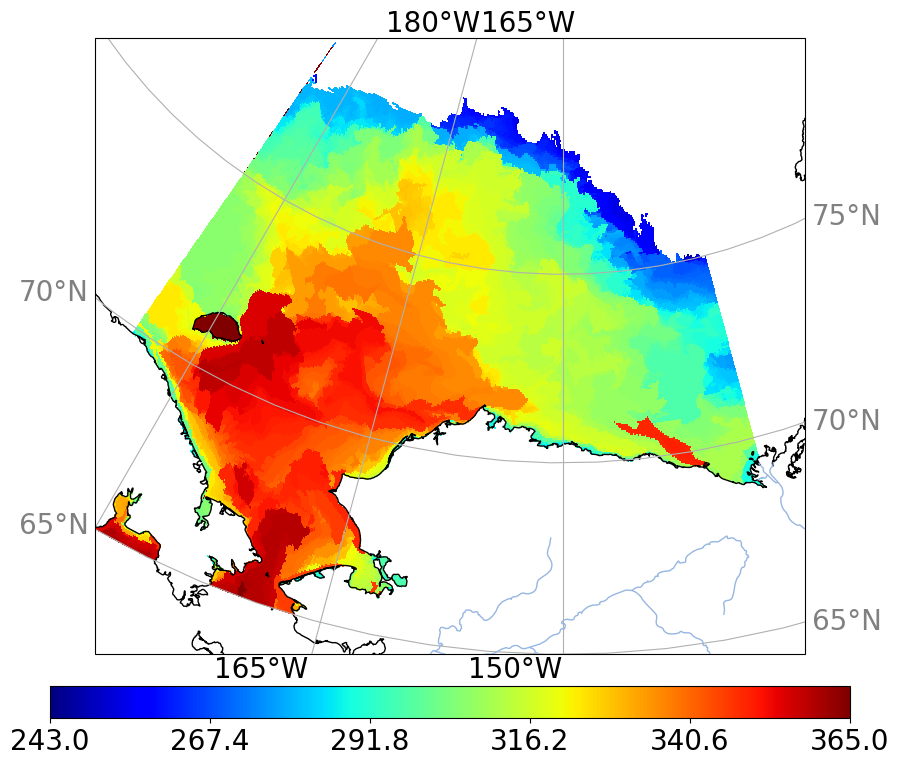

In [27]:
# Map of the last day of 'no ice for at least 5 days' after September

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
# ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,doy_open_last,cmap=palette,vmin=243,vmax=365,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_daylastnoice_after09'+str(year)+'.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

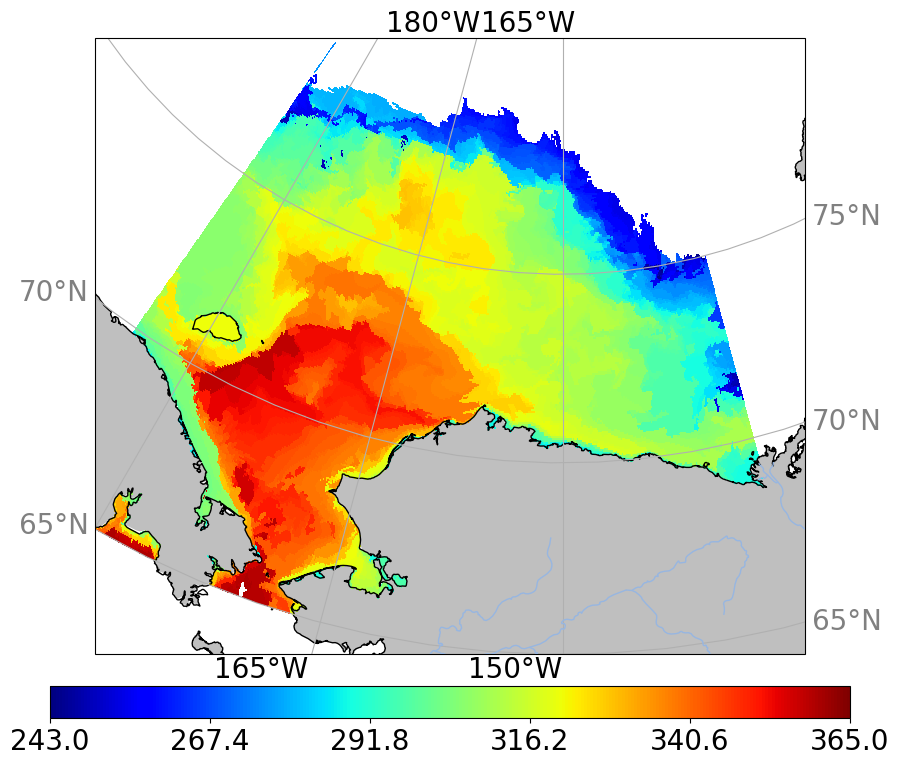

In [28]:
# Map first day of 'ice for at least 5 days' after 'first day of no 'ice for at least 5 days'

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,doy_freeze_first,cmap=palette,vmin=243,vmax=365,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_day1ice_afterday1noice.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

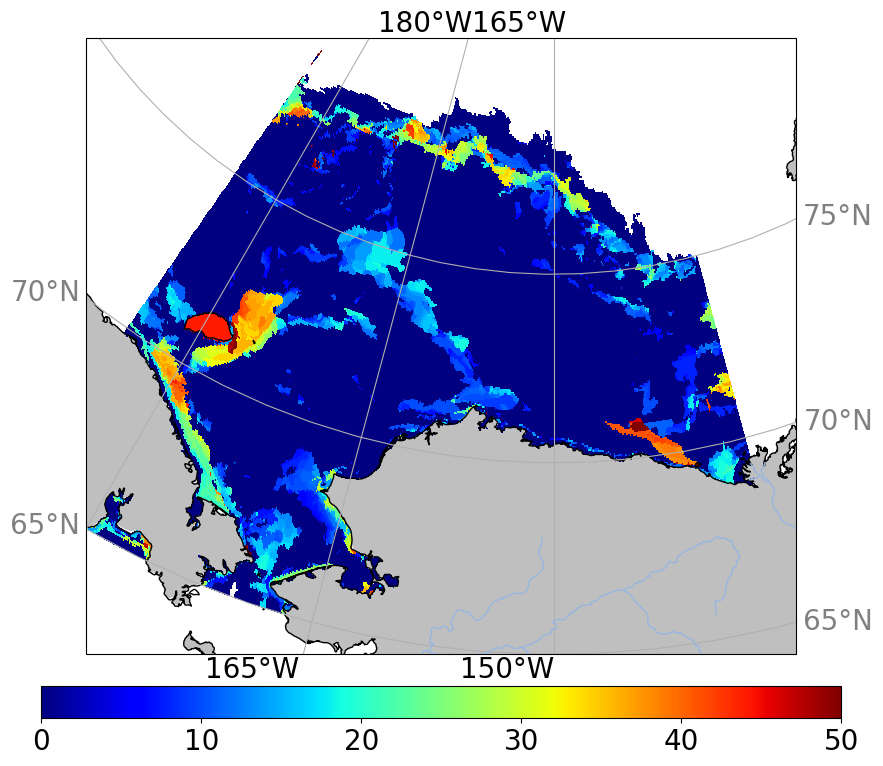

In [29]:
# Map of the difference:
# last day of no 'ice for at least 5 days' after September
# minus first day of 'ice for at least 5 days' after 'first day of no 'ice for at least 5 days'

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,doy_open_last-doy_freeze_first,cmap=palette,vmin=0,vmax=50,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_diff_daylastnoice_after09'+str(year)+'-day1ice_afterday1noice.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

In [30]:
#days it took for ice to go from ice (sic>1 for at least 5 days) to 50% of ice at first freeze up
map050_first=np.zeros(doy_freeze_first.shape)
map050_first[:]=np.nan
for i in range(0,doy_freeze_first.shape[0]):
    for j in range(0,doy_freeze_first.shape[1]):
        if np.isfinite(doy_freeze_first[i,j]):
            ind=np.where(sic.data[i,j,int(doy_freeze_first[i,j]-date.dayofyear[0]):]>=5)
            if len(ind[0])>0:
                map050_first[i,j]=ind[0][0]
            else: #it never reached 50% concentration
                map050_first[i,j]=np.nan

#days it took for ice to go from ice (sic>1 for at least 5 days) to 80% of ice at first freeze up
map080_first=np.zeros(doy_freeze_first.shape)
map080_first[:]=np.nan
for i in range(0,doy_freeze_first.shape[0]):
    for j in range(0,doy_freeze_first.shape[1]):
        if np.isfinite(doy_freeze_first[i,j]):
            ind=np.where(sic.data[i,j,int(doy_freeze_first[i,j]-date.dayofyear[0]):]>=8)
            if len(ind[0])>0:
                map080_first[i,j]=ind[0][0]
            else: #it never reached 80% concentration
                map080_first[i,j]=np.nan

In [31]:
#days it took for ice to go from ice (sic>1 for at least 5 days) to 50% of ice at last freeze up
map050_last=np.zeros(doy_open_last.shape)
map050_last[:]=np.nan
for i in range(0,doy_open_last.shape[0]):
    for j in range(0,doy_open_last.shape[1]):
        if np.isfinite(doy_open_last[i,j]):
            ind=np.where(sic.data[i,j,int(doy_open_last[i,j]+1-date.dayofyear[0]):]>=5)
            if len(ind[0])>0:
                map050_last[i,j]=ind[0][0]
            else: #it never reached 50% concentration
                map050_last[i,j]=np.nan

#days it took for ice to go from ice (sic>1 for at least 5 days) to 80% of ice at last freeze up
map080_last=np.zeros(doy_open_last.shape)
map080_last[:]=np.nan
for i in range(0,doy_open_last.shape[0]):
    for j in range(0,doy_open_last.shape[1]):
        if np.isfinite(doy_open_last[i,j]):
            ind=np.where(sic.data[i,j,int(doy_open_last[i,j]+1-date.dayofyear[0]):]>=8)
            if len(ind[0])>0:
                map080_last[i,j]=ind[0][0]
            else: #it never reached 80% concentration
                map080_last[i,j]=np.nan

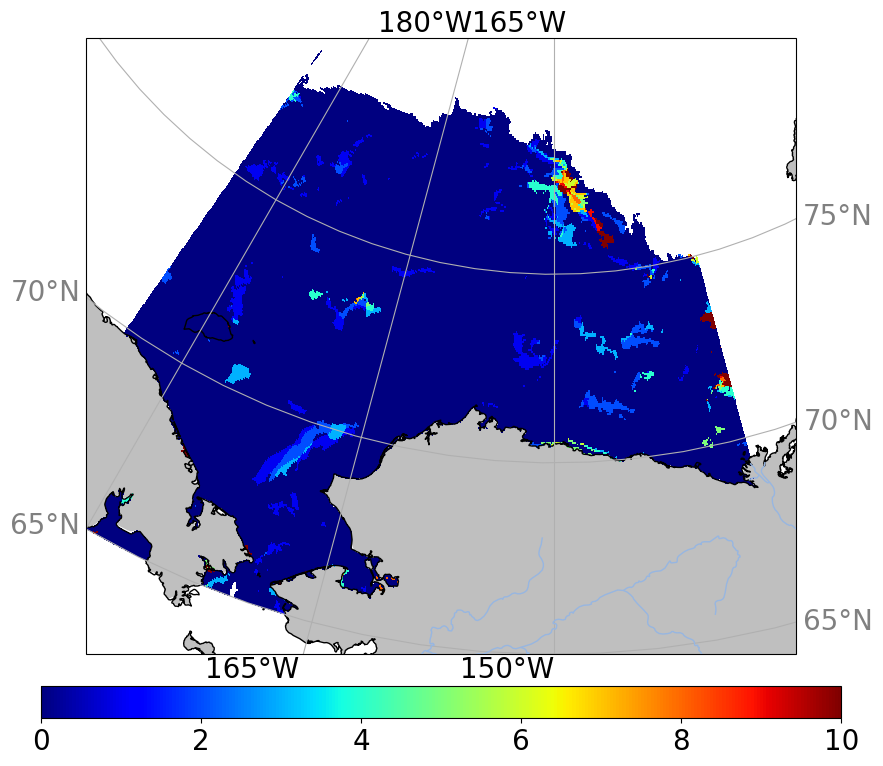

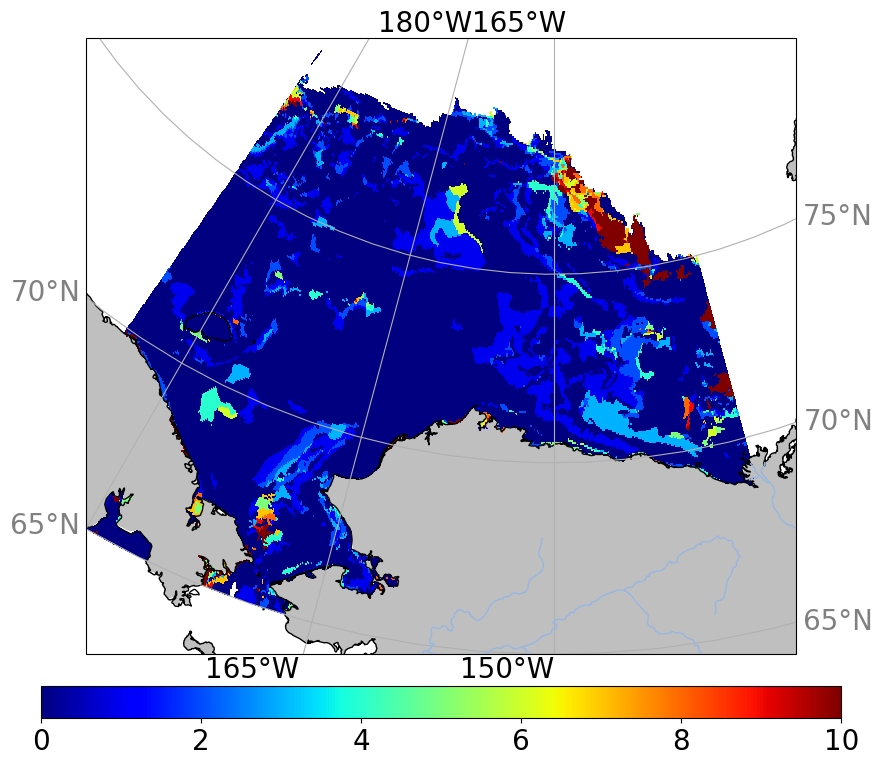

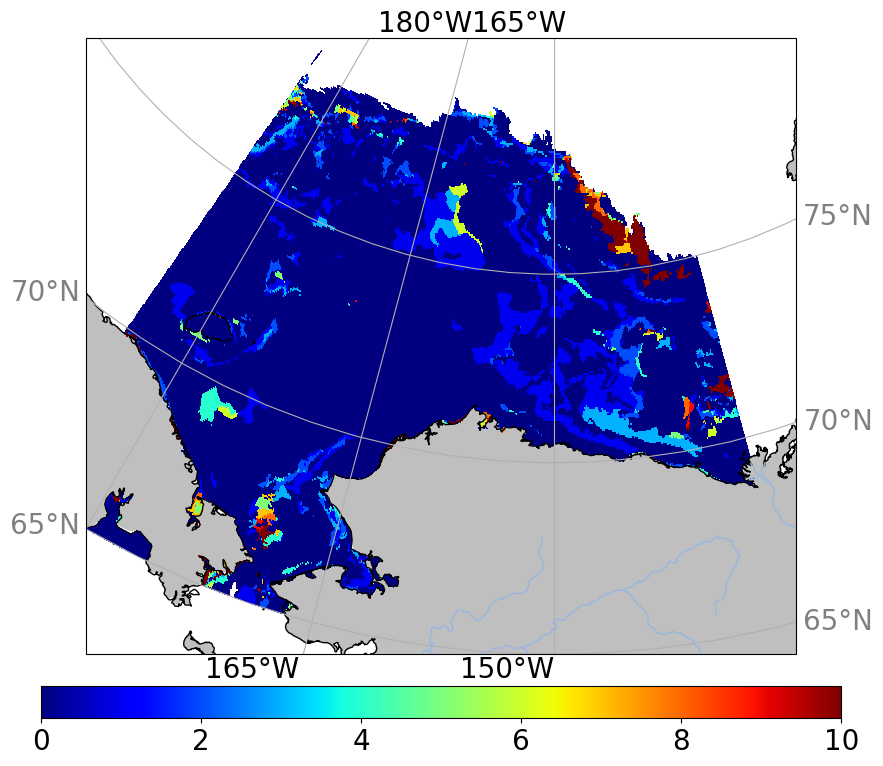

In [32]:
# Map of nb of days it took for ice to go from ice (sic>1 for at least 5 days) to 50% of ice at first freeze up
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,map050_first,cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_iceto50_firstfreeze_'+str(year)+'.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

# Map of nb of days it took for ice to go from ice (sic>1 for at least 5 days) to 80% of ice at first freeze up
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,map080_first,cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_iceto80_firstfreeze_'+str(year)+'.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

# Map of the difference at first freeze up
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,map080_first-map050_first,cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_diff_iceto80-iceto50_firstfreeze_'+str(year)+'.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

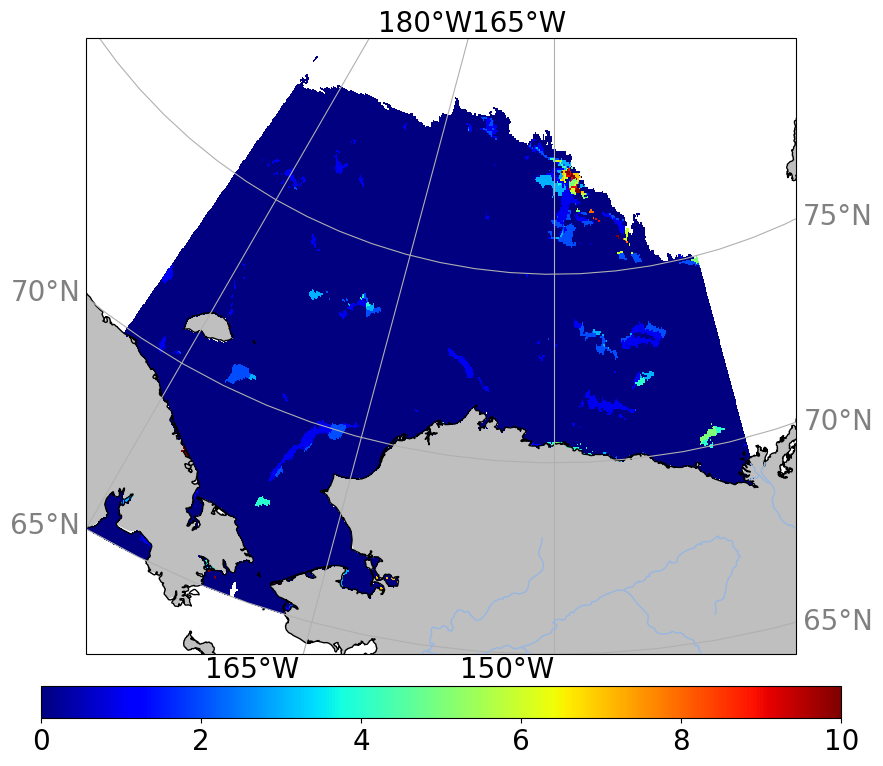

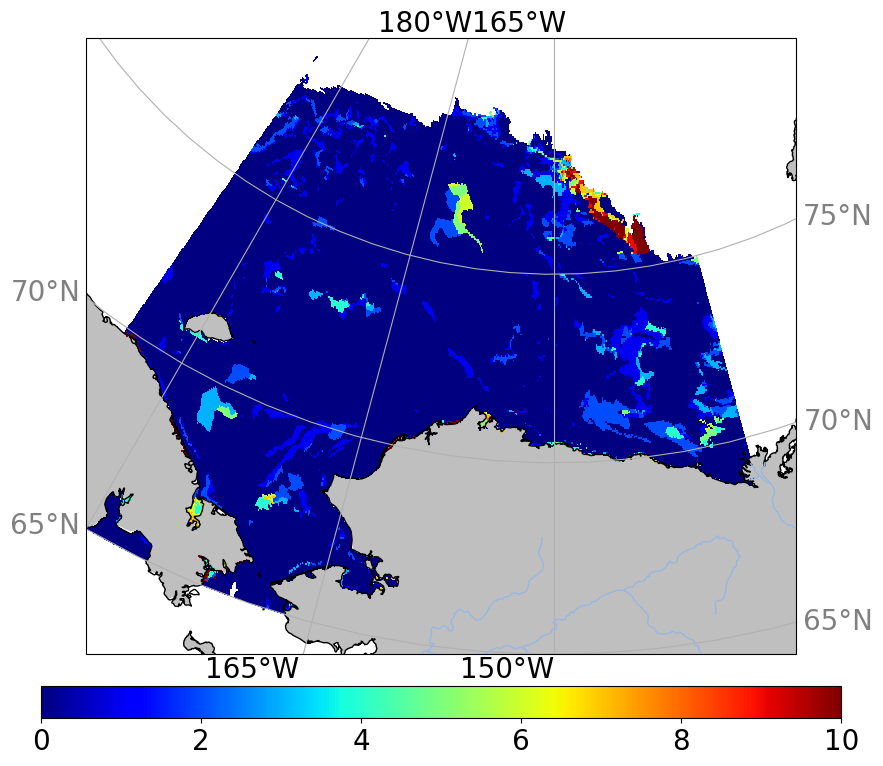

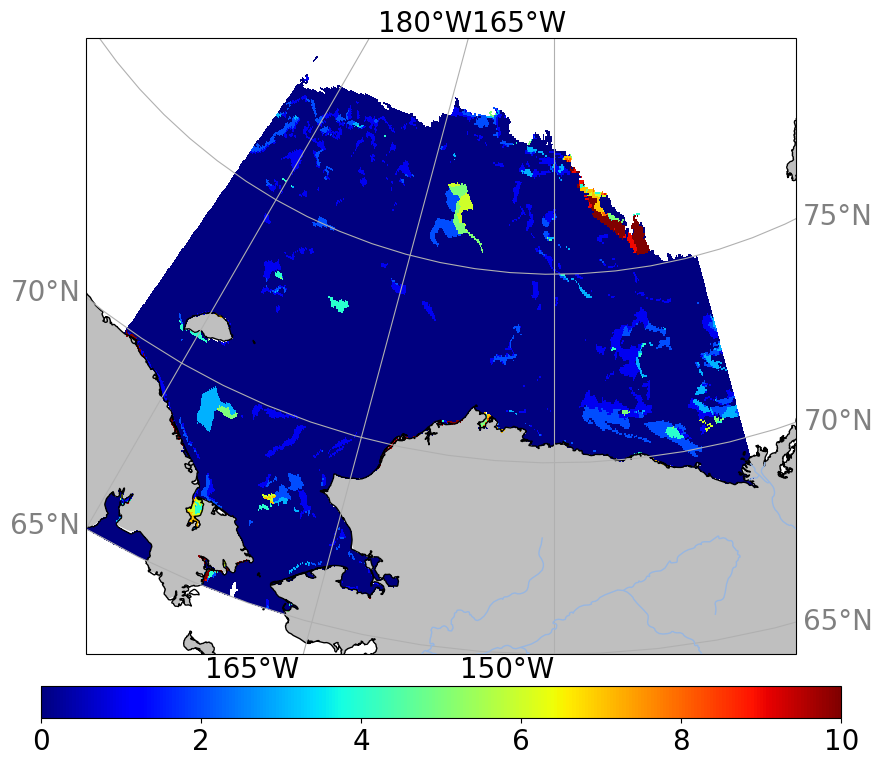

In [33]:
# Map of nb of days it took for ice to go from ice (sic>1 for at least 5 days) to 50% of ice at last freeze up
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,map050_last,cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_iceto50_lastfreeze_'+str(year)+'.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

# Map of nb of days it took for ice to go from ice (sic>1 for at least 5 days) to 80% of ice at last freeze up
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,map080_last,cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_iceto80_lastfreeze_'+str(year)+'.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

# Map of the difference at last freeze up
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(nws.lon,nws.lat,map080_last-map050_last,cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
fig_name='map_diff_iceto80-iceto50_lastfreeze_'+str(year)+'.png'
#plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

# Sea Surface Temperature

In [34]:
files=list(oisst_dir.glob('oisst_'+str(year)+'*.nc'))
files=np.sort(files)
tmp = xr.open_mfdataset(paths=files).sel(time=slice(str(year)+'-08-31',str(year)+'-12-30'),lat=slice(latmin,latmax),zlev=0)
tmp=tmp.drop('zlev')

In [35]:
new_lon = tmp.lon.values + 0
new_lon[new_lon > 180] = new_lon[new_lon > 180]-360
tmp=tmp.drop('lon')
tmp=tmp.assign_coords({'lon': new_lon})
D = tmp.anom[:,:,180:]
C = tmp.anom[:,:,0:180:]
F = tmp.ice[:,:,180:]
E = tmp.ice[:,:,0:180:]
H = tmp.err[:,:,180:]
G = tmp.err[:,:,0:180:]

B = tmp.sst[:,:,180:]
A = tmp.sst[:,:,0:180:]
oisst = xr.merge([B, A]).transpose('lat','lon','time')

In [36]:
oisst = oisst.assign(
    anom=(['lat','lon','time'],xr.merge([D, C]).transpose('lat','lon','time').anom.data),
    ice=(['lat','lon','time'],xr.merge([F, E]).transpose('lat','lon','time').ice.data), 
    err=(['lat','lon','time'],xr.merge([H, G]).transpose('lat','lon','time').err.data),
                    )
oisst.anom.attrs['long_name'] = tmp.anom.attrs['long_name']
oisst.anom.attrs['units'] = tmp.anom.attrs['units']
oisst.anom.attrs['valid_min'] = tmp.anom.attrs['valid_min']
oisst.anom.attrs['valid_max'] = tmp.anom.attrs['valid_max']

oisst.ice.attrs['long_name'] = tmp.ice.attrs['long_name']
oisst.ice.attrs['units'] = tmp.ice.attrs['units']
oisst.ice.attrs['valid_min'] = tmp.ice.attrs['valid_min']
oisst.ice.attrs['valid_max'] = tmp.ice.attrs['valid_max']

oisst.err.attrs['long_name'] = tmp.err.attrs['long_name']
oisst.err.attrs['units'] = tmp.err.attrs['units']
oisst.err.attrs['valid_min'] = tmp.err.attrs['valid_min']
oisst.err.attrs['valid_max'] = tmp.err.attrs['valid_max']
oisst

<xarray.Dataset>
Dimensions:  (time: 122, lat: 60, lon: 1440)
Coordinates:
  * time     (time) datetime64[ns] 2019-08-31T12:00:00 ... 2019-12-30T12:00:00
  * lat      (lat) float32 65.12 65.38 65.62 65.88 ... 79.12 79.38 79.62 79.88
  * lon      (lon) float32 -179.9 -179.6 -179.4 -179.1 ... 179.4 179.6 179.9
Data variables:
    sst      (lat, lon, time) float32 dask.array<chunksize=(60, 1440, 1), meta=np.ndarray>
    anom     (lat, lon, time) float32 dask.array<chunksize=(60, 1440, 1), meta=np.ndarray>
    ice      (lat, lon, time) float32 dask.array<chunksize=(60, 1440, 1), meta=np.ndarray>
    err      (lat, lon, time) float32 dask.array<chunksize=(60, 1440, 1), meta=np.ndarray>
Attributes:
    long_name:  Daily sea surface temperature
    valid_min:  -300
    valid_max:  4500
    units:      Celsius

# Sea Surface Salinity

In [37]:
files=list(smos_dir.glob('SMOS_L3_DEBIAS_LOCEAN_AD_'+str(year)+'*.nc'))
files=np.sort(files)
smos = xr.open_mfdataset(paths=files).sel(time=slice(str(year)+'-08-31',str(year)+'-12-30'))
smos

<xarray.Dataset>
Dimensions:  (time: 122, nx: 392, ny: 392)
Coordinates:
  * time     (time) datetime64[ns] 2019-08-31 2019-09-01 ... 2019-12-30
Dimensions without coordinates: nx, ny
Data variables:
    lat      (time, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    lon      (time, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    SSS      (time, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    eSSS     (time, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
Attributes:
    creation_time:  15-Dec-2023 19:05:15
    institution:    CEC-OS LOCEAN/IPSL/ACRI-ST
    Conventions:    CF-1.6
    keywords:       Ocean, Ocean Salinity, Sea Surface Salinity, Satellite
    history:        Processed on 2023-11-03 by $Id: prepare_data_CEC_Arctic_2...
    source:         SMOS L2OS RE07From L2_v7 and L1_v7 (ESA, 3rd reprocessing...
    comment:

## SSS climatology

In [46]:
files=list(smos_dir.glob('SMOS_L3_DEBIAS_LOCEAN_AD_*.nc'))
files=np.sort(files)
smos_clim = xr.open_mfdataset(paths=files)
smos_clim=smos_clim.sel(time=smos_clim.time.dt.month.isin([8, 9, 10, 11, 12]))

In [47]:
smos_clim = smos_clim.assign_coords(month=smos_clim.time.dt.strftime("%m"))
smos_clim = smos_clim.groupby("month").mean(dim="time",skipna=True)
smos_clim

<xarray.Dataset>
Dimensions:  (month: 5, nx: 392, ny: 392)
Coordinates:
  * month    (month) object '08' '09' '10' '11' '12'
Dimensions without coordinates: nx, ny
Data variables:
    lat      (month, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    lon      (month, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    SSS      (month, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    eSSS     (month, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
Attributes:
    creation_time:  15-Dec-2023 17:29:37
    institution:    CEC-OS LOCEAN/IPSL/ACRI-ST
    Conventions:    CF-1.6
    keywords:       Ocean, Ocean Salinity, Sea Surface Salinity, Satellite
    history:        Processed on 2023-11-03 by $Id: prepare_data_CEC_Arctic_2...
    source:         SMOS L2OS RE07From L2_v7 and L1_v7 (ESA, 3rd reprocessing...
    comment:

In [48]:
smos = smos.assign_coords(month=smos.time.dt.strftime("%m"))
ano_sss = smos.groupby("month") - smos_clim
ano_sss

<xarray.Dataset>
Dimensions:  (time: 122, nx: 392, ny: 392)
Coordinates:
  * time     (time) datetime64[ns] 2019-08-31 2019-09-01 ... 2019-12-30
    month    (time) object '08' '09' '09' '09' '09' ... '12' '12' '12' '12' '12'
Dimensions without coordinates: nx, ny
Data variables:
    lat      (time, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    lon      (time, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    SSS      (time, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>
    eSSS     (time, nx, ny) float32 dask.array<chunksize=(1, 392, 392), meta=np.ndarray>

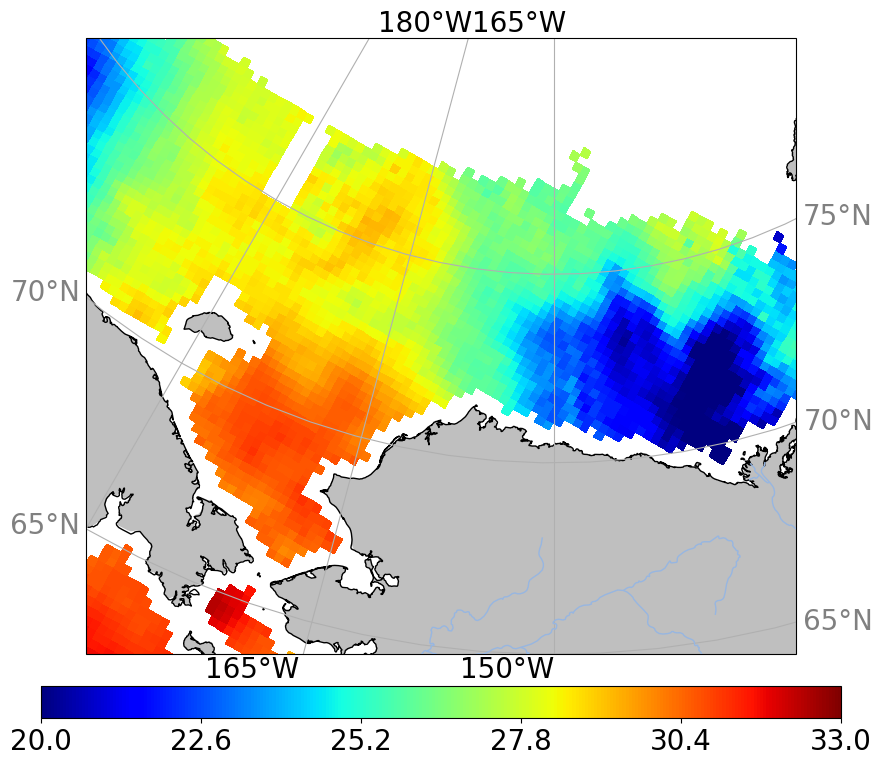

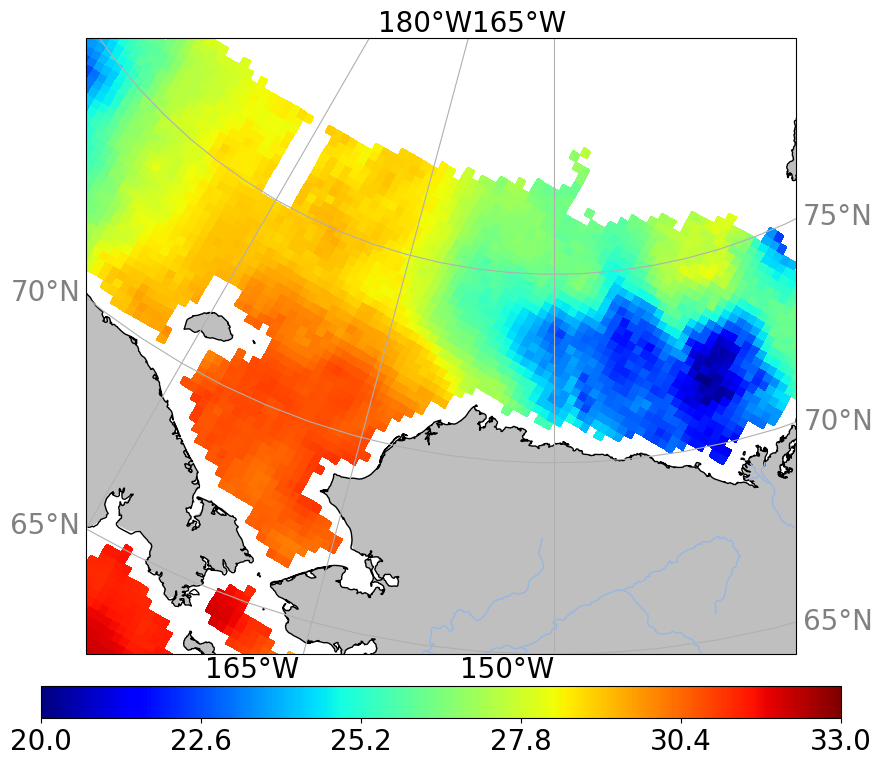

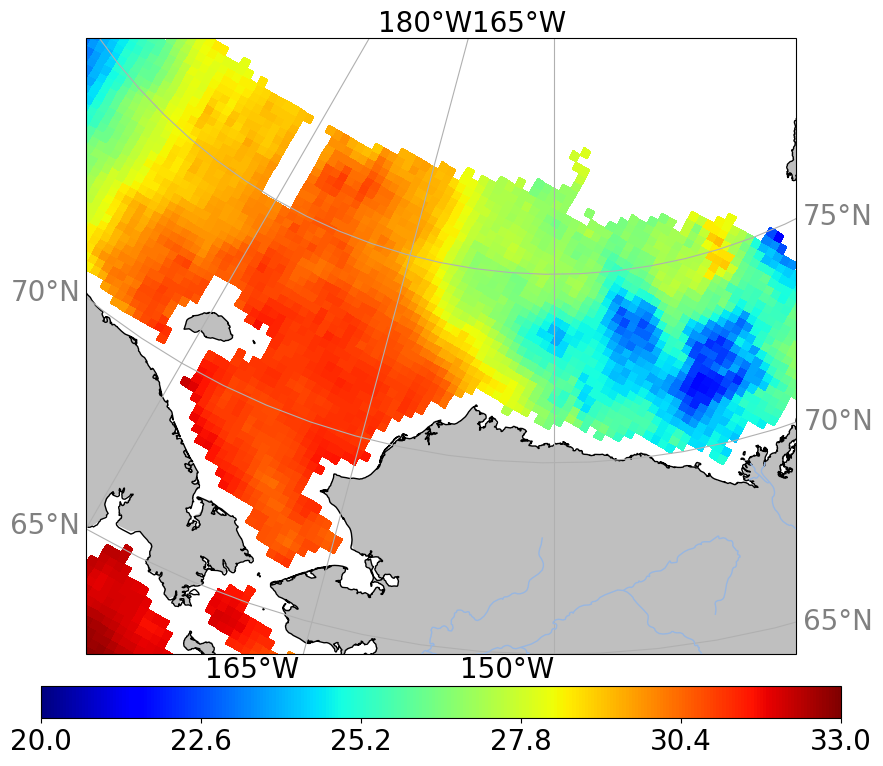

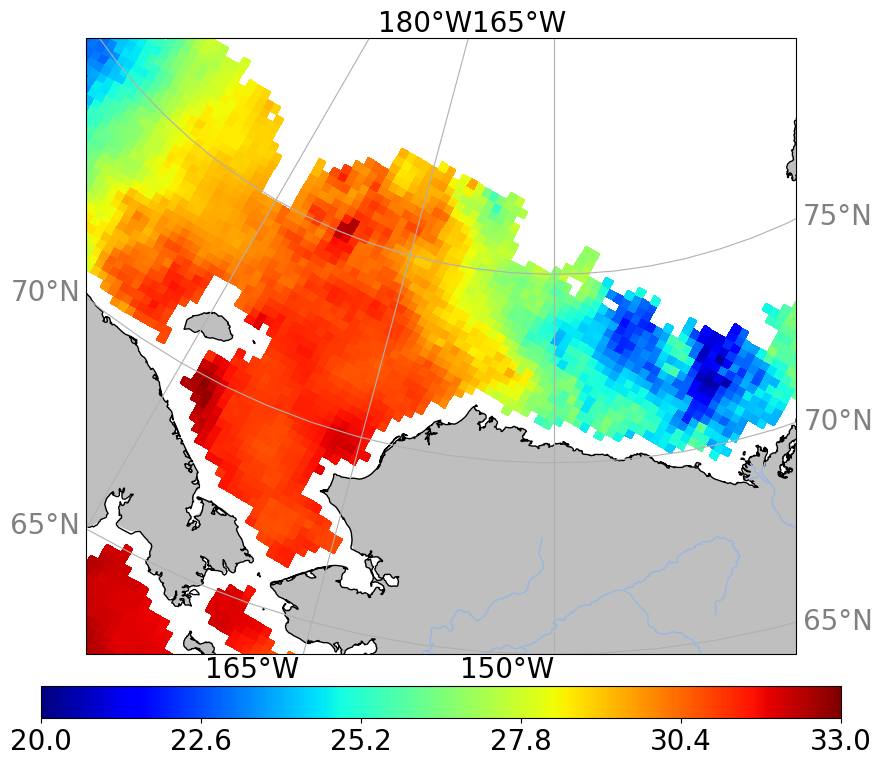

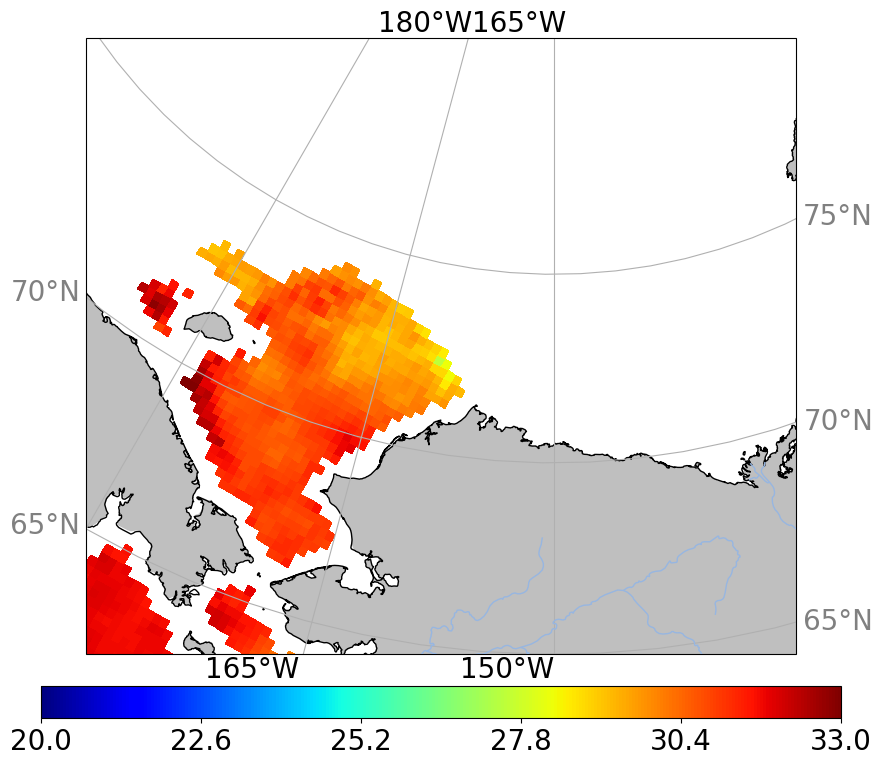

In [49]:
#plot monthly clim
for month in range(0,5):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(smos.lon[0,:,:].squeeze(),smos.lat[0,:,:].squeeze(),smos_clim.SSS[month,:,:].squeeze(),cmap=palette,vmin=20,vmax=33,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

## Interpolation on NWS grid

In [50]:
longrid=nws.lon
latgrid=nws.lat
[LOgrid,LAgrid]=np.meshgrid(nws.lon,nws.lat)
[LOoisst,LAoisst]=np.meshgrid(oisst.lon,oisst.lat)

nws_def = geometry.GridDefinition(lons=LOgrid, lats=LAgrid)
smos_def = geometry.GridDefinition(lons=np.array(smos.lon[0,:,:].squeeze()), lats=np.array(smos.lat[0,:,:].squeeze())) 
oisst_def = geometry.GridDefinition(lons=LOoisst, lats=LAoisst) 

In [51]:
oisst_regrid=[]
for i in range(0,oisst.sst.shape[2]):
    tmp=np.array(oisst.sst[:,:,i].squeeze().data)
    tmp_grid = kd_tree.resample_nearest(oisst_def, tmp, nws_def, radius_of_influence=100000, fill_value=np.nan) #10km?
    try:
        oisst_regrid=np.dstack((oisst_regrid,tmp_grid))
    except:
        oisst_regrid=tmp_grid

In [52]:
smos_regrid=[]
for i in range(0,smos.SSS.shape[0]):
    tmp=np.array(smos.SSS[i,:,:].squeeze().data)
    tmp_grid = kd_tree.resample_nearest(smos_def, tmp, nws_def, radius_of_influence=100000, fill_value=np.nan) #10km?
    try:
        smos_regrid=np.dstack((smos_regrid,tmp_grid))
    except:
        smos_regrid=tmp_grid

In [53]:
ano_sss_regrid=[]
for i in range(0,ano_sss.SSS.shape[0]):
    tmp=np.array(ano_sss.SSS[i,:,:].squeeze().data)
    tmp_grid = kd_tree.resample_nearest(smos_def, tmp, nws_def, radius_of_influence=100000, fill_value=np.nan) #10km?
    try:
        ano_sss_regrid=np.dstack((ano_sss_regrid,tmp_grid))
    except:
        ano_sss_regrid=tmp_grid

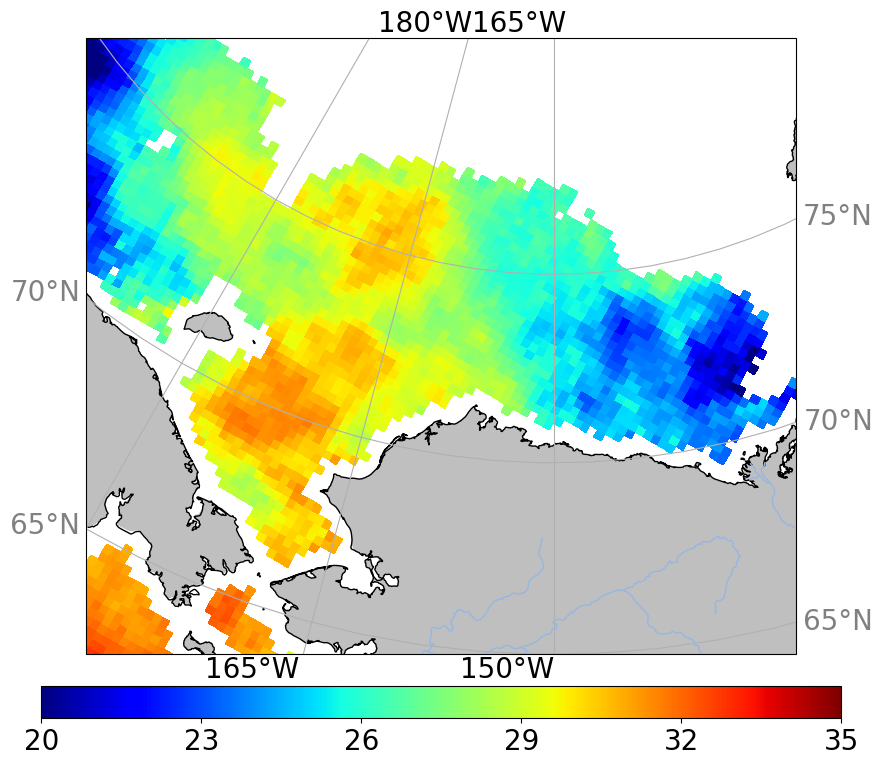

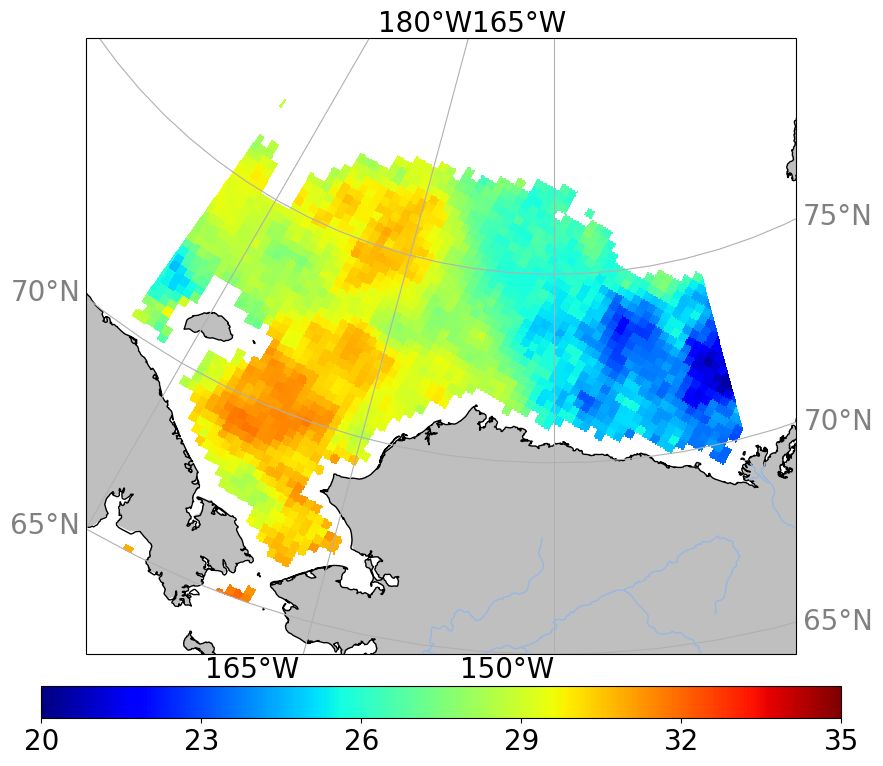

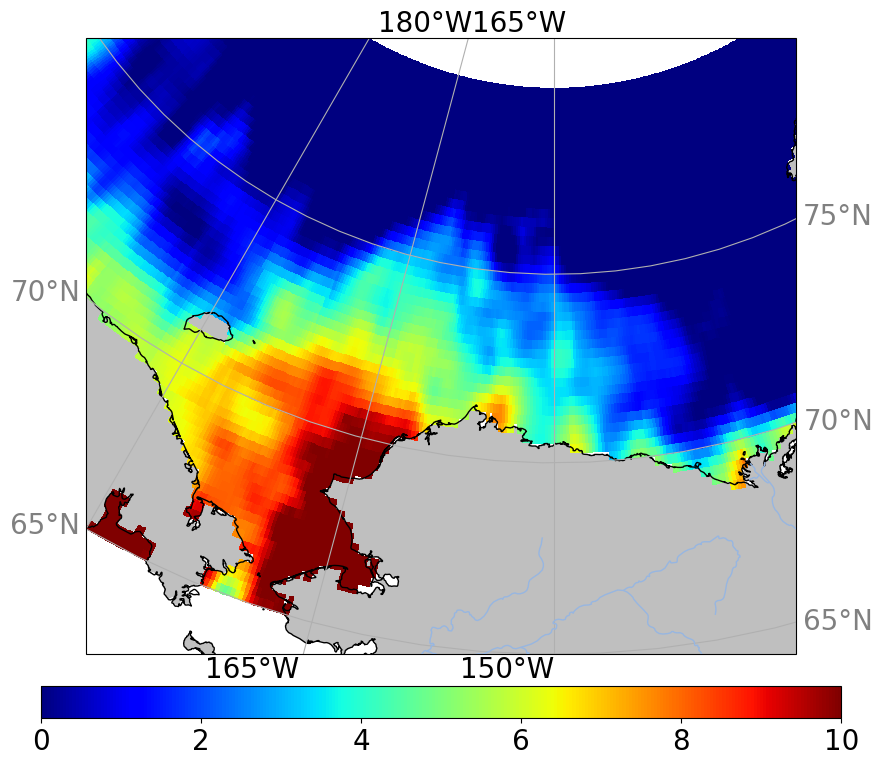

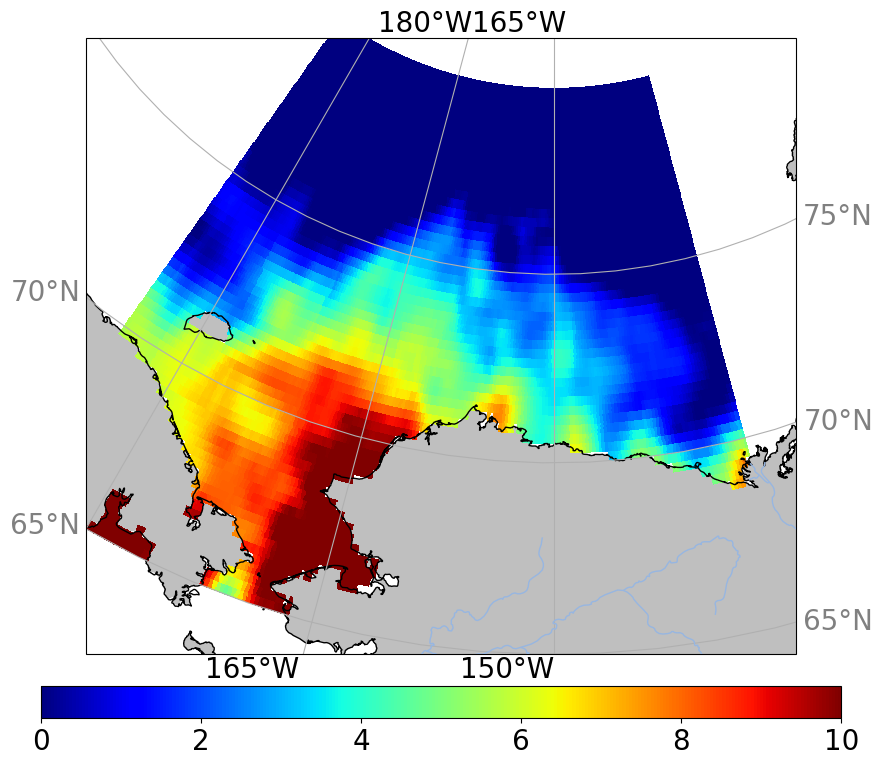

In [55]:
i=0
tmp=np.array(smos.SSS[i,:,:].squeeze().data)

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(smos.lon[0,:,:],smos.lat[0,:,:],tmp,cmap=palette,vmin=20,vmax=35,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(longrid,latgrid,smos_regrid[:,:,i],cmap=palette,vmin=20,vmax=35,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)


tmp=np.array(oisst.sst[:,:,i].squeeze().data)

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(oisst.lon,oisst.lat,tmp,cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(longrid,latgrid,oisst_regrid[:,:,i],cmap=palette,vmin=0,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

## Freezing SST

In [56]:
import gsw
pressure=0
saturation_fraction=0
sst_freezing_regrid = gsw.t_freezing(smos_regrid,pressure,saturation_fraction)
sst_freezing_regrid.shape

(300, 1003, 122)

In [57]:
ano_sst_regrid=oisst_regrid - sst_freezing_regrid
ano_sst_regrid.shape

(300, 1003, 122)

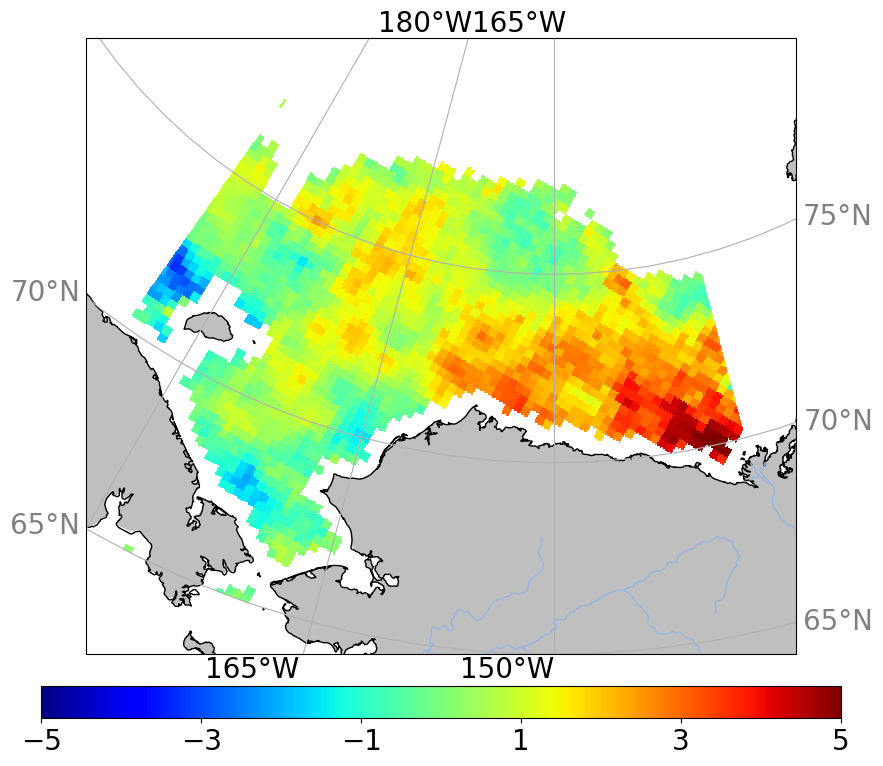

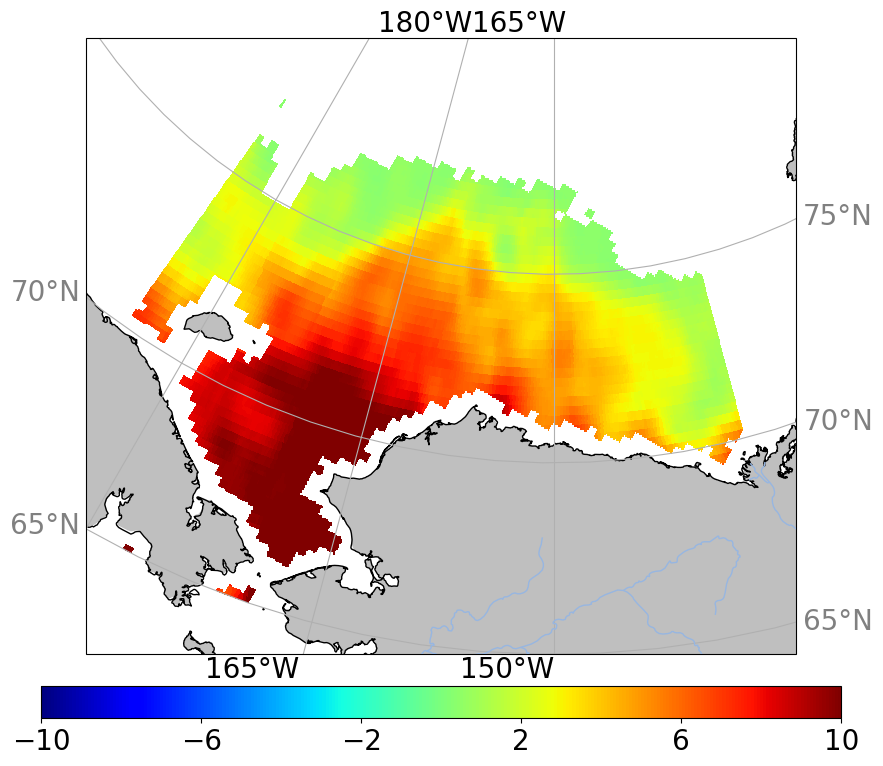

In [58]:
i=0
fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(longrid,latgrid,ano_sss_regrid[:,:,i],cmap=palette,vmin=-5,vmax=5,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

fig = plt.figure(figsize=(10,8))
ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
ax.coastlines('10m',zorder=2)
ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
gl.xformatter = LONGITUDE_FORMATTER
gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
gl.yformatter = LATITUDE_FORMATTER
gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
palette = plt.cm.jet
pp=ax.pcolormesh(longrid,latgrid,ano_sst_regrid[:,:,i],cmap=palette,vmin=-10,vmax=10,transform=cartopy.crs.PlateCarree())
cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)

## SST and SSS before ice

In [59]:
sal_beforefirstfreeze=np.empty(([nws.sic[:,:,0].shape[0],nws.sic[:,:,0].shape[1],30]))
sal_beforefirstfreeze[:]=np.nan    
temp_beforefirstfreeze=np.empty(([nws.sic[:,:,0].shape[0],nws.sic[:,:,0].shape[1],30]))
temp_beforefirstfreeze[:]=np.nan  

for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        if np.isfinite(doy_freeze_first[i,j]):
            for k in range(0,30):
                sal_beforefirstfreeze[i,j,k]=smos_regrid[i,j,int(doy_freeze_first[i,j]-date.dayofyear[0]-k-1)]
                temp_beforefirstfreeze[i,j,k]=oisst_regrid[i,j,int(doy_freeze_first[i,j]-date.dayofyear[0]-k-1)]

In [60]:
sal_beforelastfreeze=np.empty(([nws.sic[:,:,0].shape[0],nws.sic[:,:,0].shape[1],30]))
sal_beforelastfreeze[:]=np.nan    
temp_beforelastfreeze=np.empty(([nws.sic[:,:,0].shape[0],nws.sic[:,:,0].shape[1],30]))
temp_beforelastfreeze[:]=np.nan  

for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        if np.isfinite(doy_open_last[i,j]) and doy_open_last[i,j]<365:
            for k in range(0,30):
                sal_beforelastfreeze[i,j,k]=smos_regrid[i,j,int(doy_open_last[i,j]-date.dayofyear[0]-k)]
                temp_beforelastfreeze[i,j,k]=oisst_regrid[i,j,int(doy_open_last[i,j]-date.dayofyear[0]-k)]

In [61]:
ano_sal_beforefirstfreeze=np.empty(([nws.sic[:,:,0].shape[0],nws.sic[:,:,0].shape[1],30]))
ano_sal_beforefirstfreeze[:]=np.nan    
ano_temp_beforefirstfreeze=np.empty(([nws.sic[:,:,0].shape[0],nws.sic[:,:,0].shape[1],30]))
ano_temp_beforefirstfreeze[:]=np.nan  

for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        if np.isfinite(doy_freeze_first[i,j]):
            for k in range(0,30):
                ano_sal_beforefirstfreeze[i,j,k]=ano_sss_regrid[i,j,int(doy_freeze_first[i,j]-date.dayofyear[0]-k-1)]
                ano_temp_beforefirstfreeze[i,j,k]=ano_sst_regrid[i,j,int(doy_freeze_first[i,j]-date.dayofyear[0]-k-1)]

In [62]:
ano_sal_beforelastfreeze=np.empty(([nws.sic[:,:,0].shape[0],nws.sic[:,:,0].shape[1],30]))
ano_sal_beforelastfreeze[:]=np.nan    
ano_temp_beforelastfreeze=np.empty(([nws.sic[:,:,0].shape[0],nws.sic[:,:,0].shape[1],30]))
ano_temp_beforelastfreeze[:]=np.nan  

for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        if np.isfinite(doy_open_last[i,j]) and doy_open_last[i,j]<365:
            for k in range(0,30):
                ano_sal_beforelastfreeze[i,j,k]=ano_sss_regrid[i,j,int(doy_open_last[i,j]-date.dayofyear[0]-k)]
                ano_temp_beforelastfreeze[i,j,k]=ano_sst_regrid[i,j,int(doy_open_last[i,j]-date.dayofyear[0]-k)]

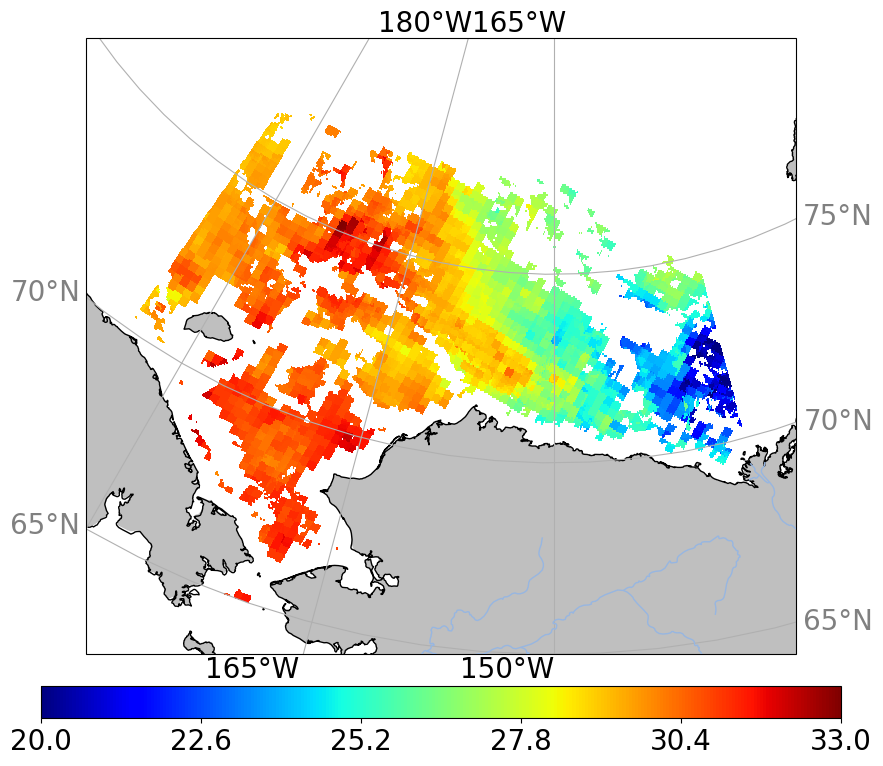

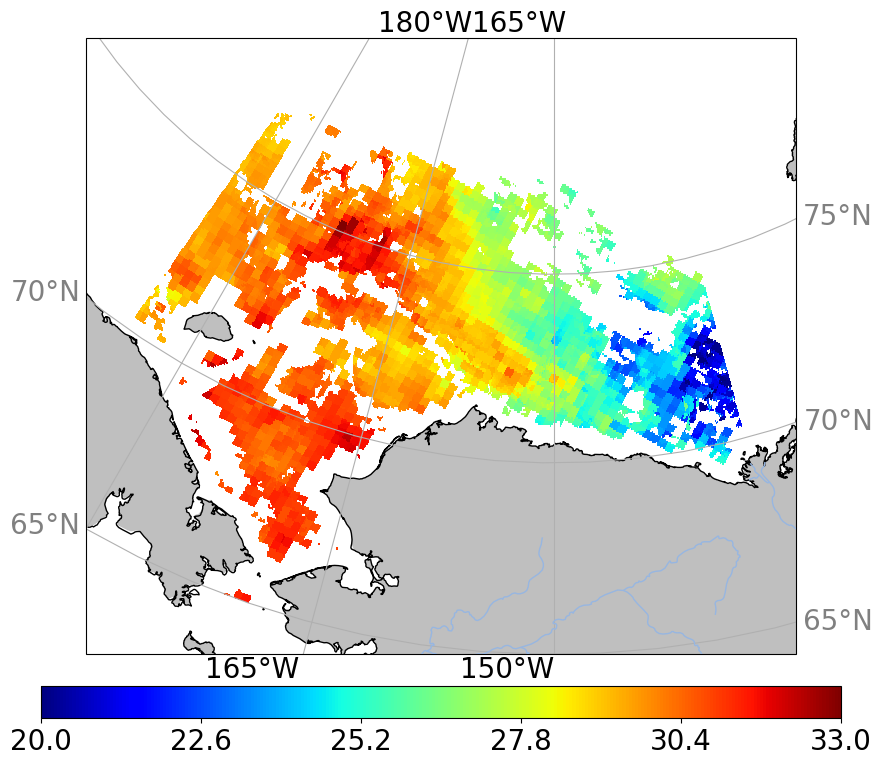

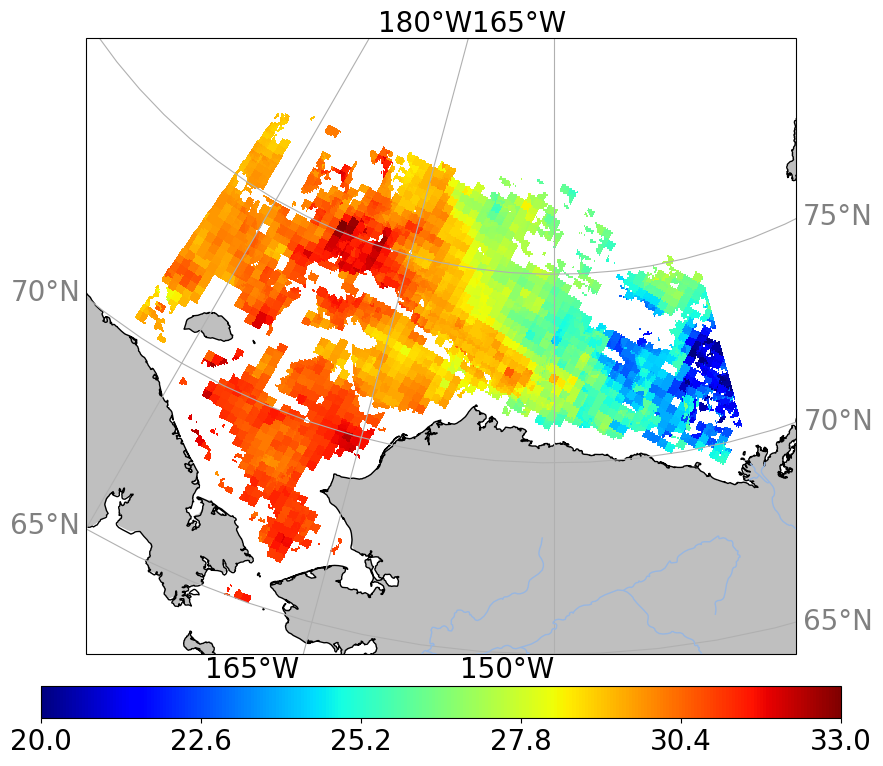

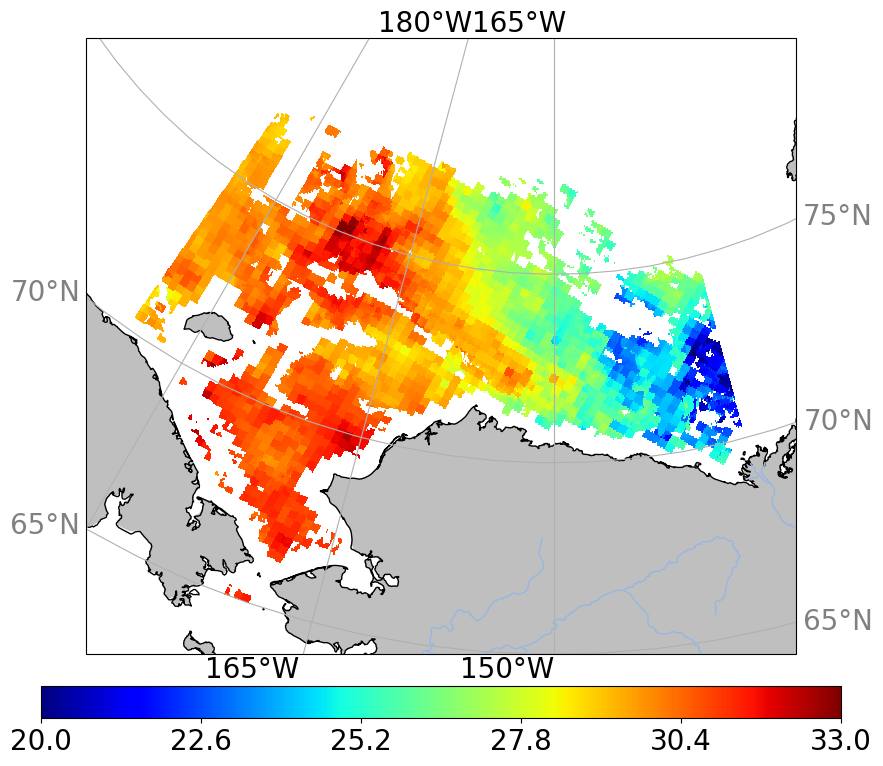

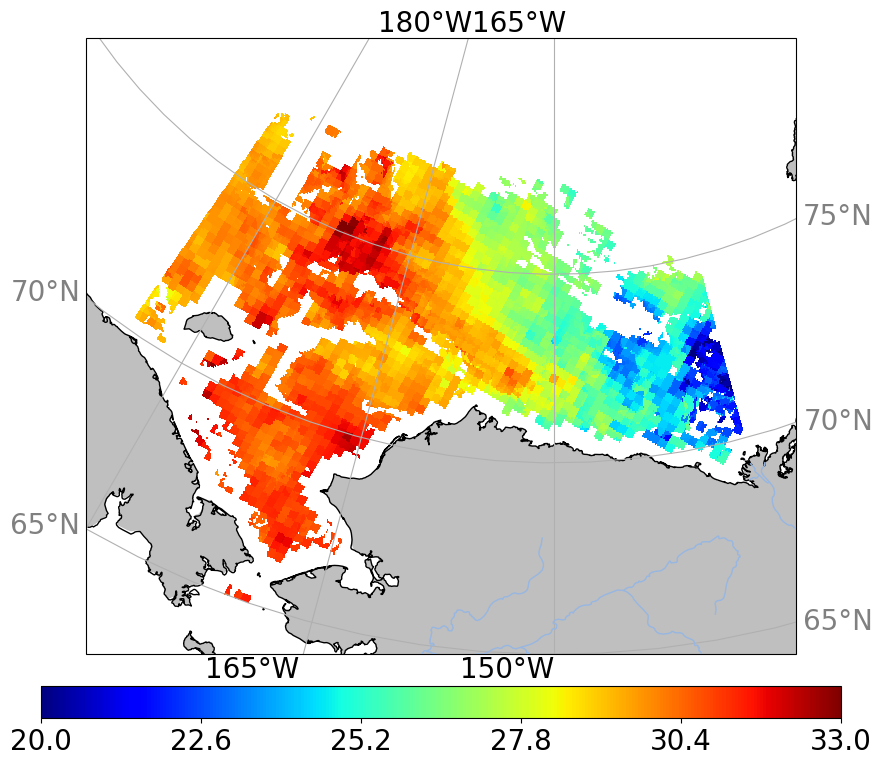

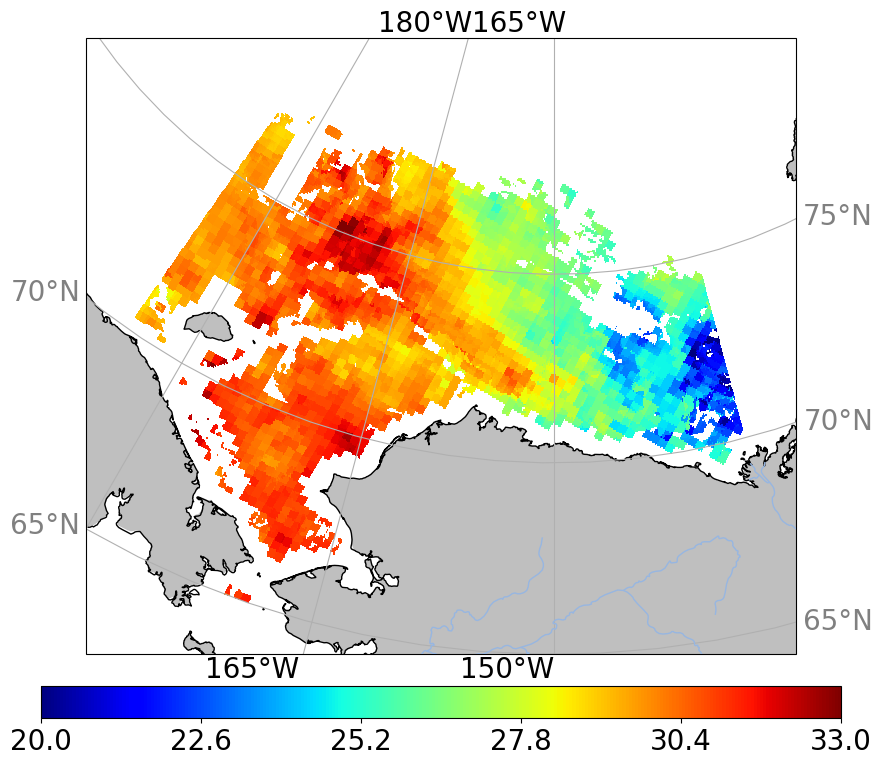

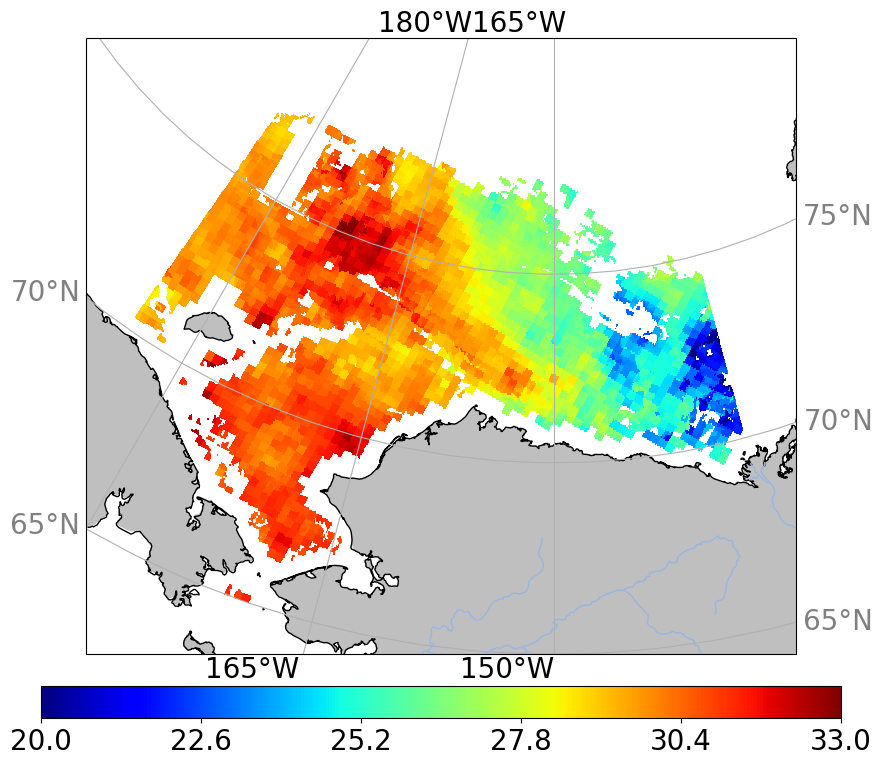

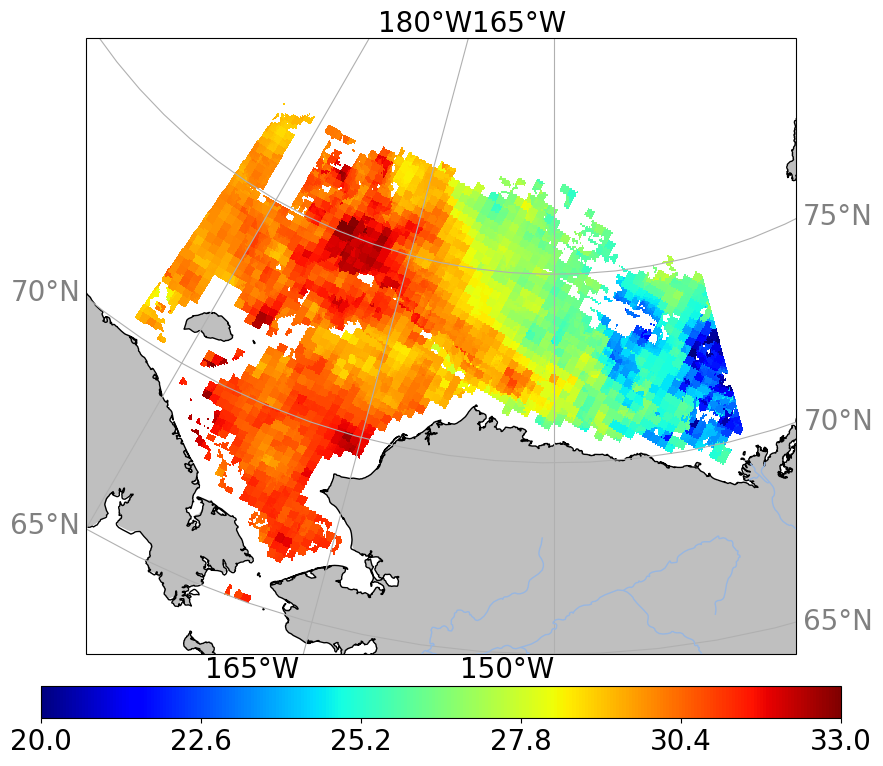

In [63]:
# Map of salinity one day to a week before the first freeze up in the fall:

for k in range(0,8):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(nws.lon,nws.lat,sal_beforefirstfreeze[:,:,k].squeeze(),cmap=palette,vmin=20,vmax=33,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
    fig_name='map_sal_beforefirstfreeze_'+str(year)+'_day-'+str(k+1)+'.png'
    #plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

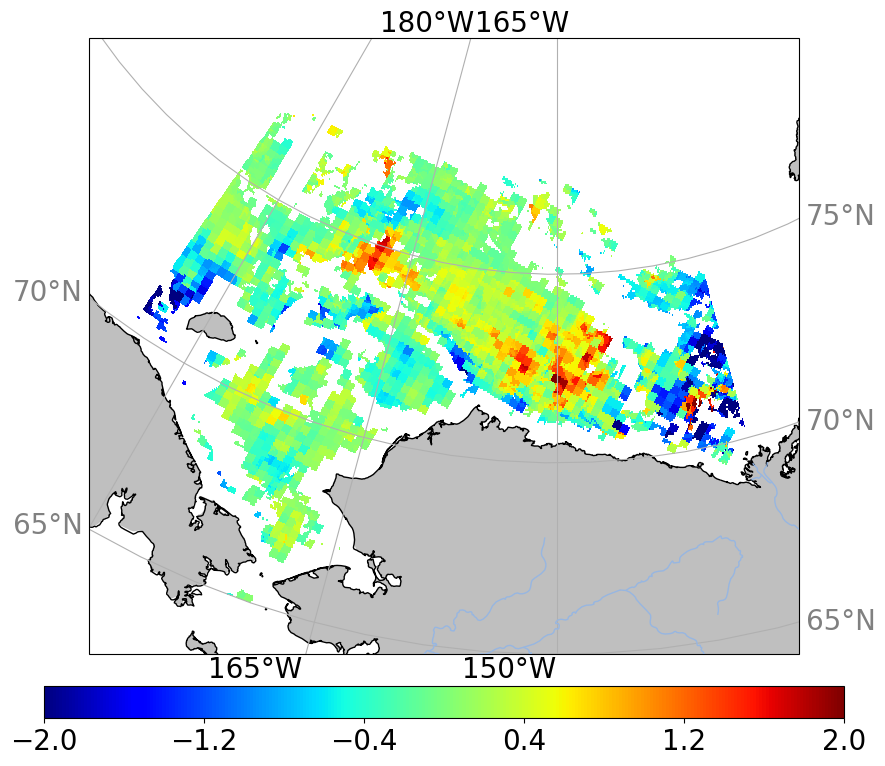

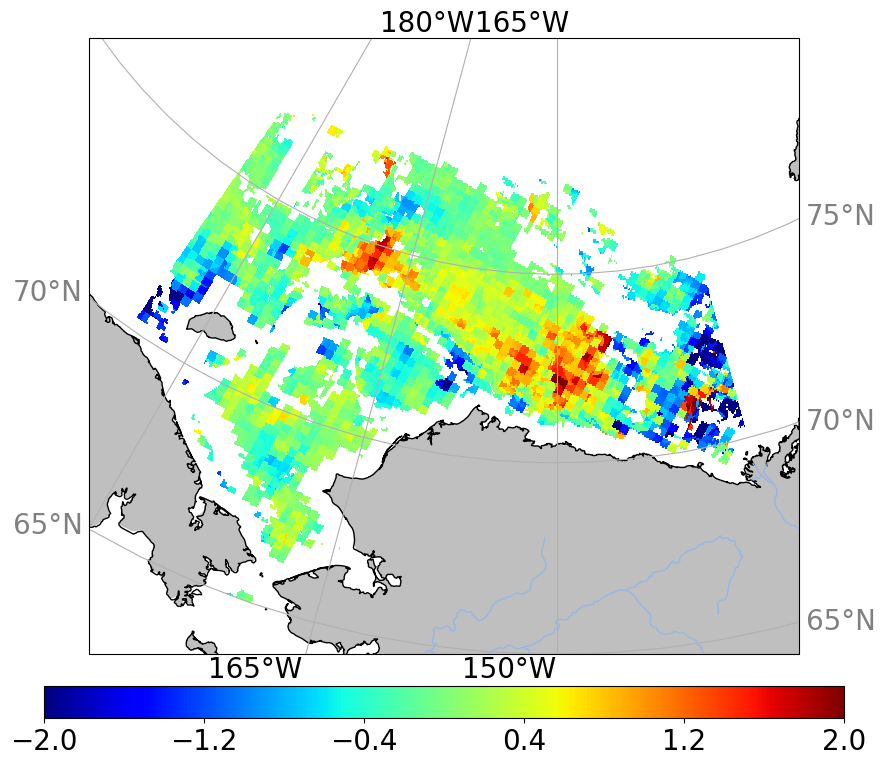

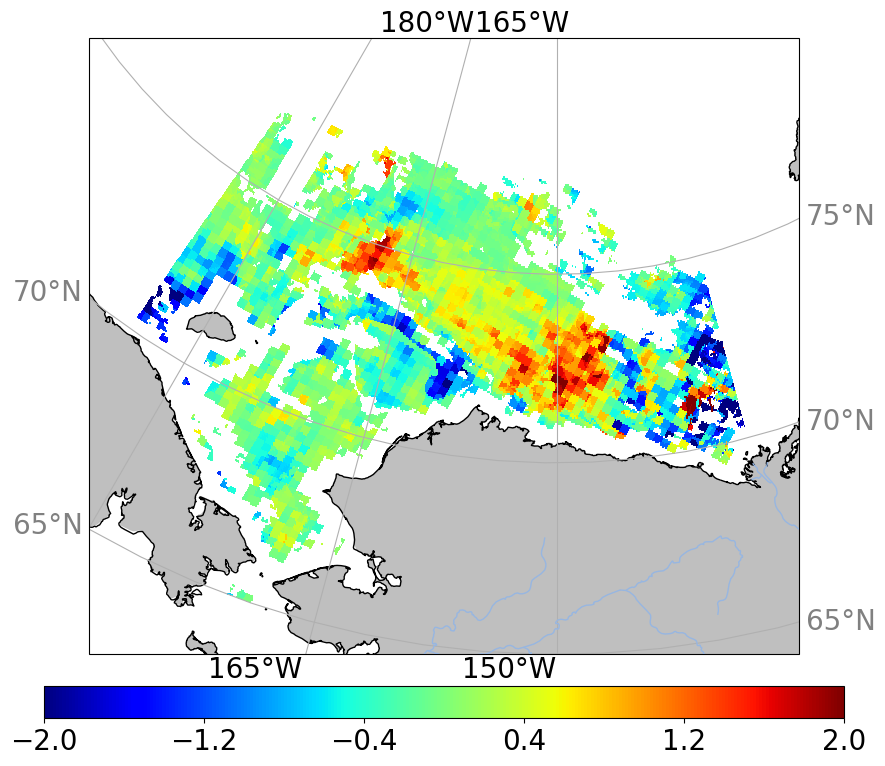

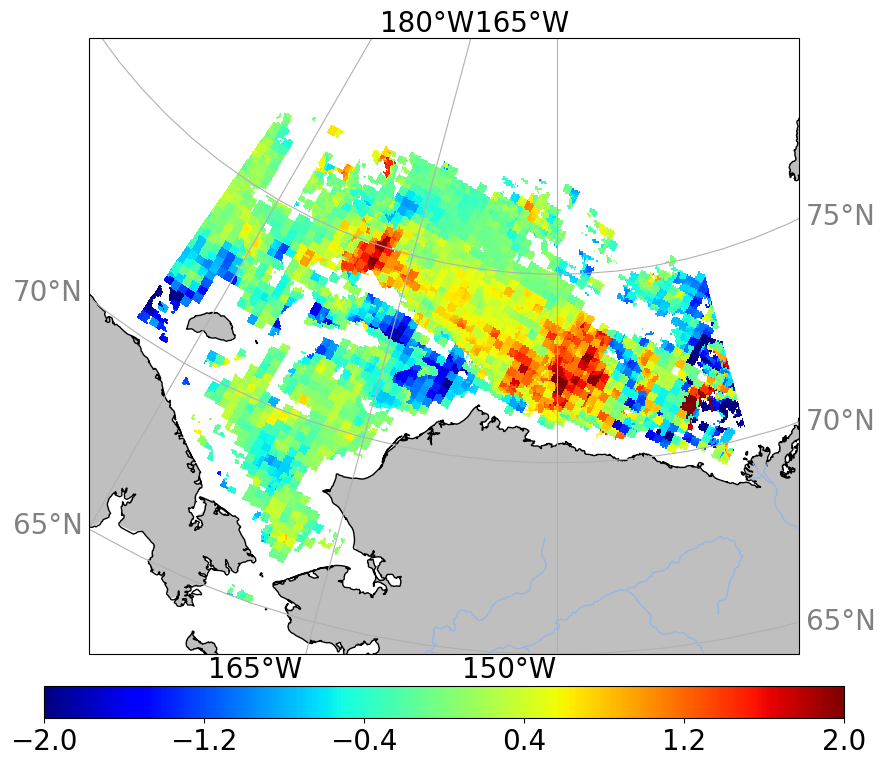

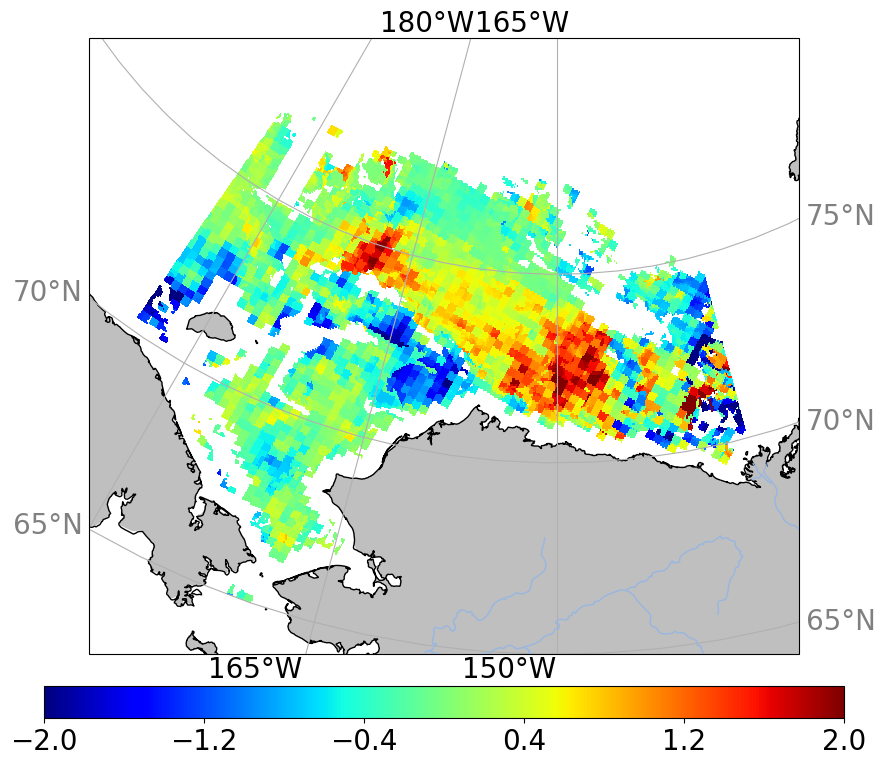

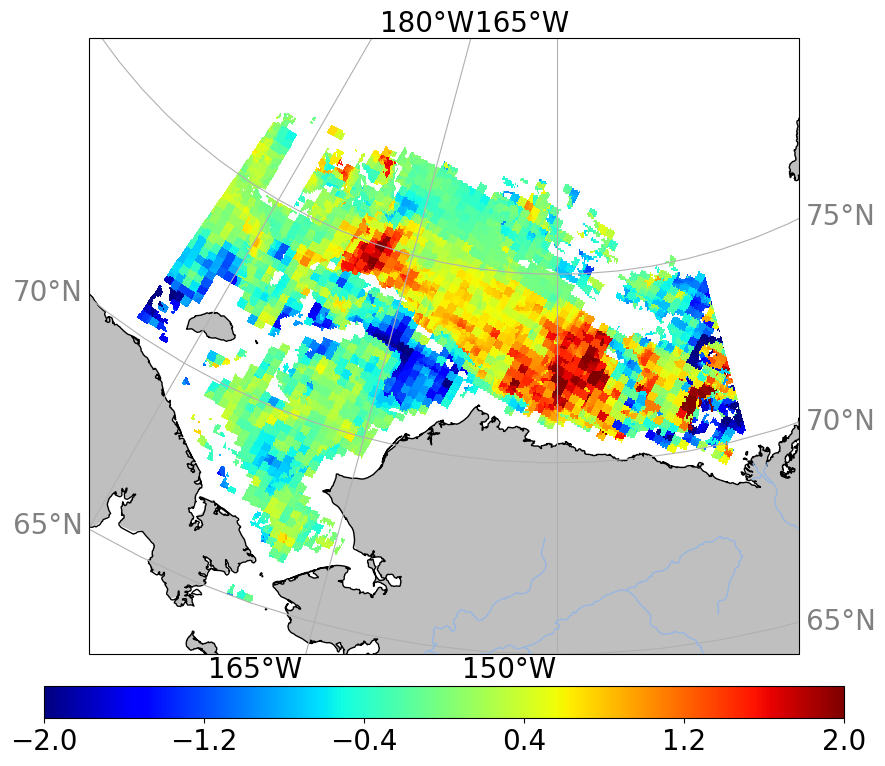

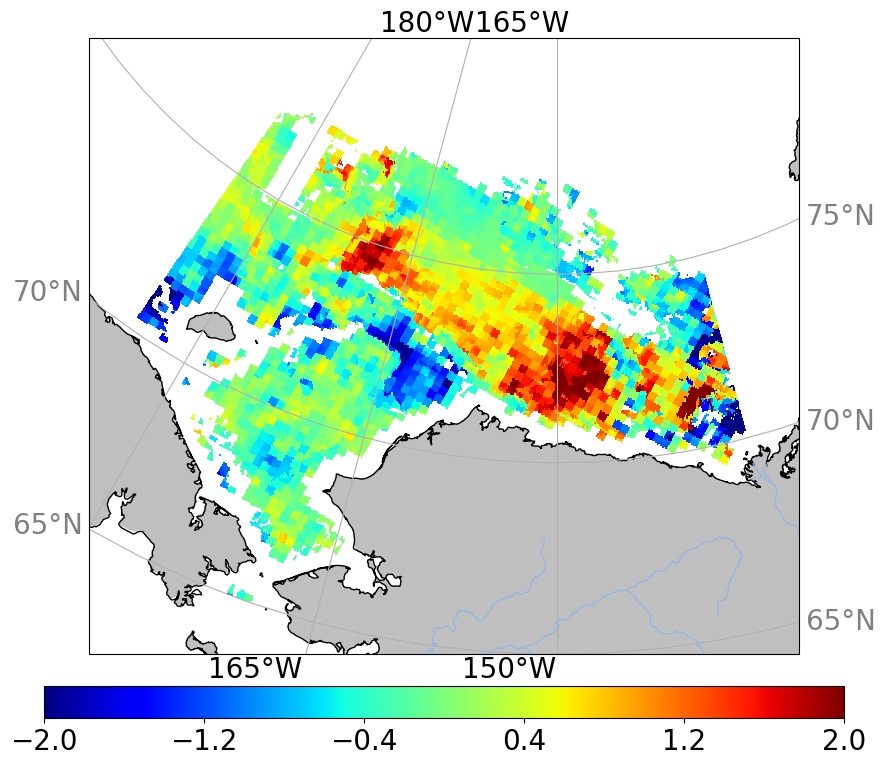

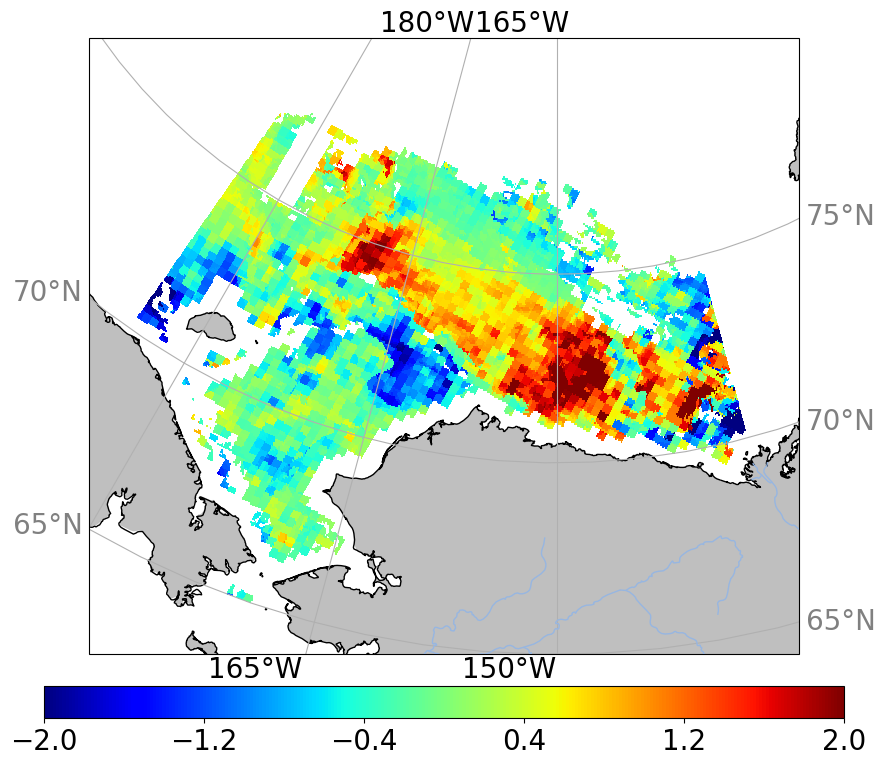

In [64]:
# Map of salinity anomalies one day to a week before the first freeze up in the fall:

for k in range(0,8):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(nws.lon,nws.lat,ano_sal_beforefirstfreeze[:,:,k].squeeze(),cmap=palette,vmin=-2,vmax=2,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
    fig_name='map_sal_beforefirstfreeze_'+str(year)+'_day-'+str(k+1)+'.png'
    #plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

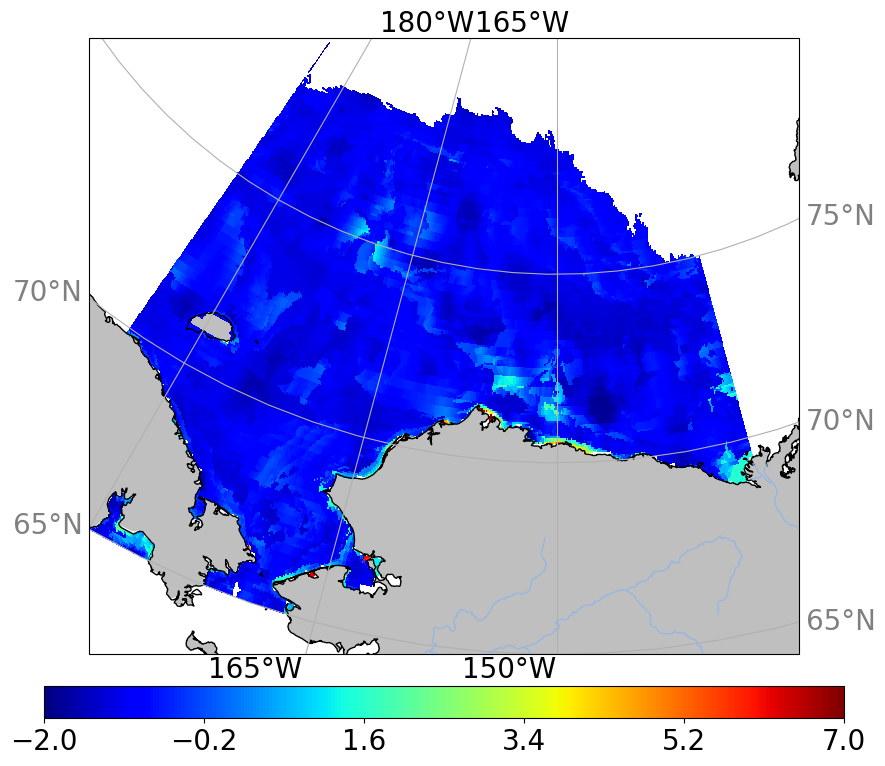

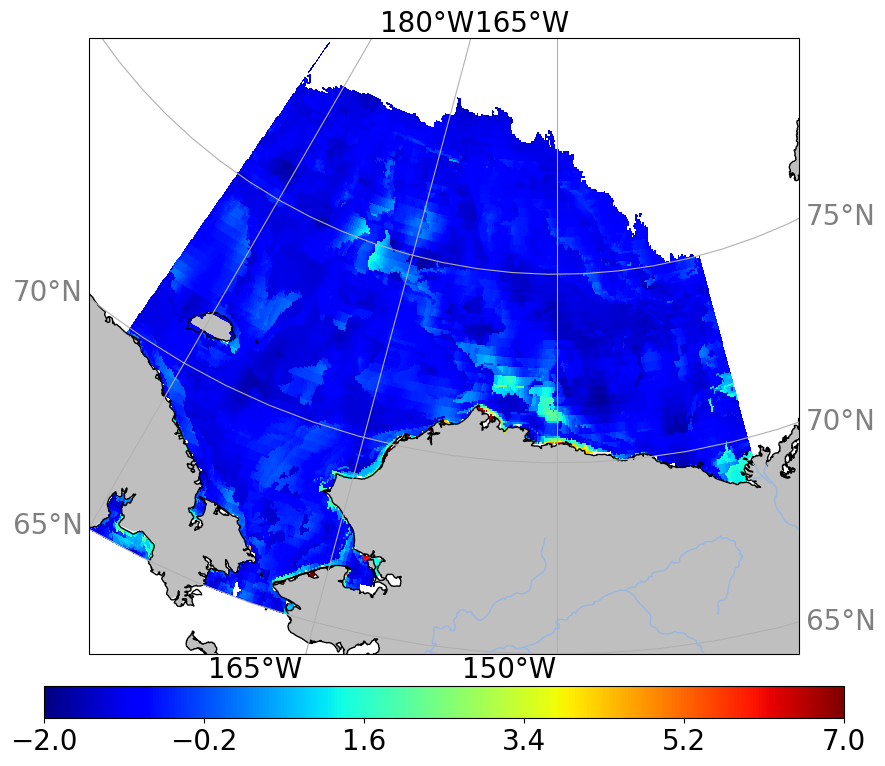

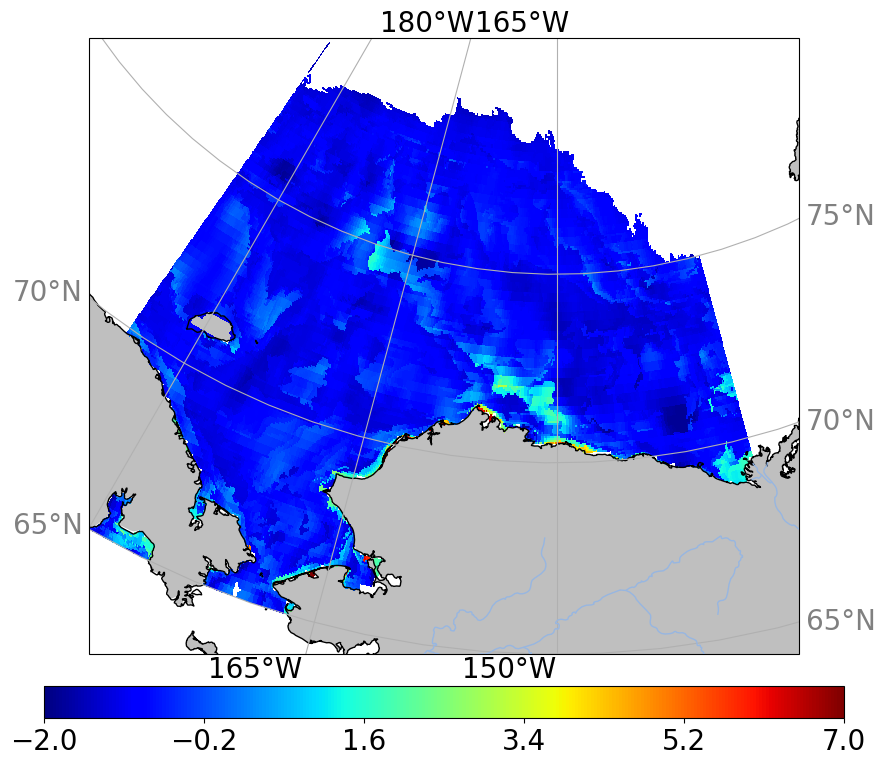

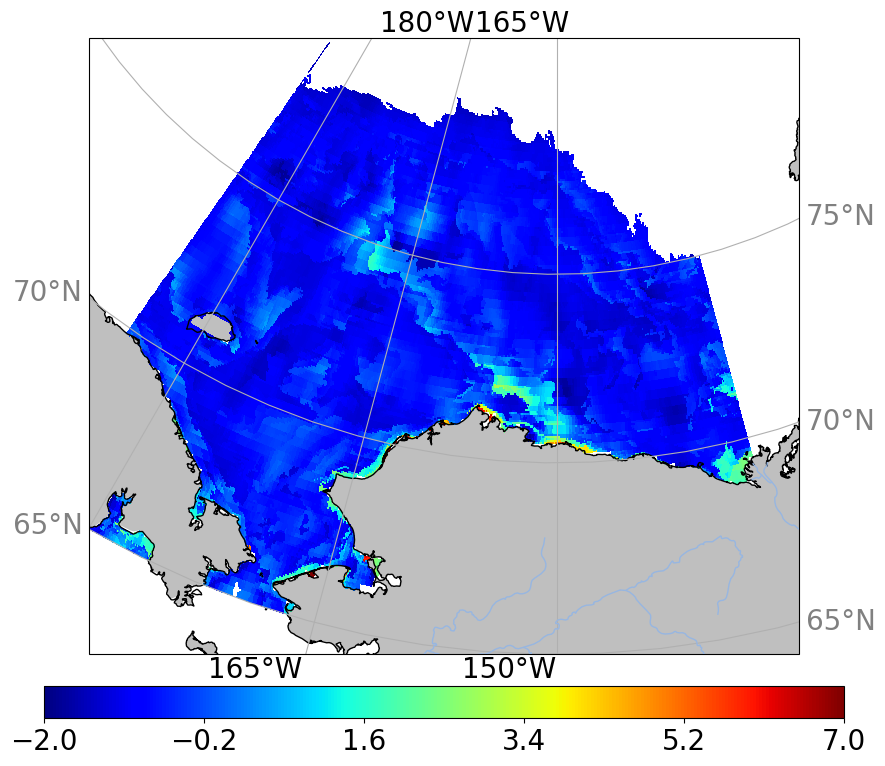

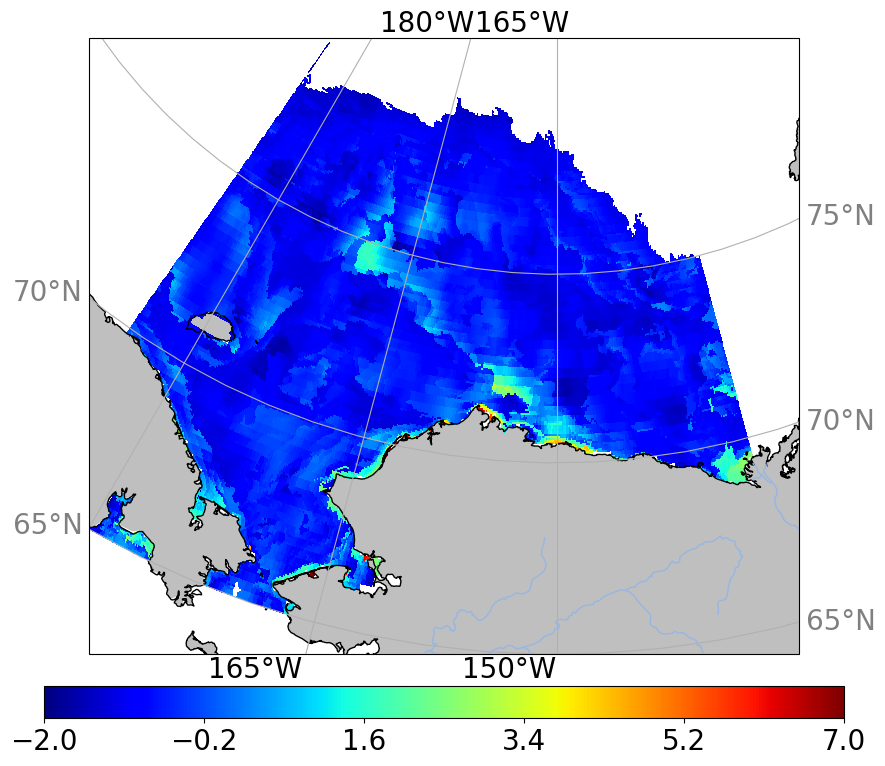

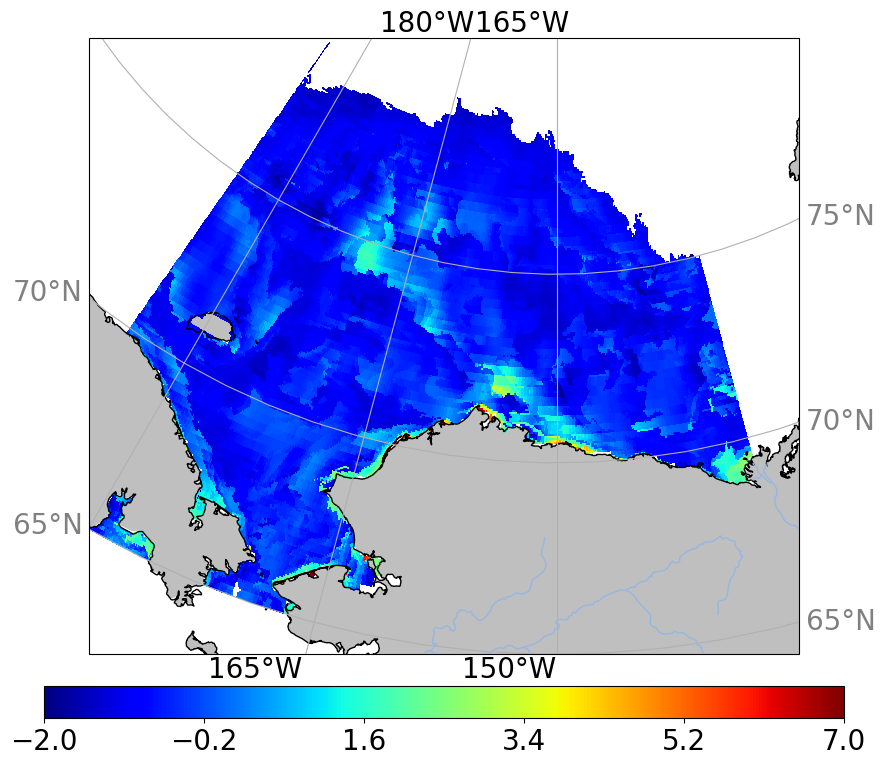

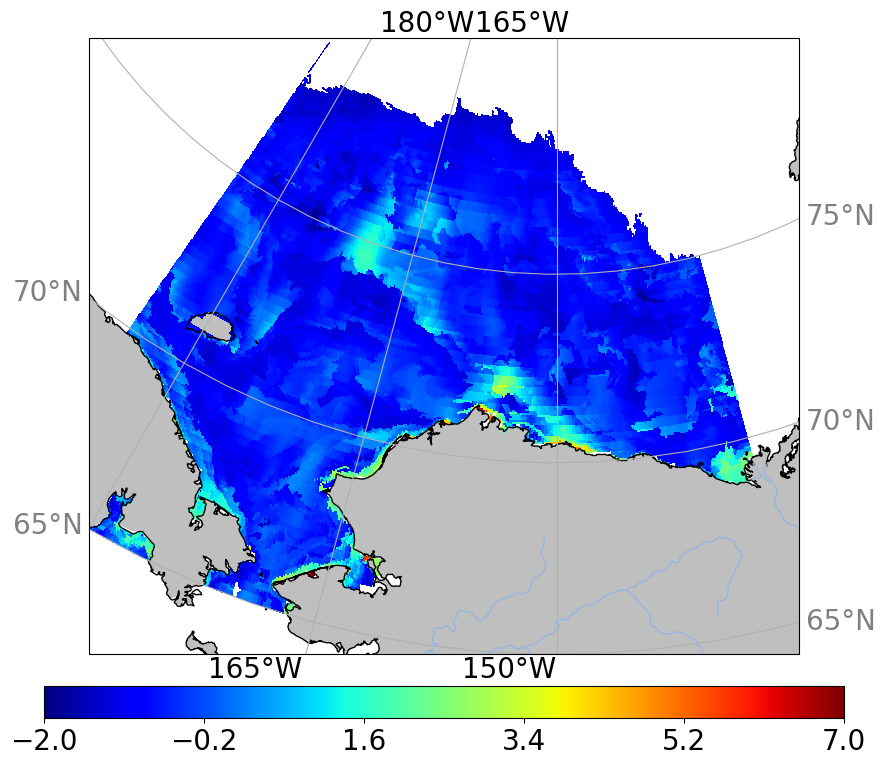

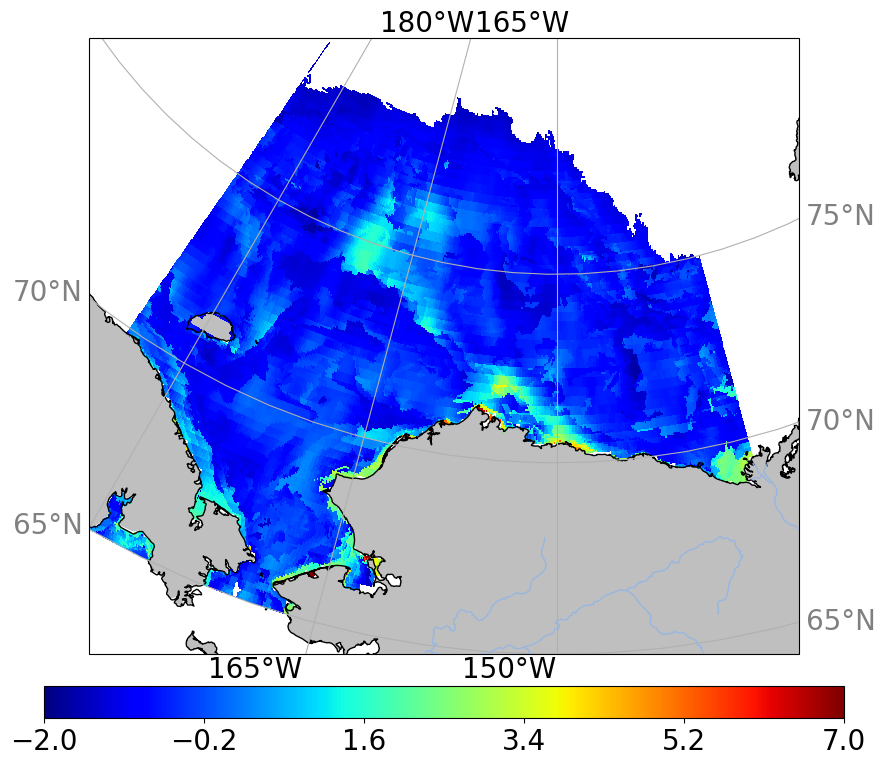

In [65]:
# Map of temperature one day to a week before the first freeze up in the fall:

for k in range(0,8):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(nws.lon,nws.lat,temp_beforefirstfreeze[:,:,k].squeeze(),cmap=palette,vmin=-2,vmax=7,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
    fig_name='map_temp_beforefirstfreeze_'+str(year)+'_day-'+str(k+1)+'.png'
    #plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

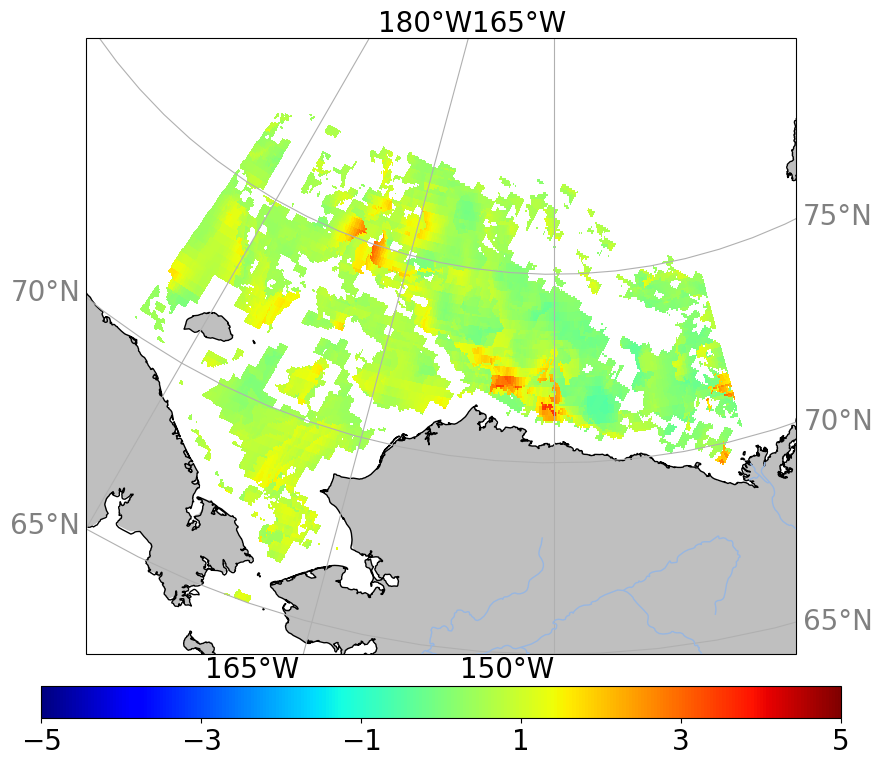

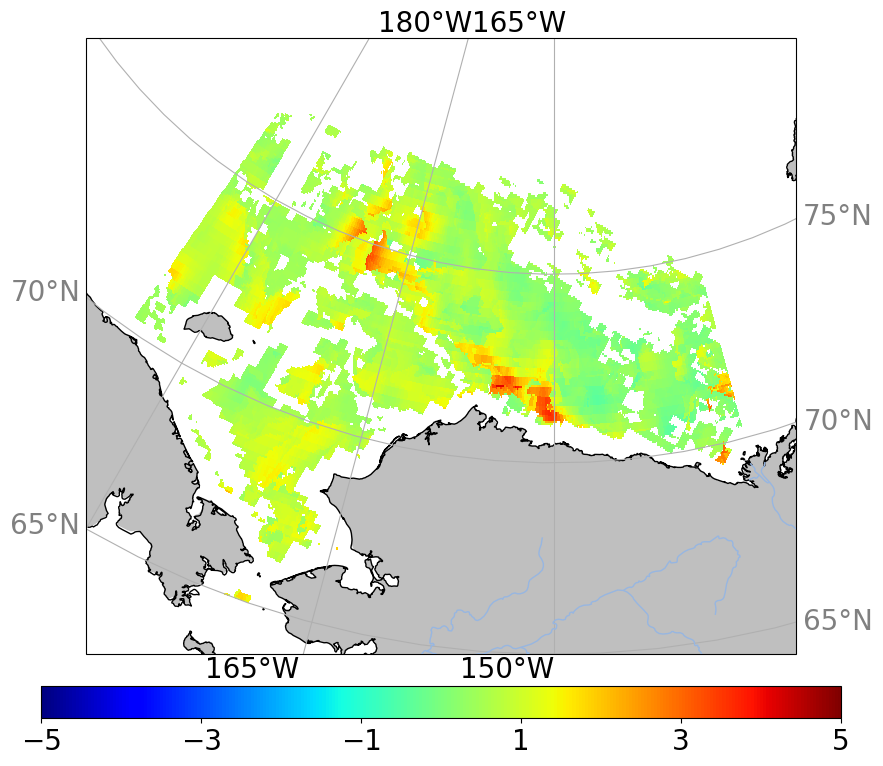

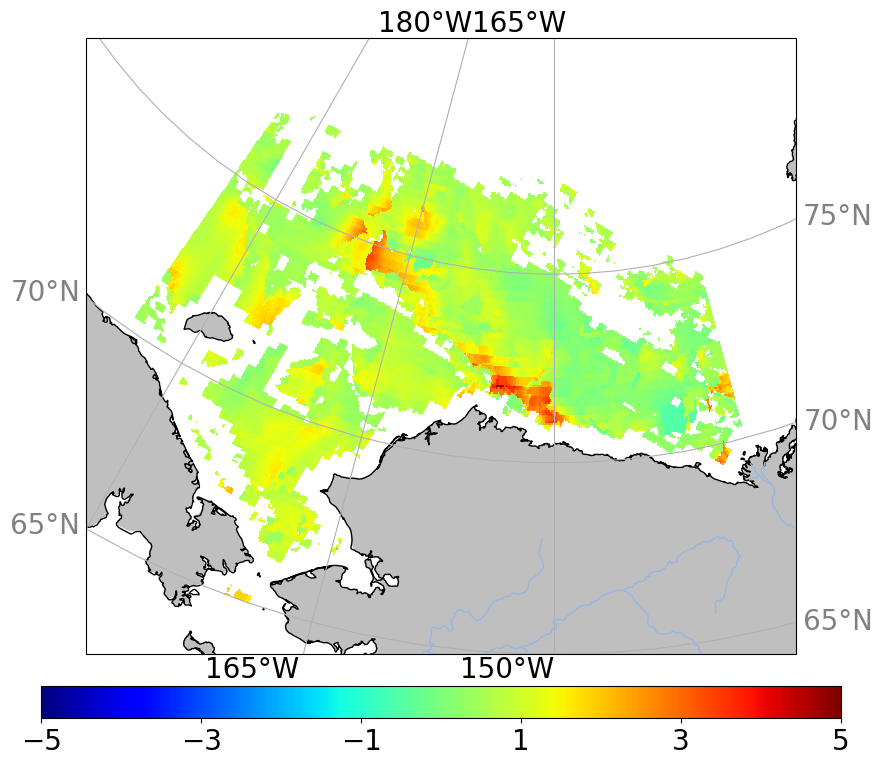

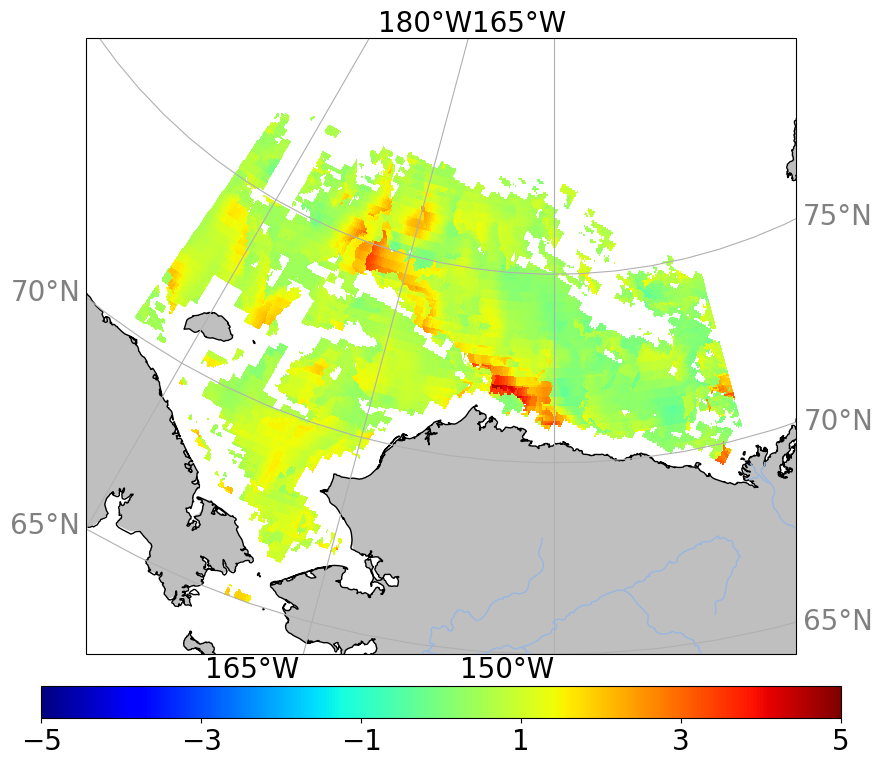

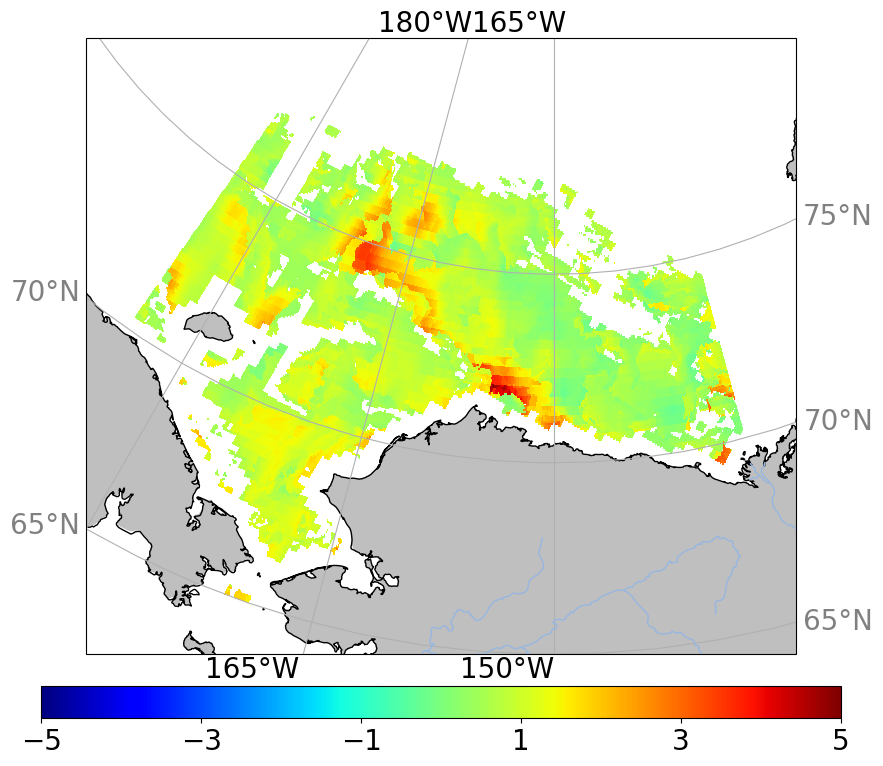

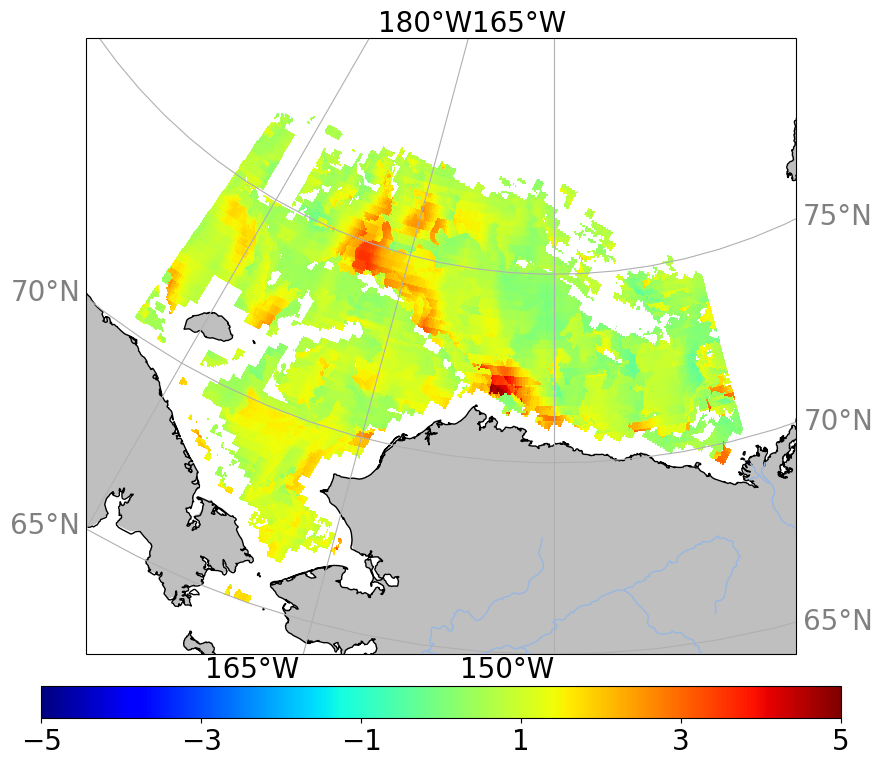

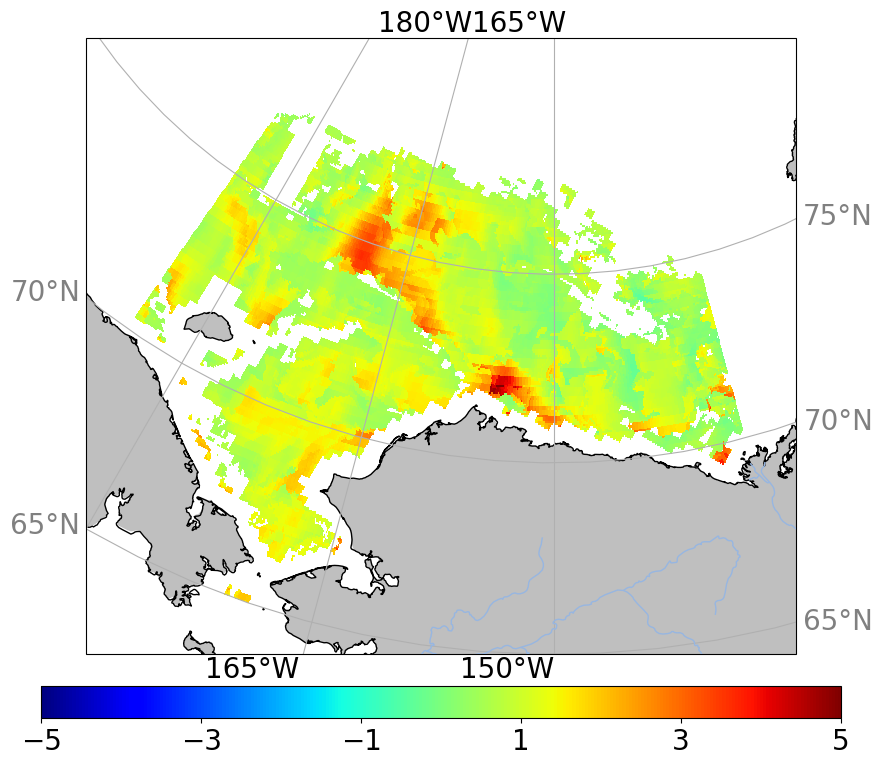

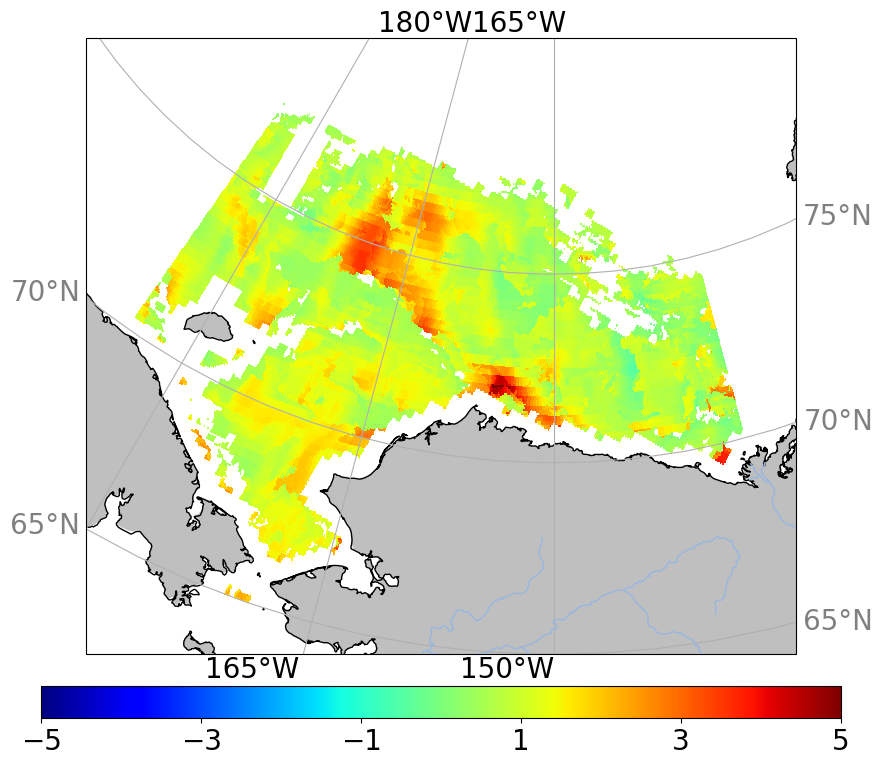

In [66]:
# Map of temperature anomalies one day to a week before the first freeze up in the fall:

for k in range(0,8):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(nws.lon,nws.lat,ano_temp_beforefirstfreeze[:,:,k].squeeze(),cmap=palette,vmin=-5,vmax=5,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
    fig_name='map_temp_beforefirstfreeze_'+str(year)+'_day-'+str(k+1)+'.png'
    #plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

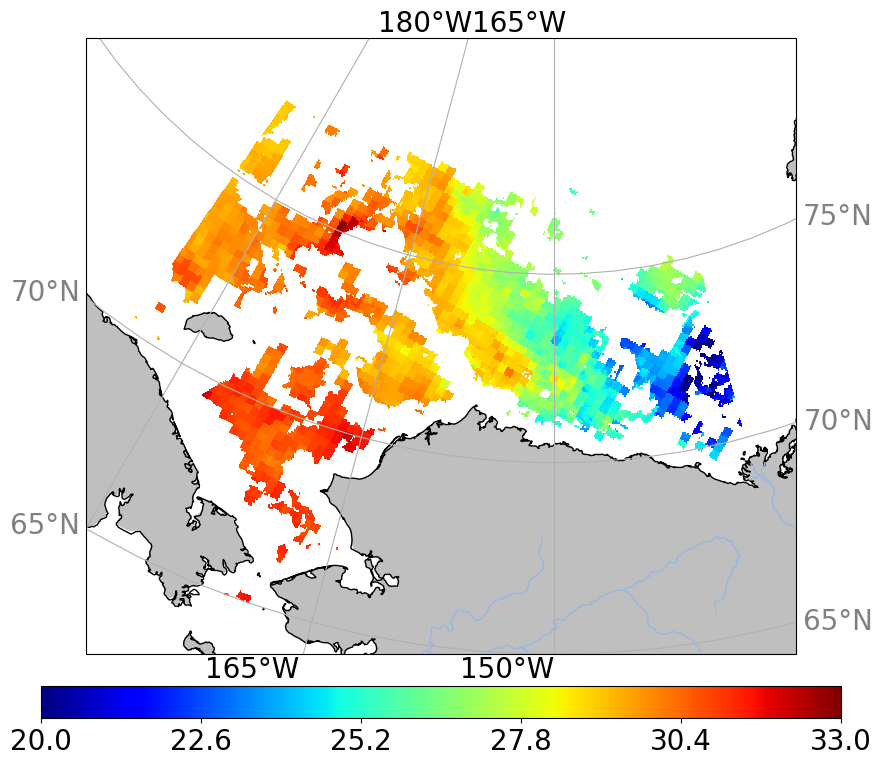

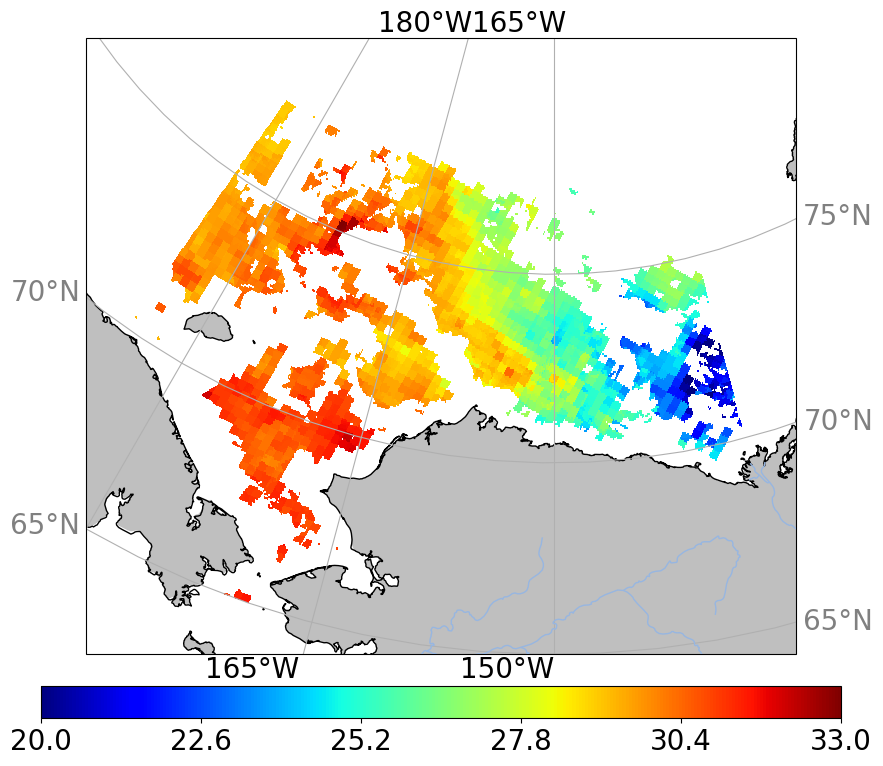

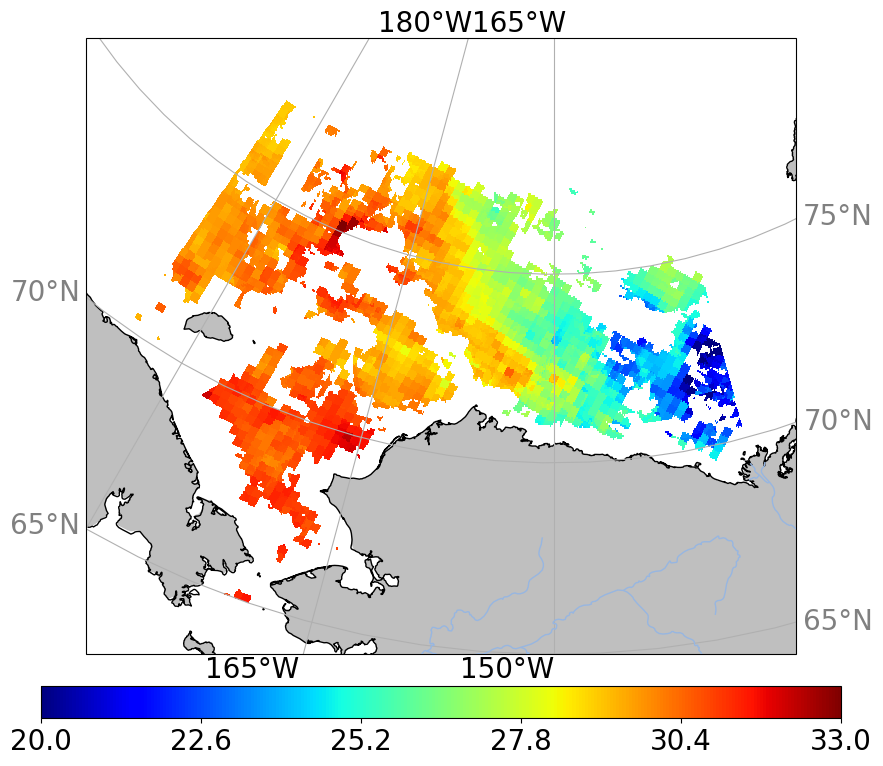

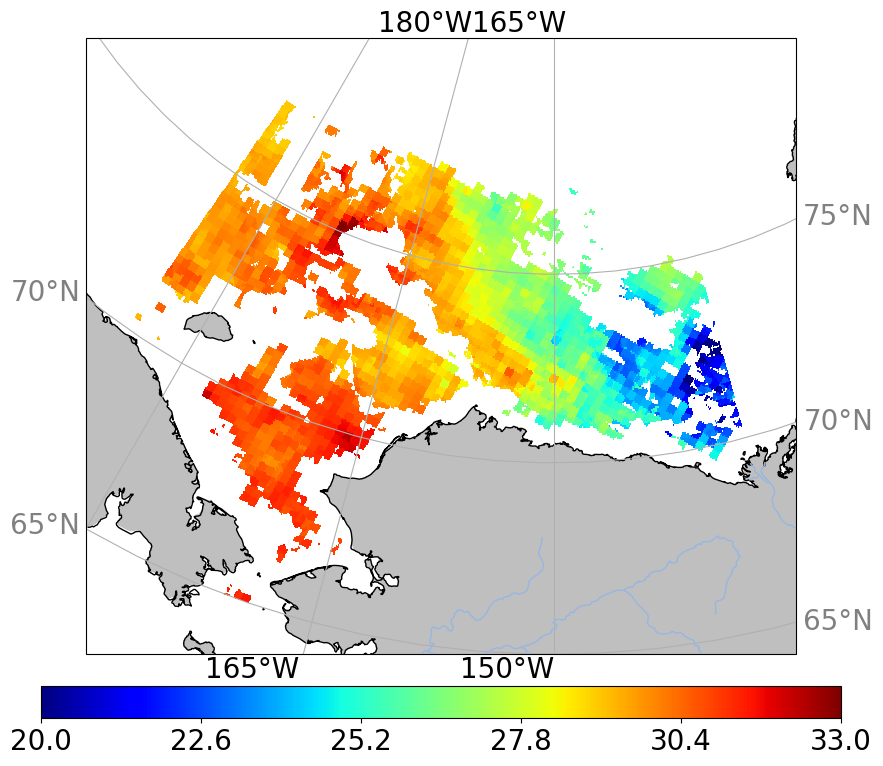

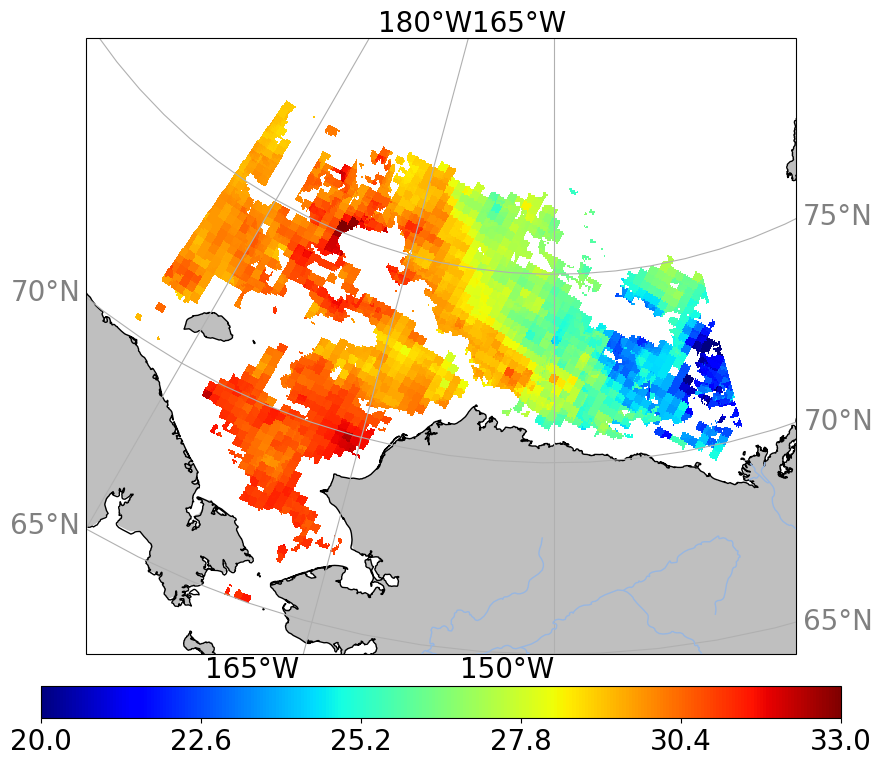

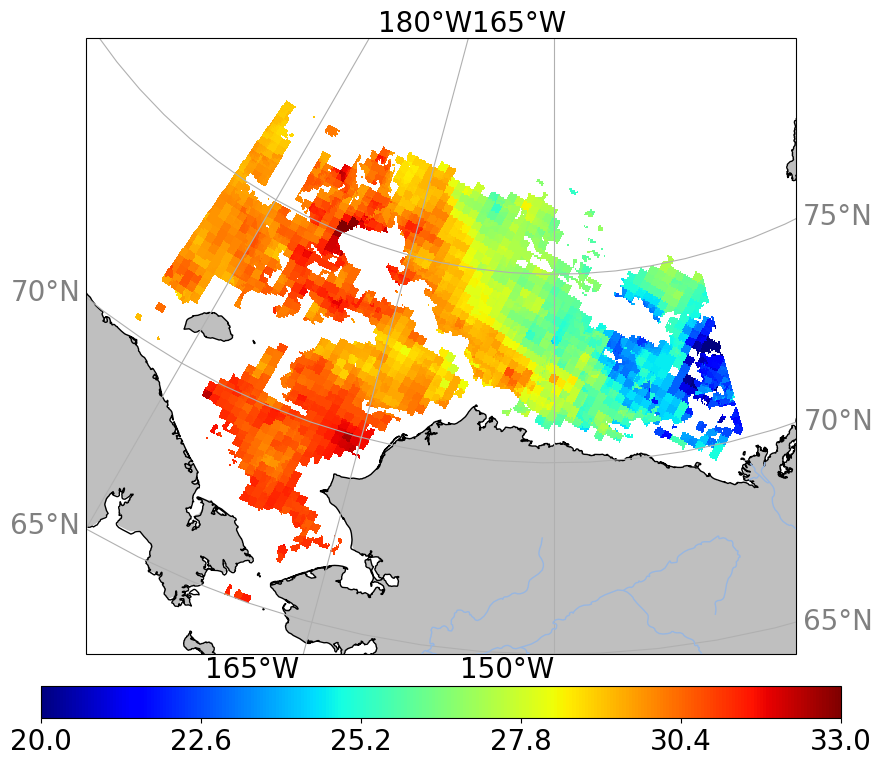

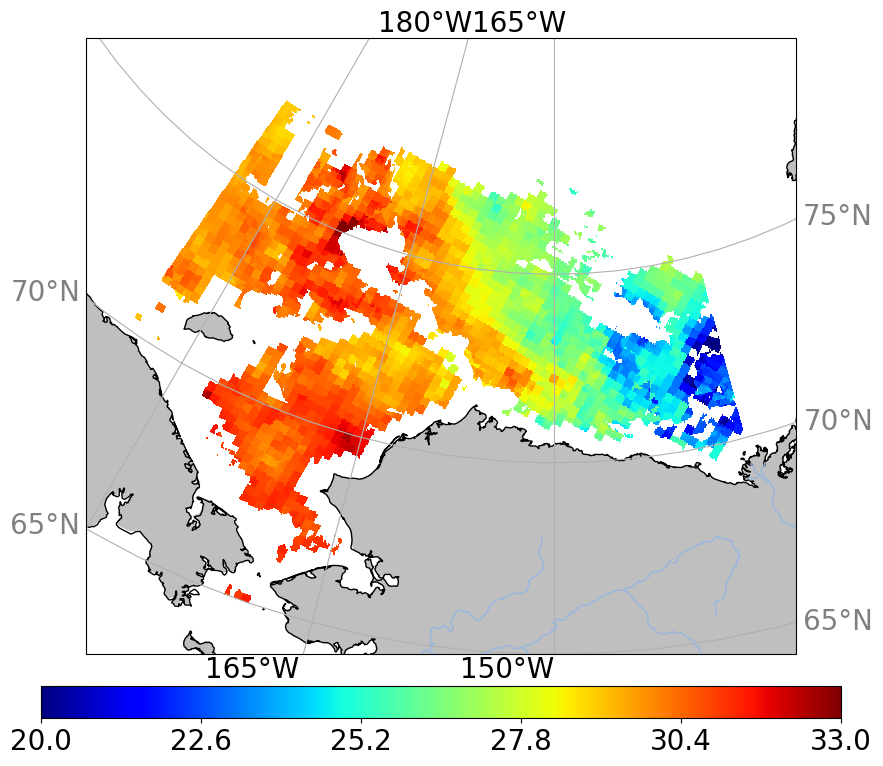

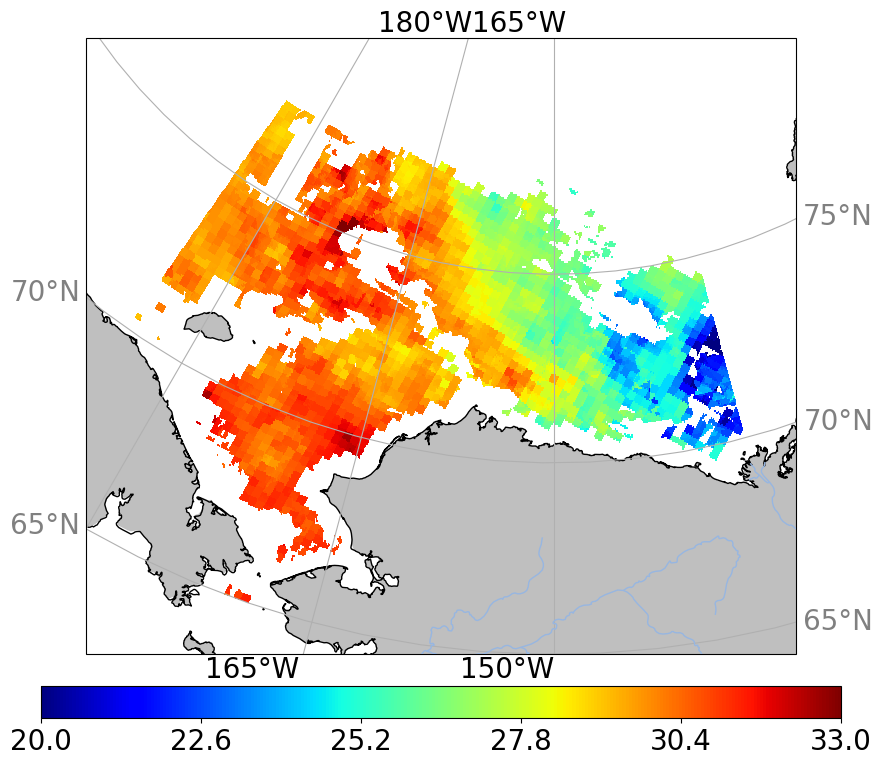

In [67]:
# Map of salinity one day to a week before the last freeze up in the fall:

for k in range(0,8):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(nws.lon,nws.lat,sal_beforelastfreeze[:,:,k].squeeze(),cmap=palette,vmin=20,vmax=33,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
    fig_name='map_sal_beforelastfreeze_'+str(year)+'_day-'+str(k+1)+'.png'
    #plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

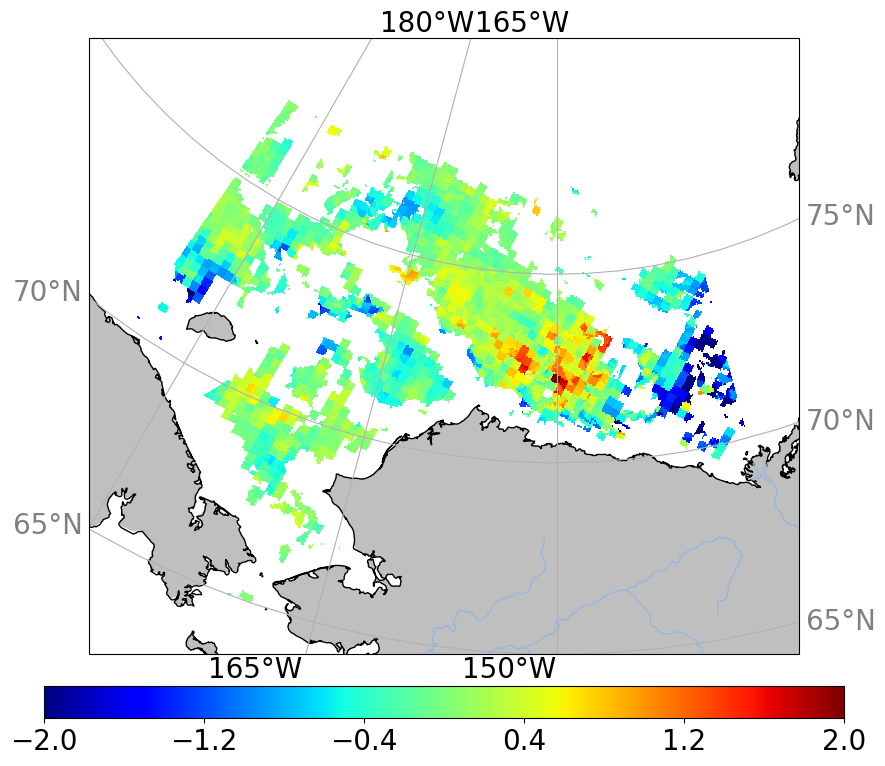

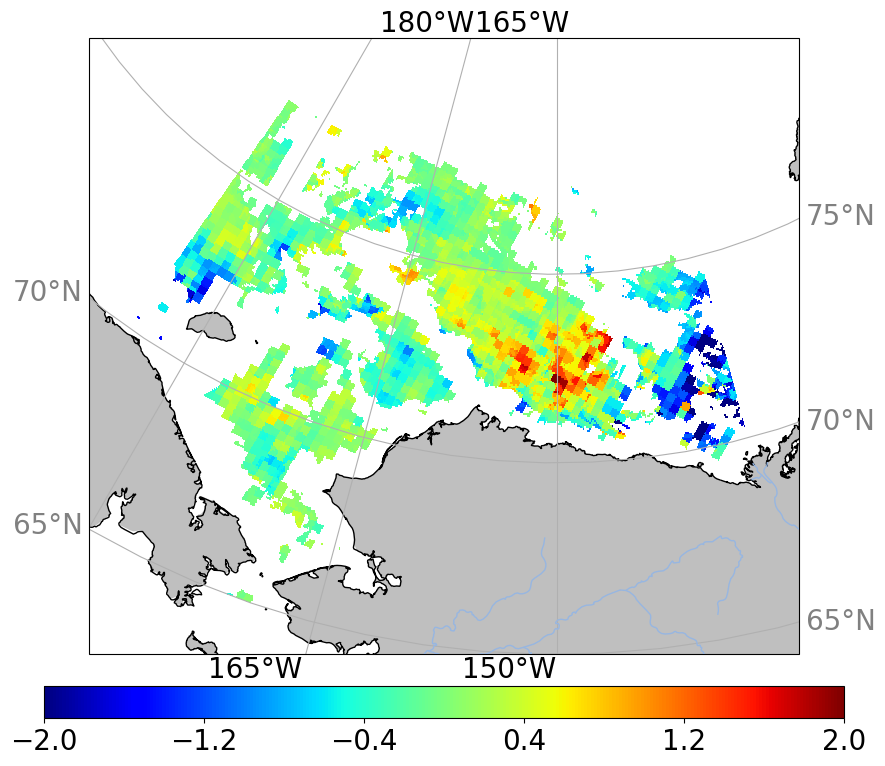

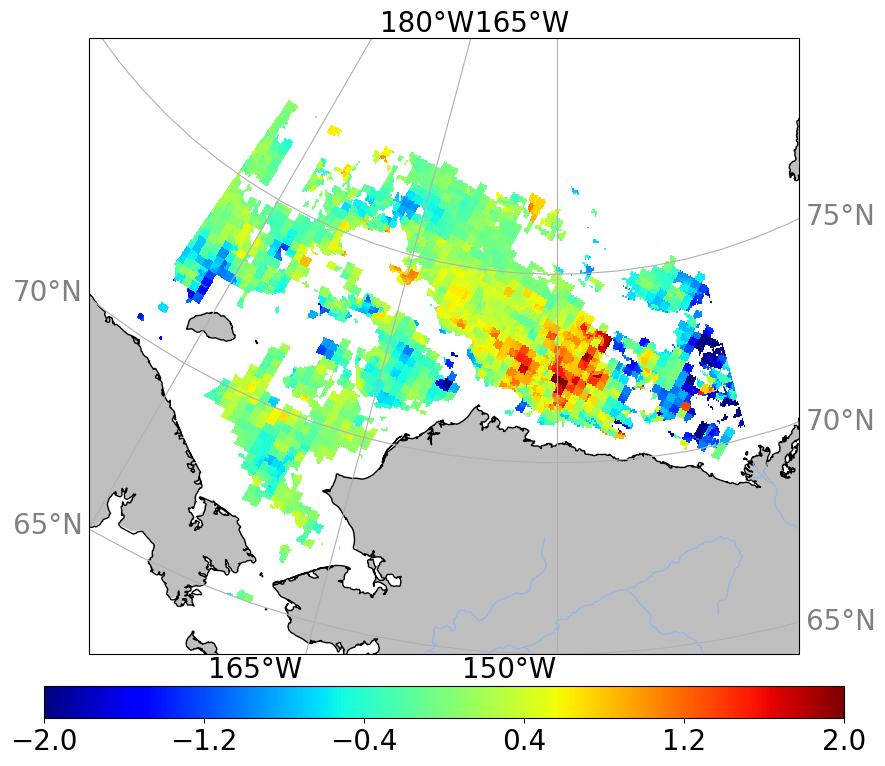

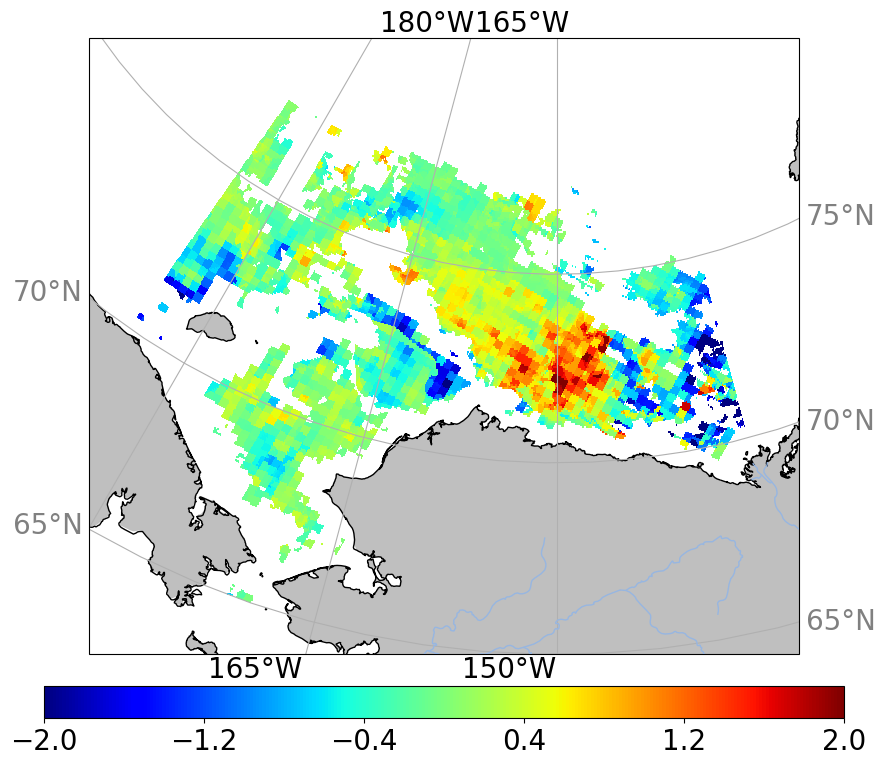

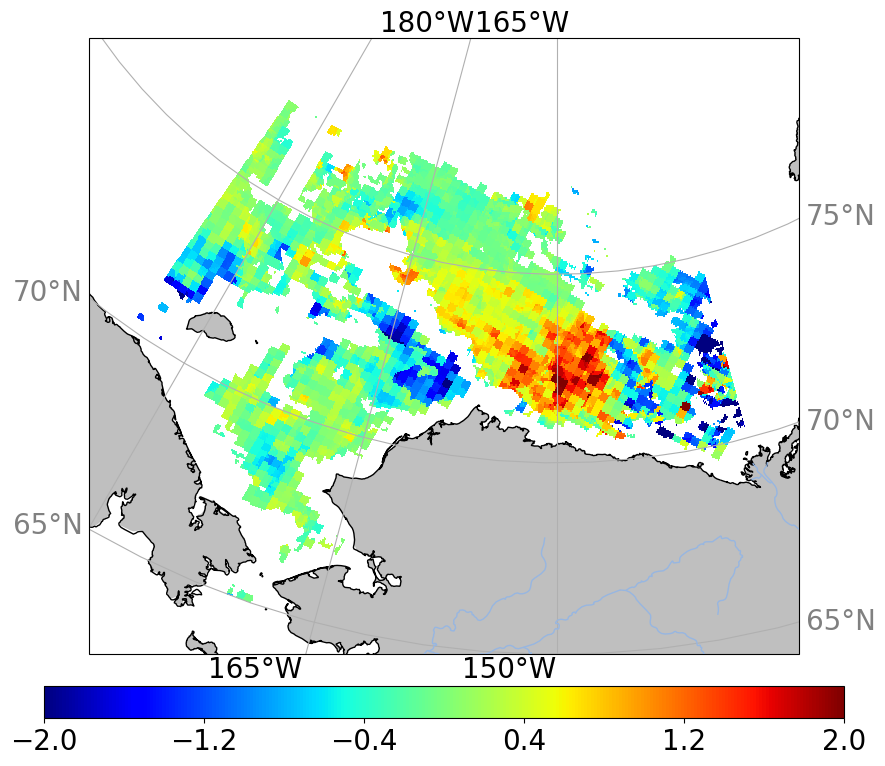

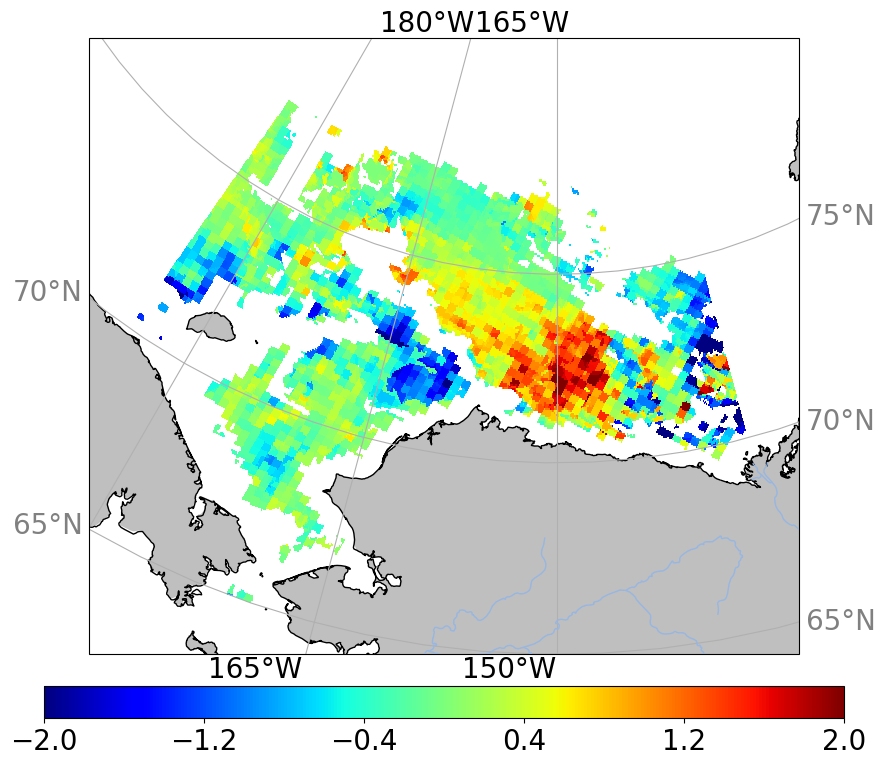

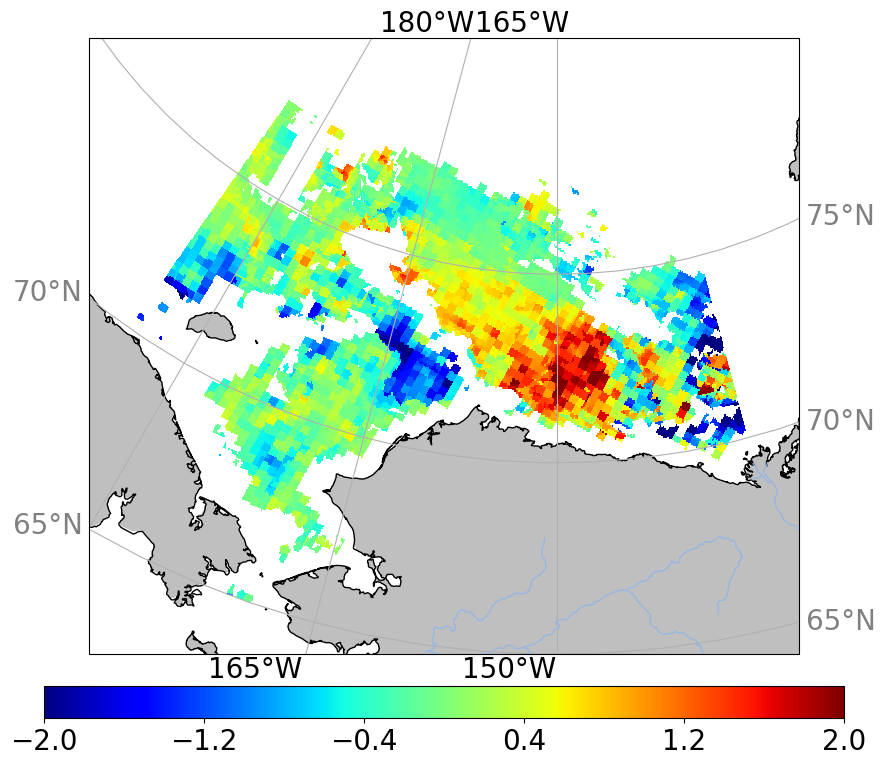

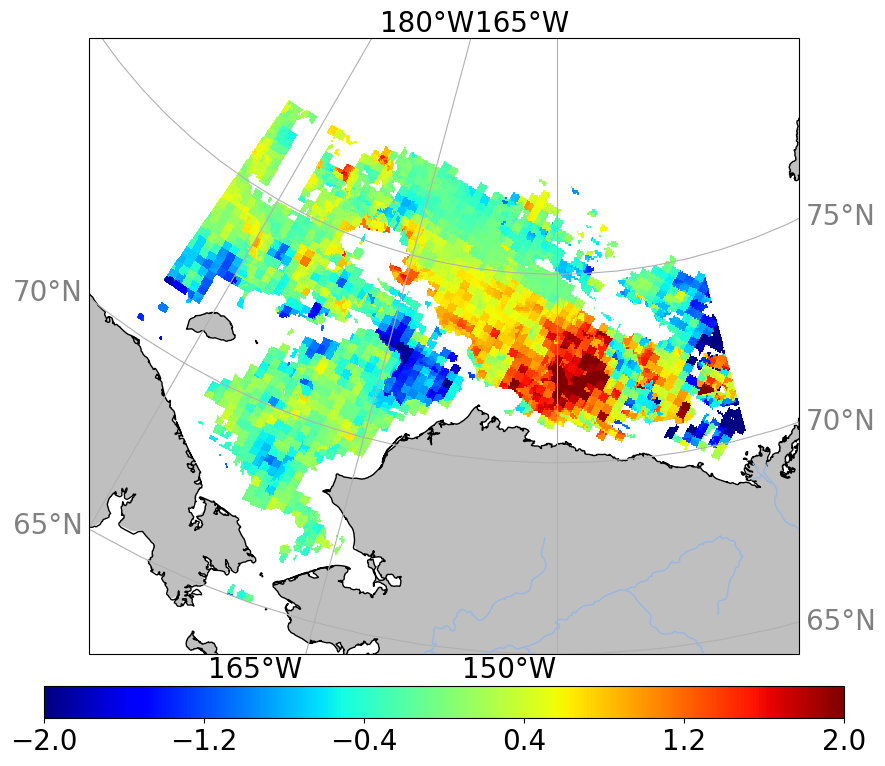

In [68]:
# Map of salinity anomalies one day to a week before the last freeze up in the fall:

for k in range(0,8):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(nws.lon,nws.lat,ano_sal_beforelastfreeze[:,:,k].squeeze(),cmap=palette,vmin=-2,vmax=2,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
    fig_name='map_sal_beforelastfreeze_'+str(year)+'_day-'+str(k+1)+'.png'
    #plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

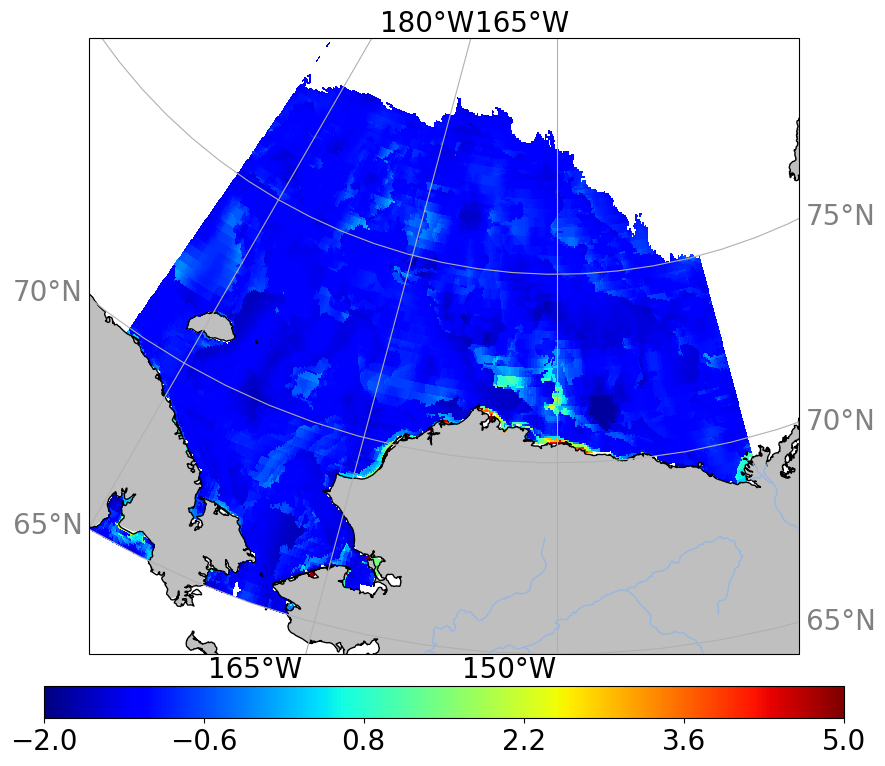

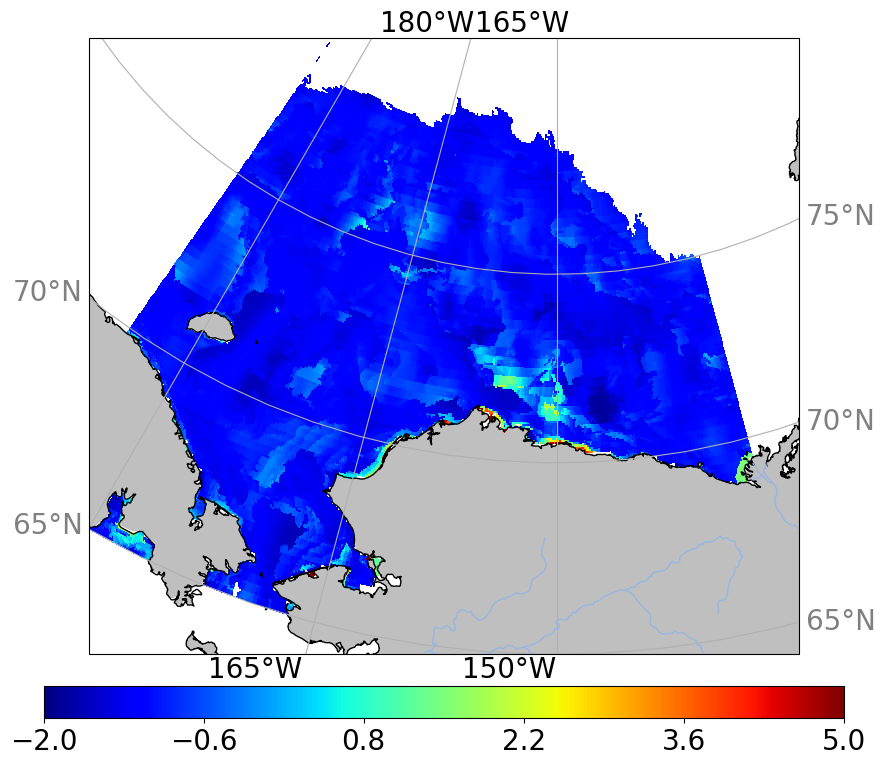

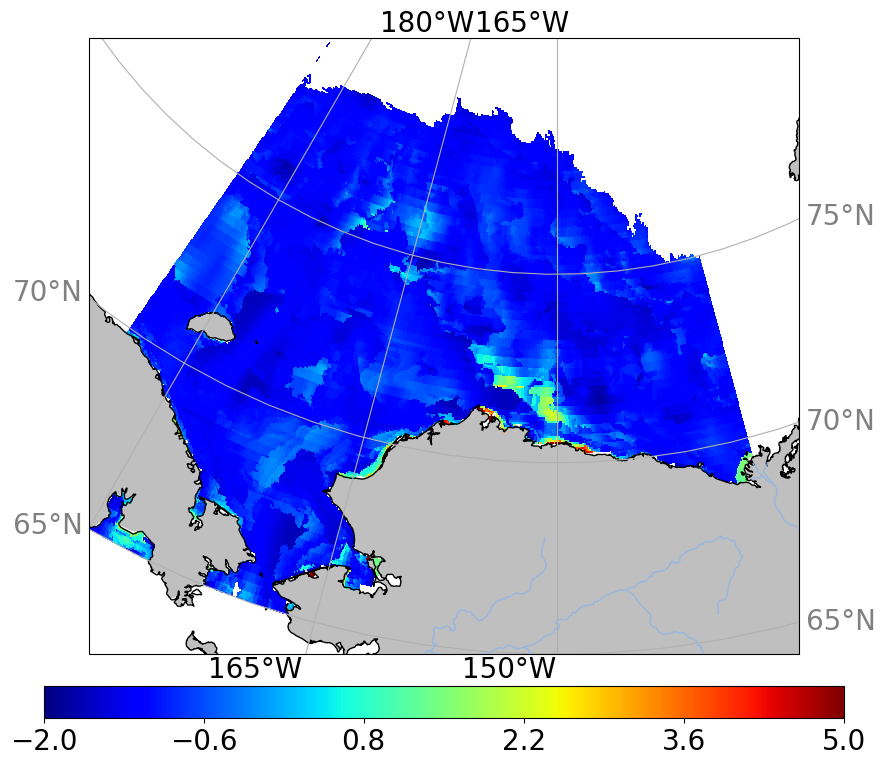

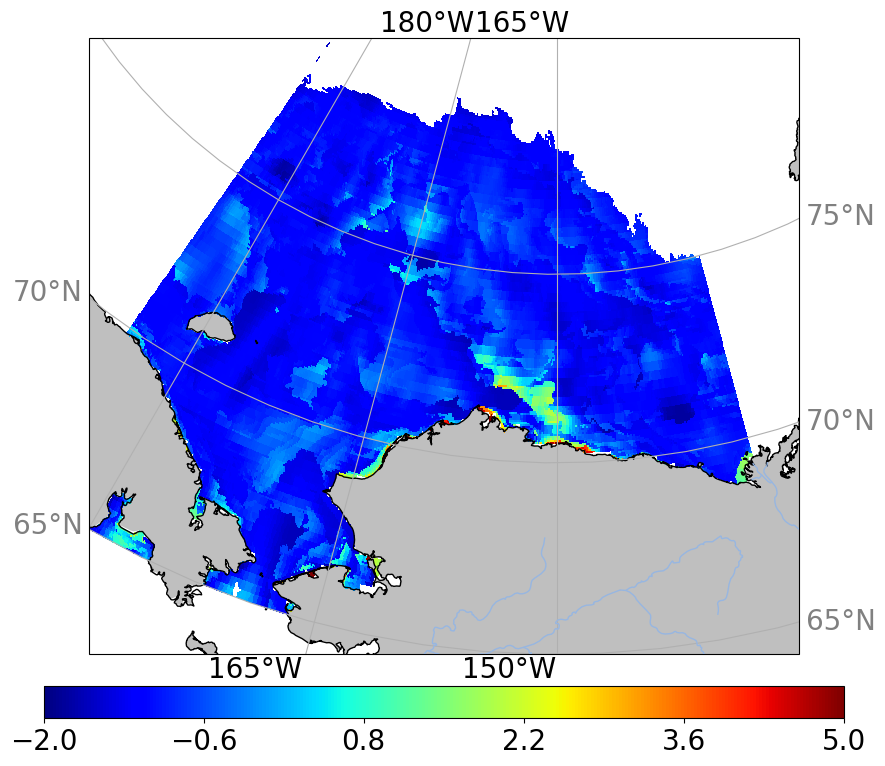

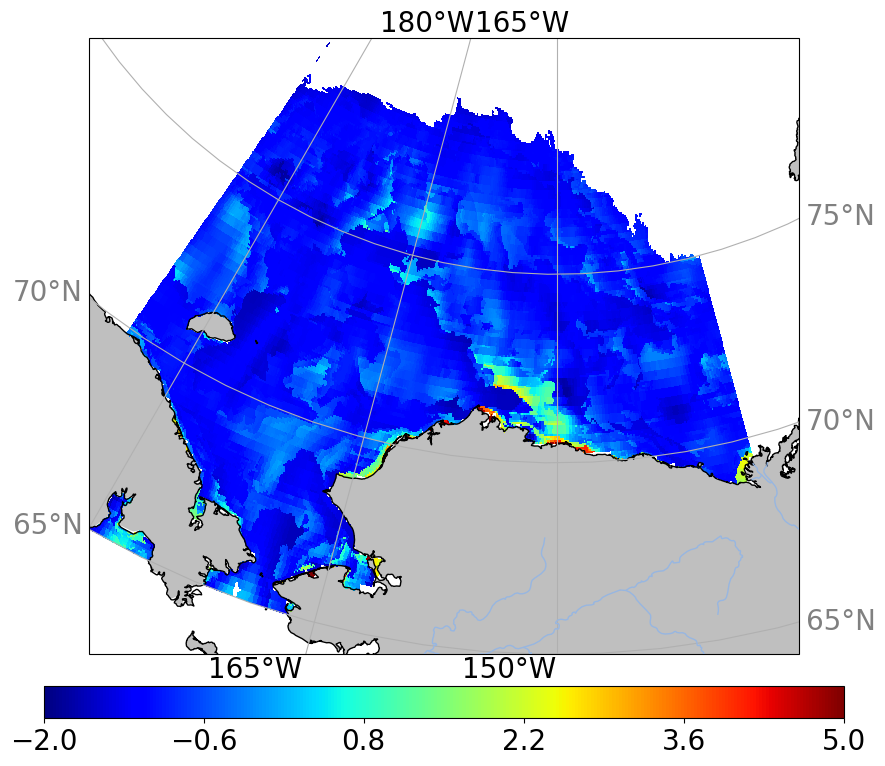

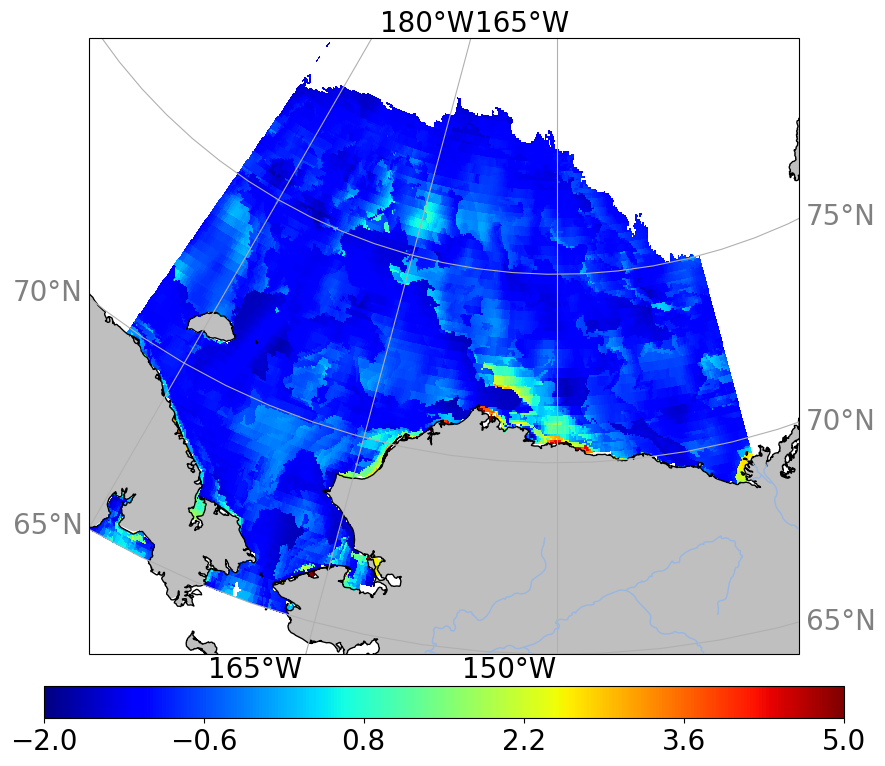

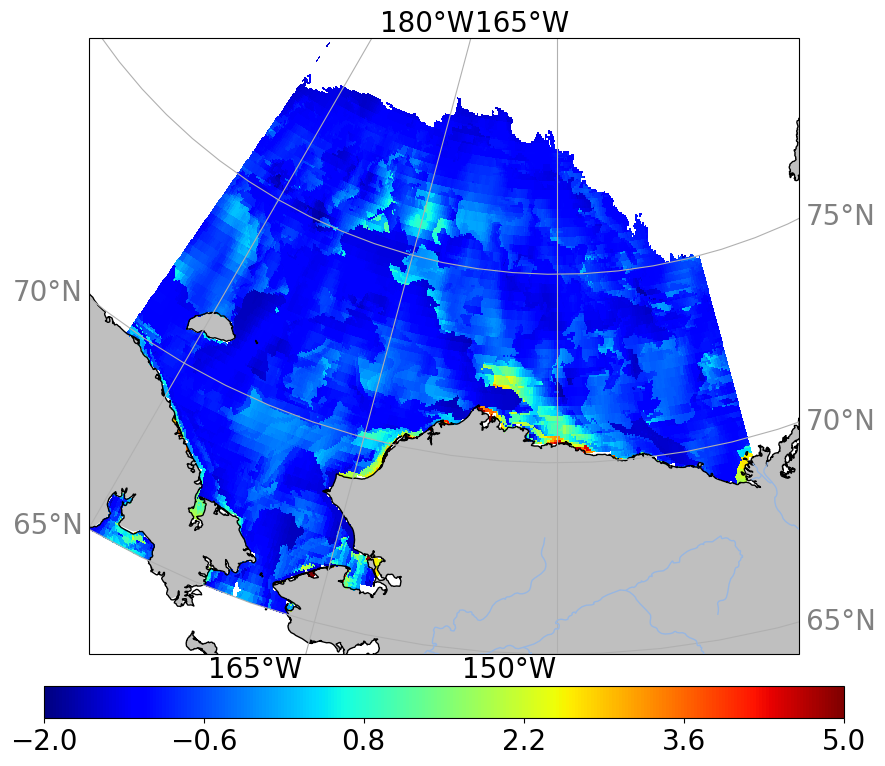

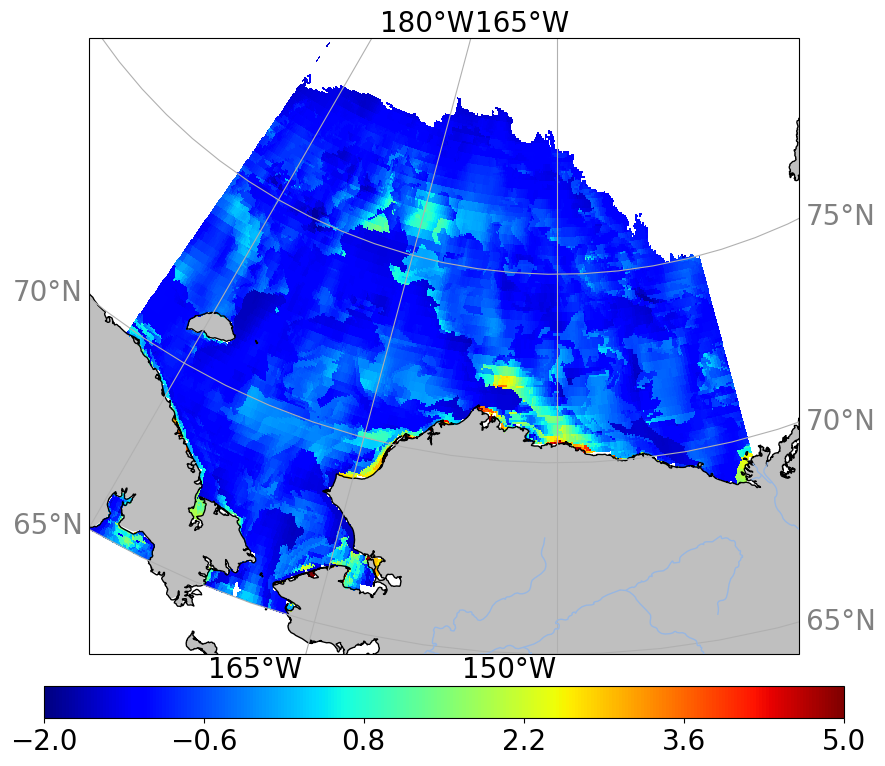

In [69]:
# Map of temperature one day to a week before the last freeze up in the fall:

for k in range(0,8):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(nws.lon,nws.lat,temp_beforelastfreeze[:,:,k].squeeze(),cmap=palette,vmin=-2,vmax=5,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
    fig_name='map_temp_beforelastfreeze_'+str(year)+'_day-'+str(k+1)+'.png'
    #plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

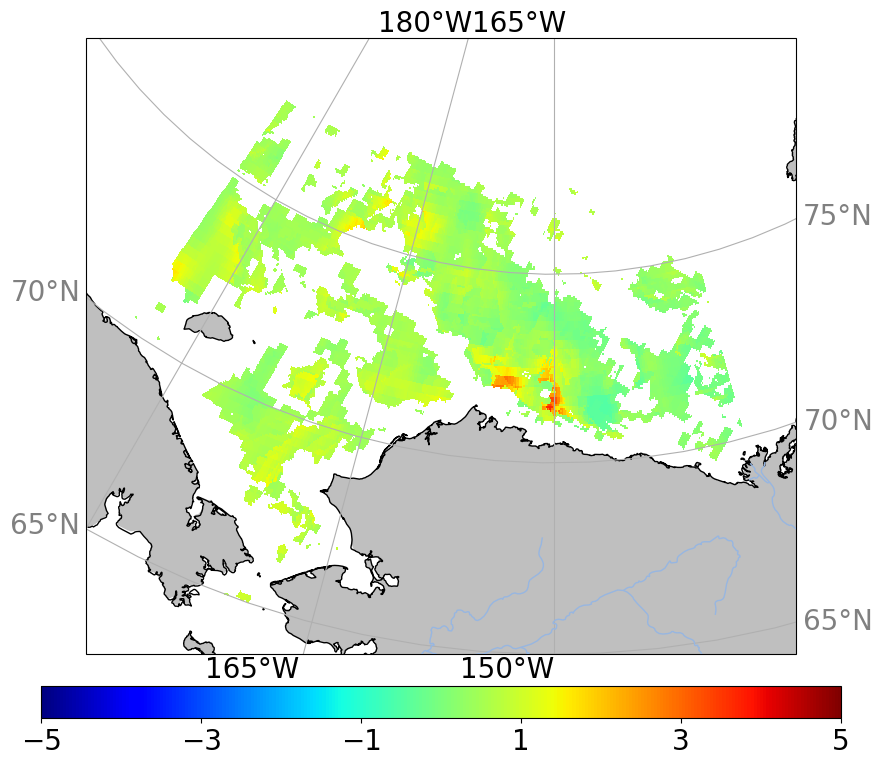

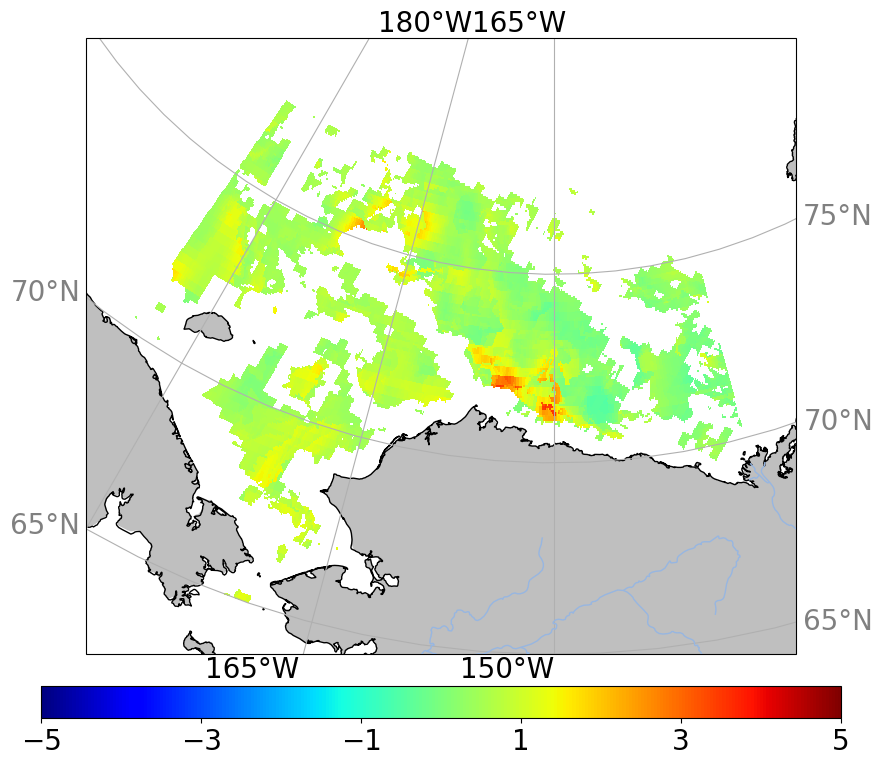

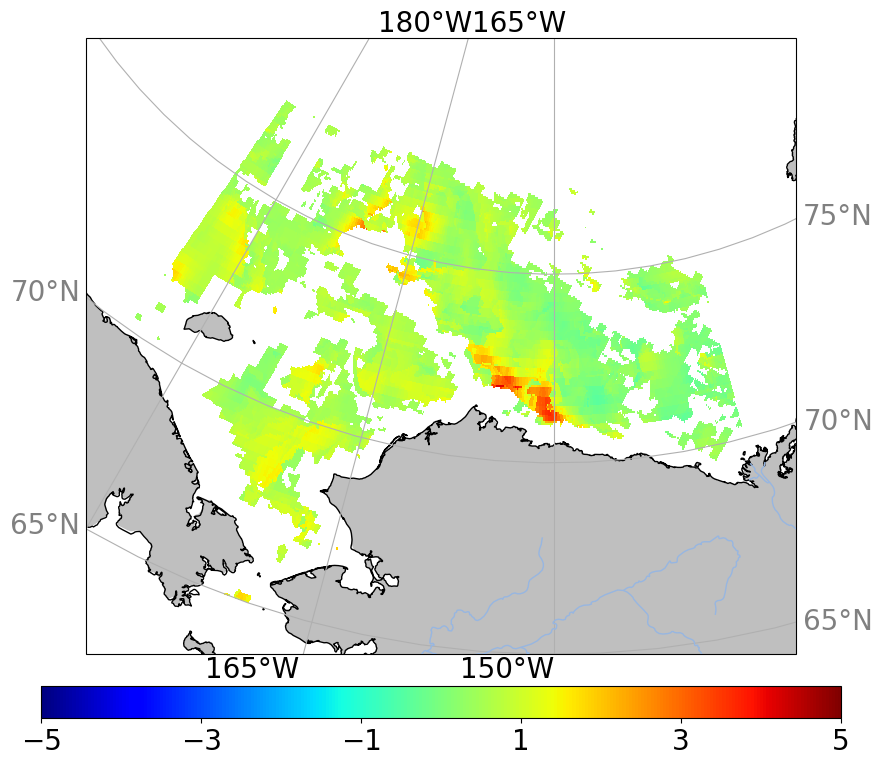

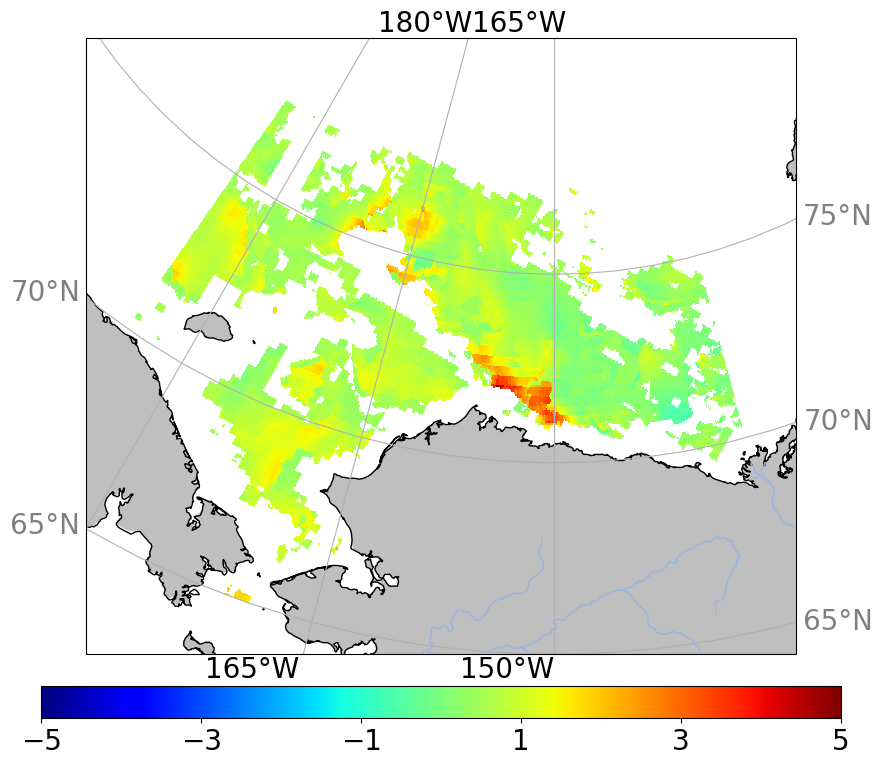

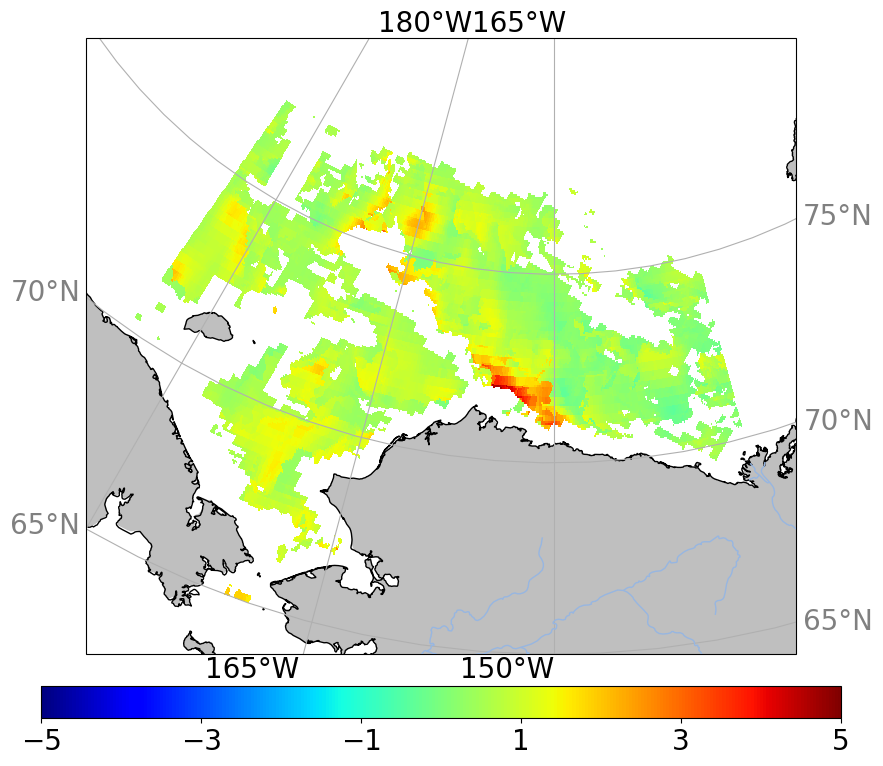

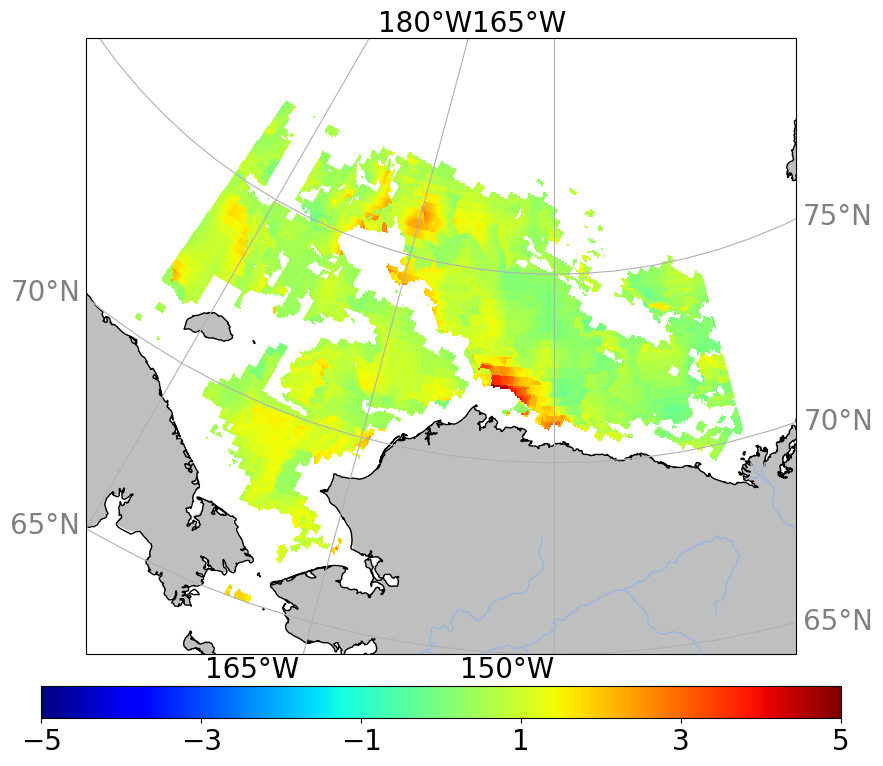

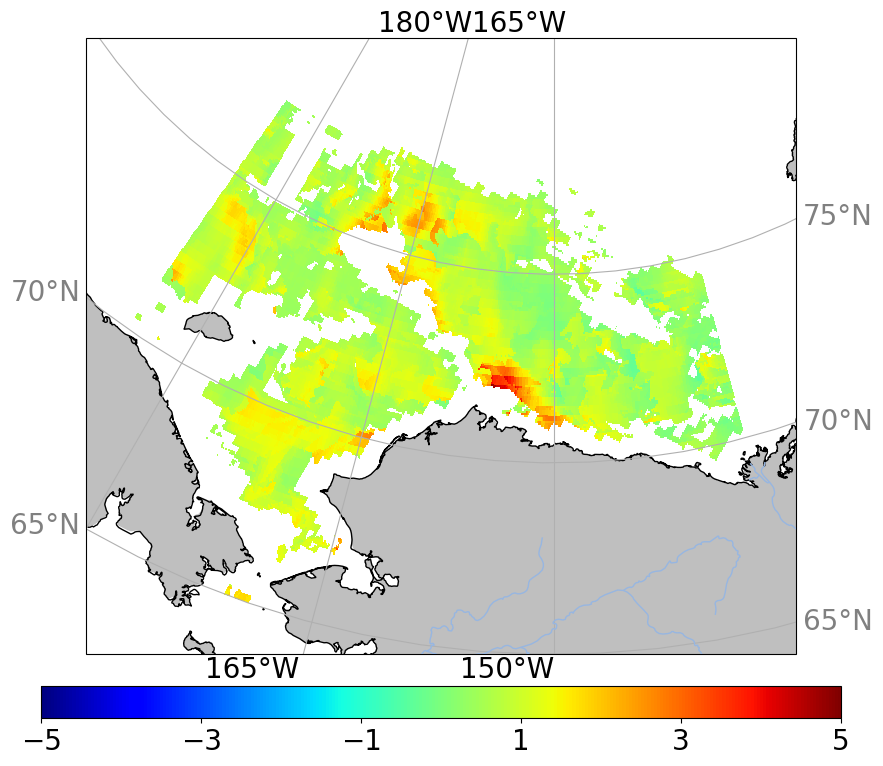

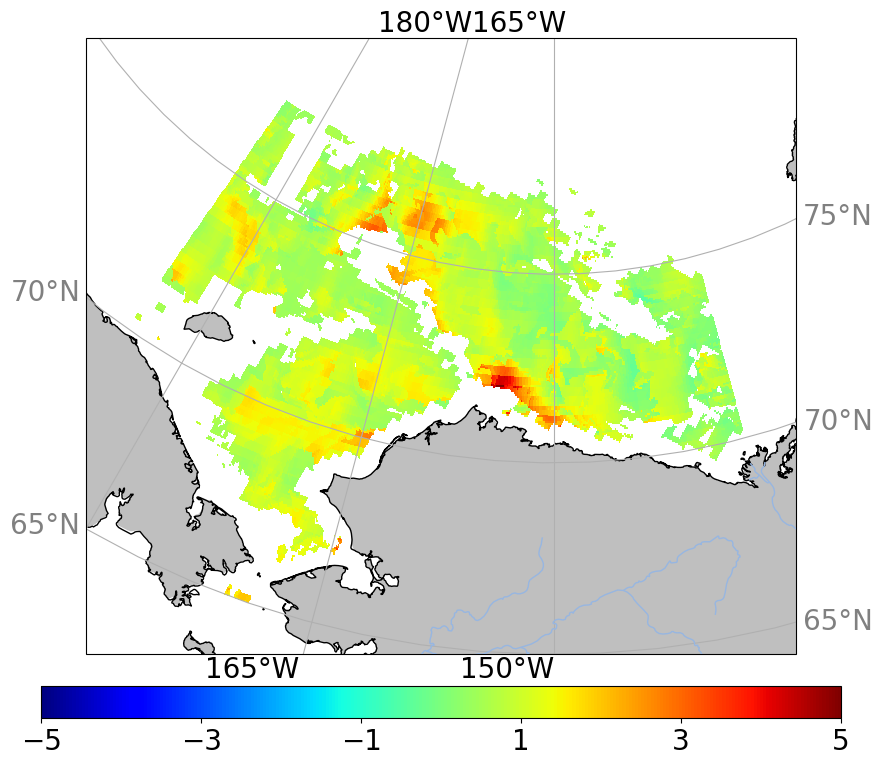

In [70]:
# Map of temperature anomalies one day to a week before the last freeze up in the fall:

for k in range(0,8):
    fig = plt.figure(figsize=(10,8))
    ax = plt.axes(projection=cartopy.crs.NorthPolarStereo(central_longitude=lon0))
    ax.set_extent([lonmin, lonmax, latmin, latmax], crs=cartopy.crs.PlateCarree()) 
    ax.add_feature(cfeature.LAND, facecolor = '0.75',zorder=1)
    ax.coastlines('10m',zorder=2)
    ax.add_feature(cfeature.RIVERS,facecolor='blue',zorder=3)
    gl = ax.gridlines(draw_labels=True, x_inline=False, y_inline=False)
    gl.xlocator = mticker.FixedLocator(np.arange(lonmin,lonmax,15))
    gl.xformatter = LONGITUDE_FORMATTER
    gl.xlabel_style = {'size': 20, 'color': 'k','rotation':0}
    gl.yformatter = LATITUDE_FORMATTER
    gl.ylocator = mticker.FixedLocator(np.arange(latmin,latmax,5))
    gl.ylabel_style = {'size': 20, 'color': 'gray','rotation':0}
    palette = plt.cm.jet
    pp=ax.pcolormesh(nws.lon,nws.lat,ano_temp_beforelastfreeze[:,:,k].squeeze(),cmap=palette,vmin=-5,vmax=5,transform=cartopy.crs.PlateCarree())
    cbar_ax = fig.add_axes([0.1, 0.1, 0.8, 0.04])
    h=plt.colorbar(pp, cax=cbar_ax,orientation='horizontal',ax=ax)
    h.ax.tick_params(labelsize=20)
    h.set_label('',fontsize=20)
    cmin,cmax = h.mappable.get_clim()
    ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
    h.set_ticks(ticks)
    plt.subplots_adjust(right=0.9,left=0.1,top=0.95,bottom=0.18)
    fig_name='map_temp_beforelastfreeze_'+str(year)+'_day-'+str(k+1)+'.png'
    #plt.savefig(fig_dir / fig_name,dpi=200,transparent=False,facecolor='white')

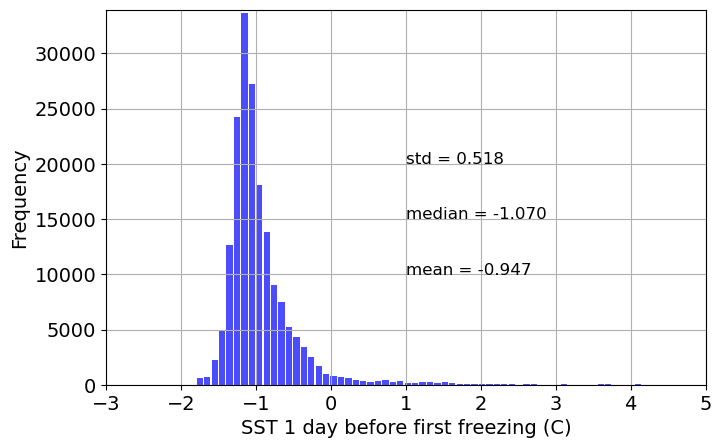

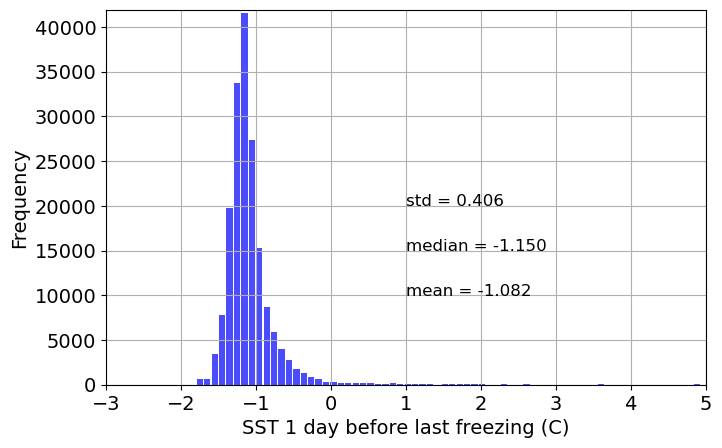

In [71]:
#histogram SST before first/last freeze
tmp=+temp_beforefirstfreeze[:,:,0]
ind=np.where(np.isfinite(tmp))
median=np.nanmedian(tmp[ind])
stdev=np.nanstd(tmp[ind])
mean=np.nanmean(tmp[ind])
meanstr="%.3f" % mean
medianstr="%.3f" % median
stdstr="%.3f" % stdev

fig,ax = plt.subplots(figsize=(8,5))
w = 0.1
nn = math.ceil((np.max(tmp[ind]) - np.min(tmp[ind]))/w)
n, bins, patches = plt.hist(x=tmp[ind], bins=nn, alpha=0.7, rwidth=0.85, color='b')
ax.grid()
ax.set_xlabel('SST 1 day before first freezing (C)', fontsize = 14)
ax.set_ylabel('Frequency', fontsize = 14)
plt.text(1, 10000, 'mean = '+meanstr, fontsize = 12)
plt.text(1, 15000, 'median = '+medianstr, fontsize = 12)
plt.text(1, 20000, 'std = '+stdstr, fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([-3,5])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)


tmp=+temp_beforelastfreeze[:,:,0]
ind=np.where(np.isfinite(tmp))
median=np.nanmedian(tmp[ind])
stdev=np.nanstd(tmp[ind])
mean=np.nanmean(tmp[ind])
meanstr="%.3f" % mean
medianstr="%.3f" % median
stdstr="%.3f" % stdev

fig,ax = plt.subplots(figsize=(8,5))
w = 0.1
nn = math.ceil((np.max(tmp[ind]) - np.min(tmp[ind]))/w)
n, bins, patches = plt.hist(x=tmp[ind], bins=nn, alpha=0.7, rwidth=0.85, color='b')
ax.grid()
ax.set_xlabel('SST 1 day before last freezing (C)', fontsize = 14)
ax.set_ylabel('Frequency', fontsize = 14)
plt.text(1, 10000, 'mean = '+meanstr, fontsize = 12)
plt.text(1, 15000, 'median = '+medianstr, fontsize = 12)
plt.text(1, 20000, 'std = '+stdstr, fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([-3,5])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

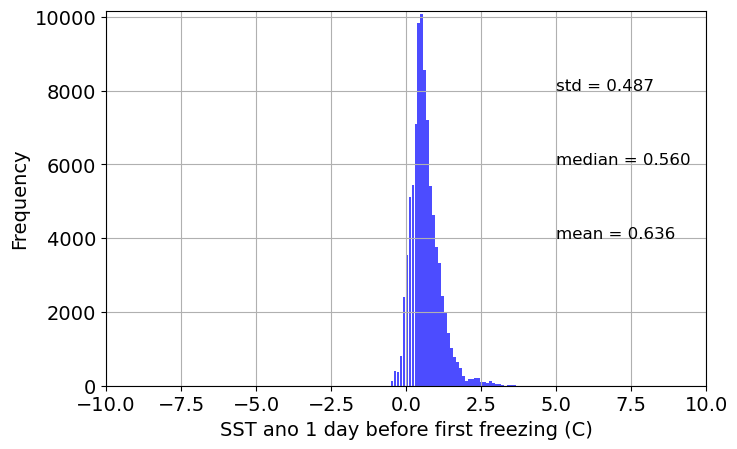

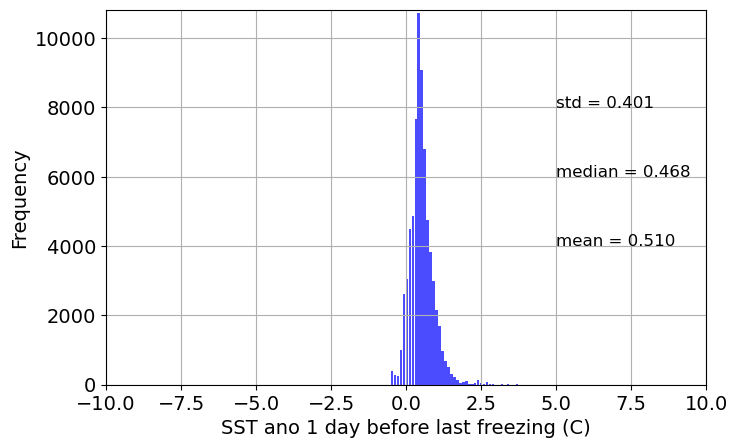

In [72]:
#histogram SST ano before first/last freeze
tmp=+ano_temp_beforefirstfreeze[:,:,0]
ind=np.where(np.isfinite(tmp))
median=np.nanmedian(tmp[ind])
stdev=np.nanstd(tmp[ind])
mean=np.nanmean(tmp[ind])
meanstr="%.3f" % mean
medianstr="%.3f" % median
stdstr="%.3f" % stdev

fig,ax = plt.subplots(figsize=(8,5))
w = 0.1
nn = math.ceil((np.max(tmp[ind]) - np.min(tmp[ind]))/w)
n, bins, patches = plt.hist(x=tmp[ind], bins=nn, alpha=0.7, rwidth=0.85, color='b')
ax.grid()
ax.set_xlabel('SST ano 1 day before first freezing (C)', fontsize = 14)
ax.set_ylabel('Frequency', fontsize = 14)
plt.text(5, 4000, 'mean = '+meanstr, fontsize = 12)
plt.text(5, 6000, 'median = '+medianstr, fontsize = 12)
plt.text(5, 8000, 'std = '+stdstr, fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([-10,10])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)


tmp=+ano_temp_beforelastfreeze[:,:,0]
ind=np.where(np.isfinite(tmp))
median=np.nanmedian(tmp[ind])
stdev=np.nanstd(tmp[ind])
mean=np.nanmean(tmp[ind])
meanstr="%.3f" % mean
medianstr="%.3f" % median
stdstr="%.3f" % stdev

fig,ax = plt.subplots(figsize=(8,5))
w = 0.1
nn = math.ceil((np.max(tmp[ind]) - np.min(tmp[ind]))/w)
n, bins, patches = plt.hist(x=tmp[ind], bins=nn, alpha=0.7, rwidth=0.85, color='b')
ax.grid()
ax.set_xlabel('SST ano 1 day before last freezing (C)', fontsize = 14)
ax.set_ylabel('Frequency', fontsize = 14)
plt.text(5, 4000, 'mean = '+meanstr, fontsize = 12)
plt.text(5, 6000, 'median = '+medianstr, fontsize = 12)
plt.text(5, 8000, 'std = '+stdstr, fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([-10,10])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

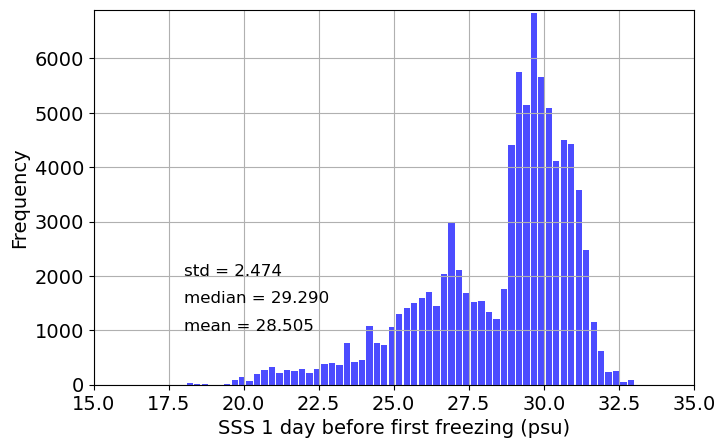

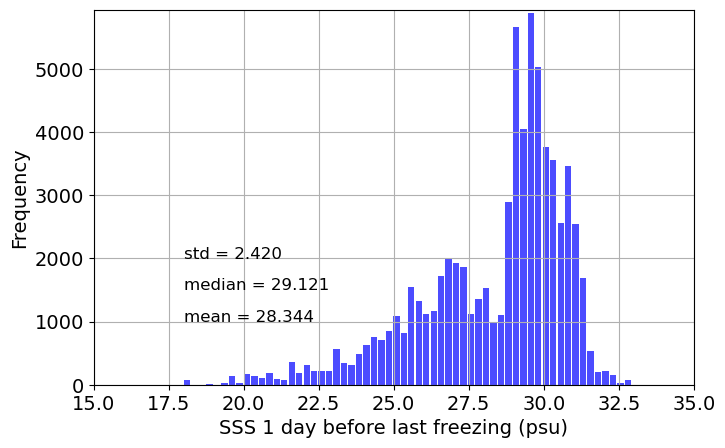

In [73]:
#histogram SSS before first/last freeze
tmp=+sal_beforefirstfreeze[:,:,0]
ind=np.where(np.isfinite(tmp))
median=np.nanmedian(tmp[ind])
stdev=np.nanstd(tmp[ind])
mean=np.nanmean(tmp[ind])
meanstr="%.3f" % mean
medianstr="%.3f" % median
stdstr="%.3f" % stdev

fig,ax = plt.subplots(figsize=(8,5))
w = 0.25
nn = math.ceil((np.max(tmp[ind]) - np.min(tmp[ind]))/w)
n, bins, patches = plt.hist(x=tmp[ind], bins=nn, alpha=0.7, rwidth=0.85, color='b')
ax.grid()
ax.set_xlabel('SSS 1 day before first freezing (psu)', fontsize = 14)
ax.set_ylabel('Frequency', fontsize = 14)
plt.text(18, 1000, 'mean = '+meanstr, fontsize = 12)
plt.text(18, 1500, 'median = '+medianstr, fontsize = 12)
plt.text(18, 2000, 'std = '+stdstr, fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([15,35])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)


tmp=+sal_beforelastfreeze[:,:,0]
ind=np.where(np.isfinite(tmp))
median=np.nanmedian(tmp[ind])
stdev=np.nanstd(tmp[ind])
mean=np.nanmean(tmp[ind])
meanstr="%.3f" % mean
medianstr="%.3f" % median
stdstr="%.3f" % stdev

fig,ax = plt.subplots(figsize=(8,5))
w = 0.25
nn = math.ceil((np.max(tmp[ind]) - np.min(tmp[ind]))/w)
n, bins, patches = plt.hist(x=tmp[ind], bins=nn, alpha=0.7, rwidth=0.85, color='b')
ax.grid()
ax.set_xlabel('SSS 1 day before last freezing (psu)', fontsize = 14)
ax.set_ylabel('Frequency', fontsize = 14)
plt.text(18, 1000, 'mean = '+meanstr, fontsize = 12)
plt.text(18, 1500, 'median = '+medianstr, fontsize = 12)
plt.text(18, 2000, 'std = '+stdstr, fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([15,35])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

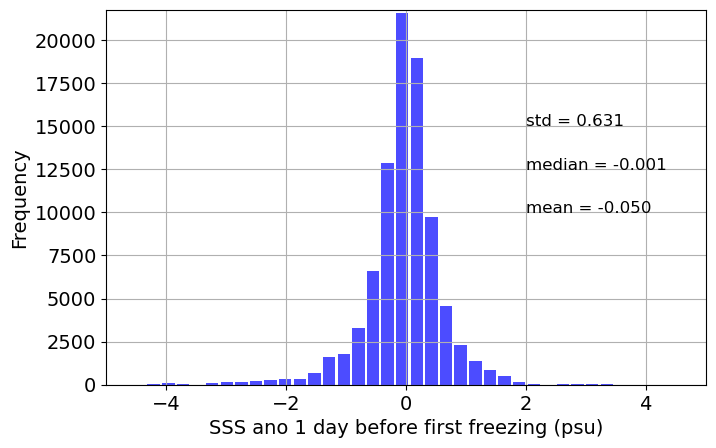

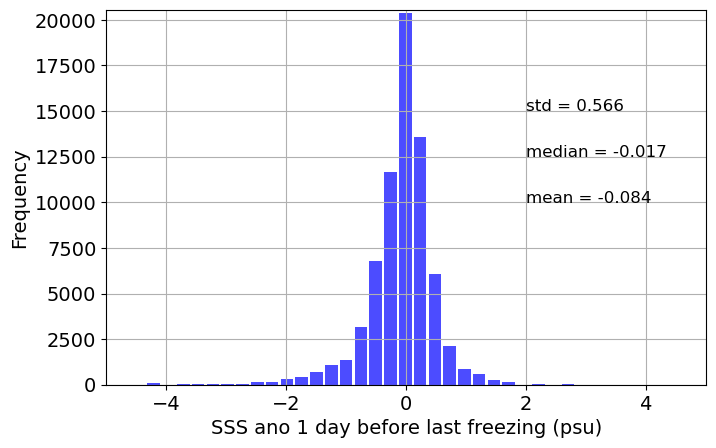

In [74]:
#histogram SSS ano before first/last freeze
tmp=+ano_sal_beforefirstfreeze[:,:,0]
ind=np.where(np.isfinite(tmp))
median=np.nanmedian(tmp[ind])
stdev=np.nanstd(tmp[ind])
mean=np.nanmean(tmp[ind])
meanstr="%.3f" % mean
medianstr="%.3f" % median
stdstr="%.3f" % stdev

fig,ax = plt.subplots(figsize=(8,5))
w = 0.25
nn = math.ceil((np.max(tmp[ind]) - np.min(tmp[ind]))/w)
n, bins, patches = plt.hist(x=tmp[ind], bins=nn, alpha=0.7, rwidth=0.85, color='b')
ax.grid()
ax.set_xlabel('SSS ano 1 day before first freezing (psu)', fontsize = 14)
ax.set_ylabel('Frequency', fontsize = 14)
plt.text(2, 10000, 'mean = '+meanstr, fontsize = 12)
plt.text(2, 12500, 'median = '+medianstr, fontsize = 12)
plt.text(2, 15000, 'std = '+stdstr, fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([-5,5])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)


tmp=+ano_sal_beforelastfreeze[:,:,0]
ind=np.where(np.isfinite(tmp))
median=np.nanmedian(tmp[ind])
stdev=np.nanstd(tmp[ind])
mean=np.nanmean(tmp[ind])
meanstr="%.3f" % mean
medianstr="%.3f" % median
stdstr="%.3f" % stdev

fig,ax = plt.subplots(figsize=(8,5))
w = 0.25
nn = math.ceil((np.max(tmp[ind]) - np.min(tmp[ind]))/w)
n, bins, patches = plt.hist(x=tmp[ind], bins=nn, alpha=0.7, rwidth=0.85, color='b')
ax.grid()
ax.set_xlabel('SSS ano 1 day before last freezing (psu)', fontsize = 14)
ax.set_ylabel('Frequency', fontsize = 14)
plt.text(2, 10000, 'mean = '+meanstr, fontsize = 12)
plt.text(2, 12500, 'median = '+medianstr, fontsize = 12)
plt.text(2, 15000, 'std = '+stdstr, fontsize = 12)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([-5,5])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

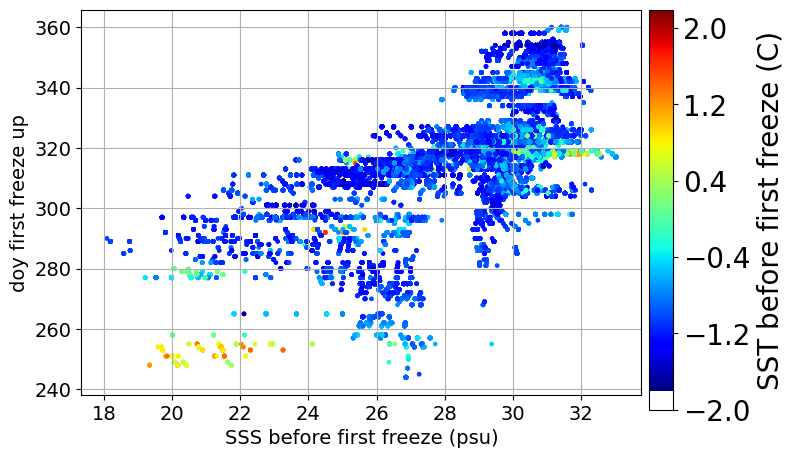

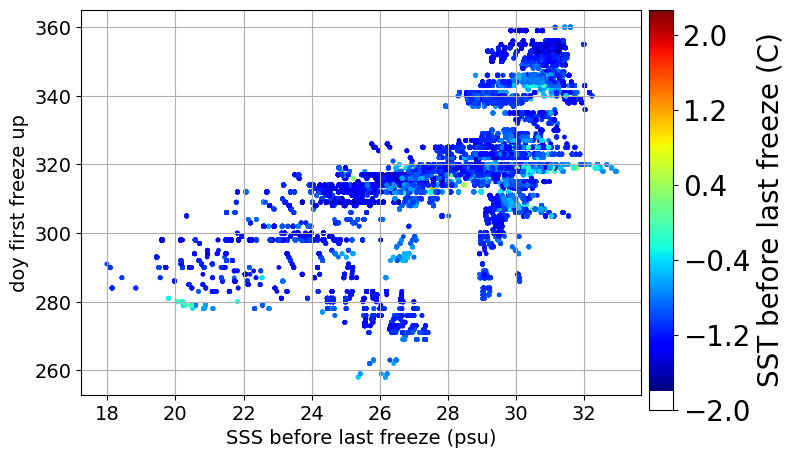

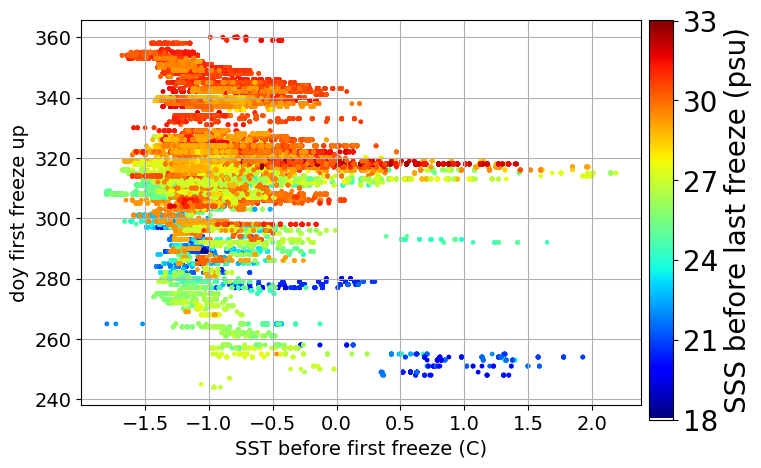

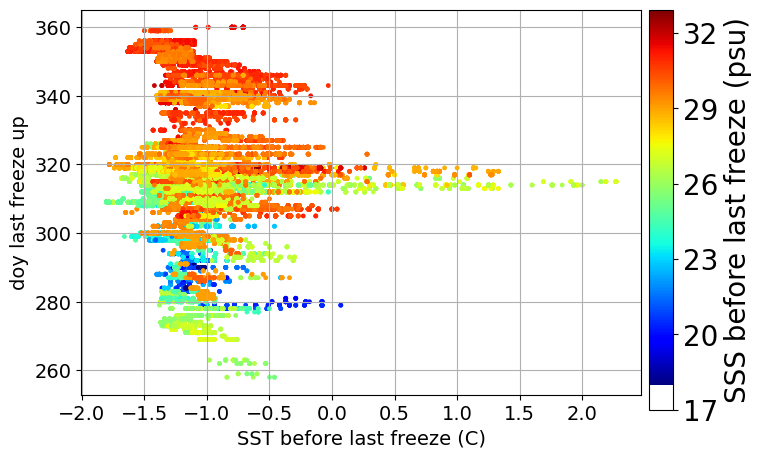

In [75]:
# Doy of first/last freeze wrt SSS and SST

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.scatter(sal_beforefirstfreeze[:,:,0].squeeze(),doy_freeze_first,6,temp_beforefirstfreeze[:,:,0].squeeze(),cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])  
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('SST before first freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.scatter(sal_beforelastfreeze[:,:,0].squeeze(),doy_open_last+1,6,temp_beforelastfreeze[:,:,0].squeeze(),cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])  
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('SST before last freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)


fig,ax = plt.subplots(figsize=(8,5))
pp=plt.scatter(temp_beforefirstfreeze[:,:,0].squeeze(),doy_freeze_first,6,sal_beforefirstfreeze[:,:,0].squeeze(),cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('SSS before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.scatter(temp_beforelastfreeze[:,:,0].squeeze(),doy_open_last+1,6,sal_beforelastfreeze[:,:,0].squeeze(),cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('SSS before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

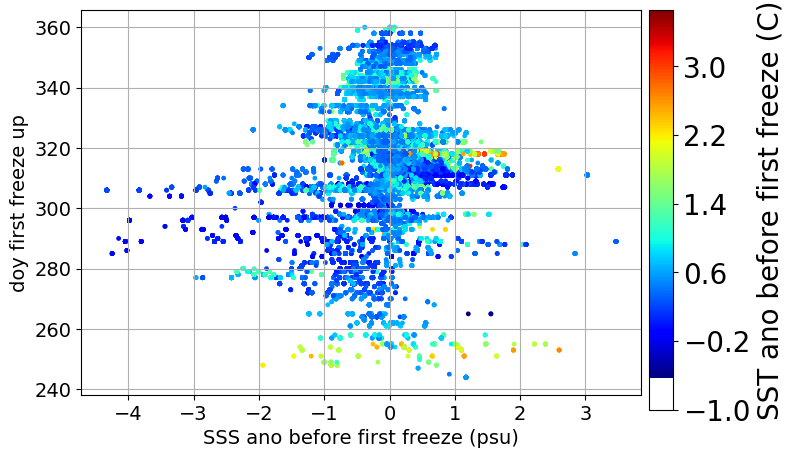

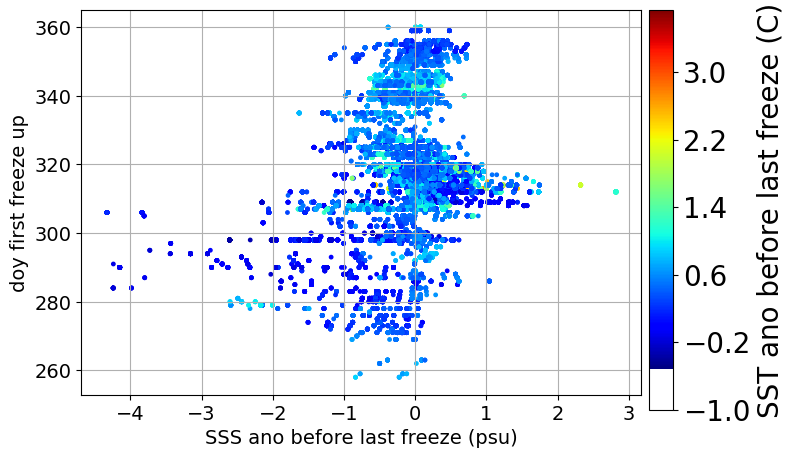

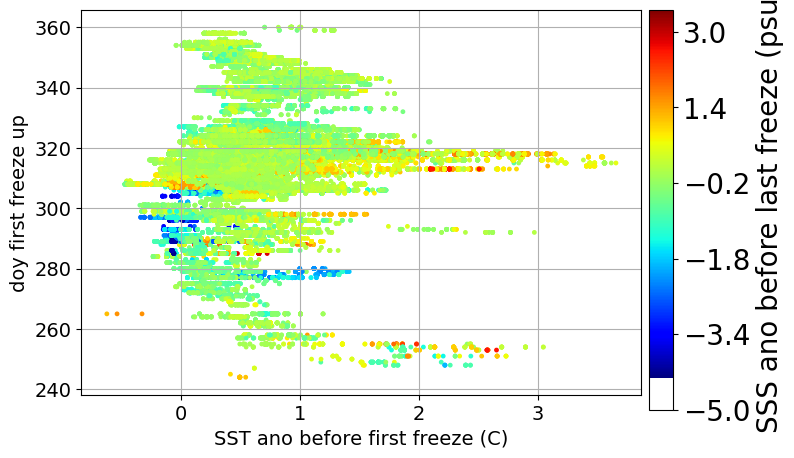

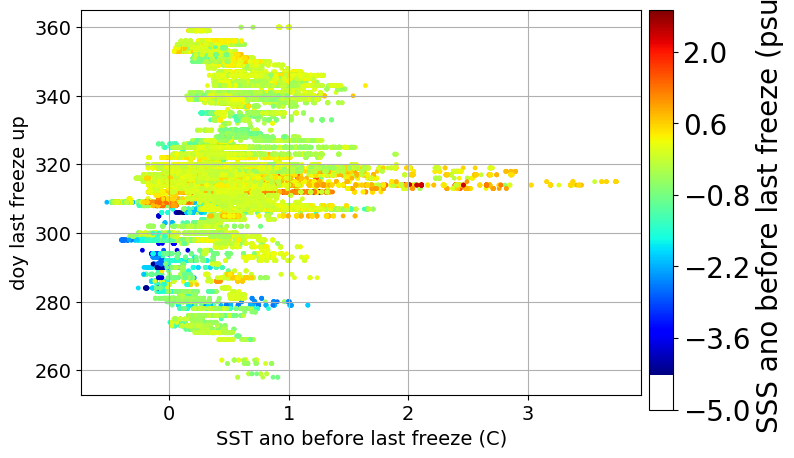

In [76]:
# Doy of first/last freeze wrt SSS and SST ano

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.scatter(ano_sal_beforefirstfreeze[:,:,0].squeeze(),doy_freeze_first,6,ano_temp_beforefirstfreeze[:,:,0].squeeze(),cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])  
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('SST ano before first freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.scatter(ano_sal_beforelastfreeze[:,:,0].squeeze(),doy_open_last+1,6,ano_temp_beforelastfreeze[:,:,0].squeeze(),cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])  
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('SST ano before last freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)


fig,ax = plt.subplots(figsize=(8,5))
pp=plt.scatter(ano_temp_beforefirstfreeze[:,:,0].squeeze(),doy_freeze_first,6,ano_sal_beforefirstfreeze[:,:,0].squeeze(),cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('SSS ano before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.scatter(ano_temp_beforelastfreeze[:,:,0].squeeze(),doy_open_last+1,6,ano_sal_beforelastfreeze[:,:,0].squeeze(),cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('SSS ano before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

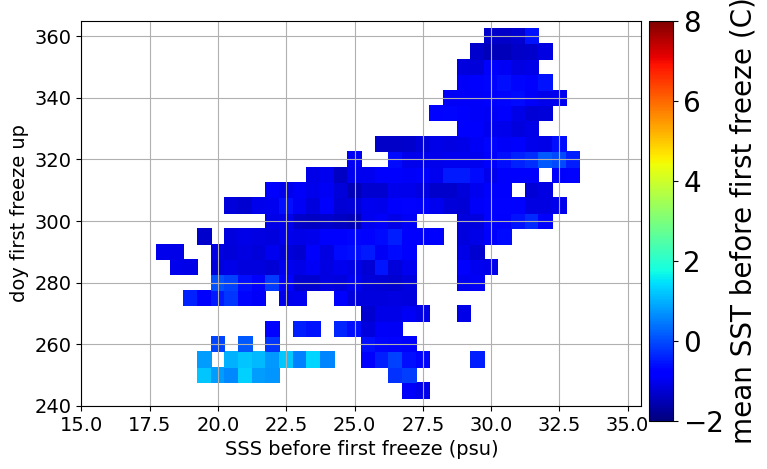

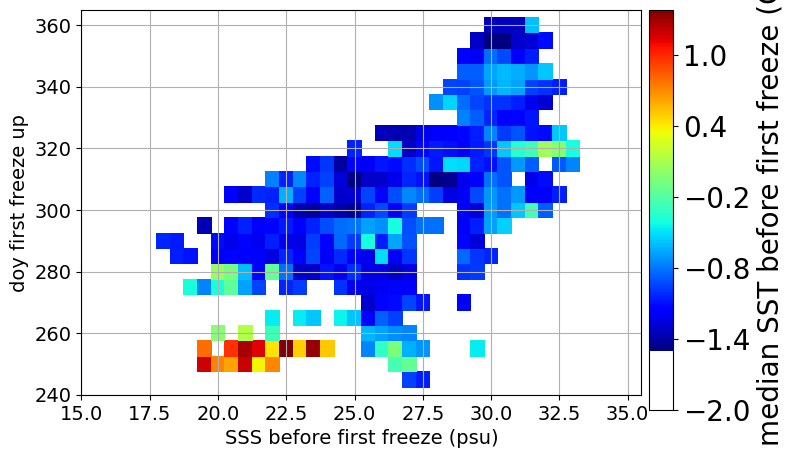

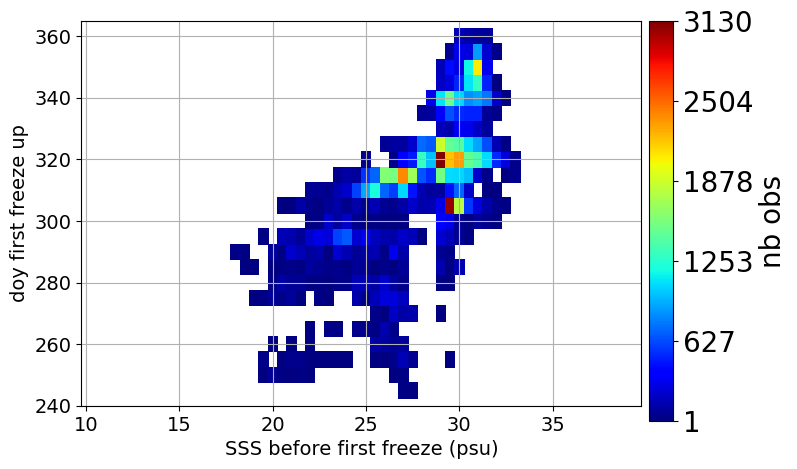

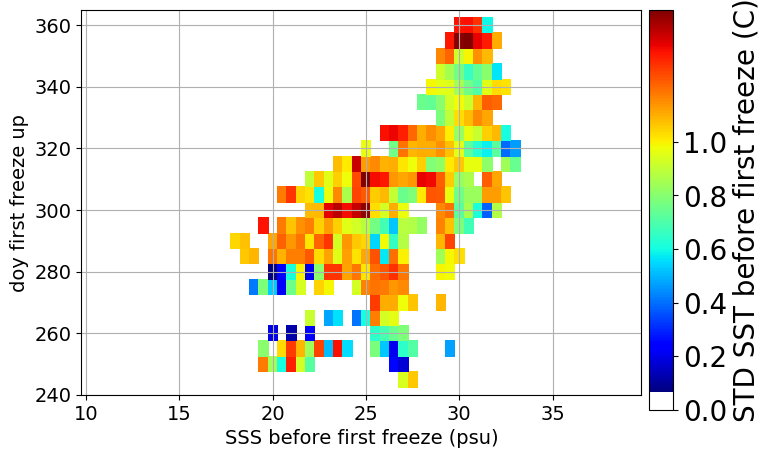

In [77]:
#grid SST/SSS of first/last freeze wrt SSS/SST and doy

SSSgrid=np.arange(10,40,0.5)
DOYgrid=np.arange(240,365,5)
SSTgrid=np.arange(-5,10,0.5)

[datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms]=ffgridrms(sal_beforefirstfreeze[:,:,0].squeeze(),doy_freeze_first,temp_beforefirstfreeze[:,:,0].squeeze(),SSSgrid,DOYgrid)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSgrid,DOYgrid,datagrid_mean,cmap=plt.cm.jet,vmin=-2,vmax=8)
ax.grid()
ax.set_xlabel('SSS before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('mean SST before first freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSgrid,DOYgrid,datagrid_median,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('median SST before first freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSgrid,DOYgrid,ngrid,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
# plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('nb obs',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSgrid,DOYgrid,datagridrms,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
# plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('STD SST before first freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

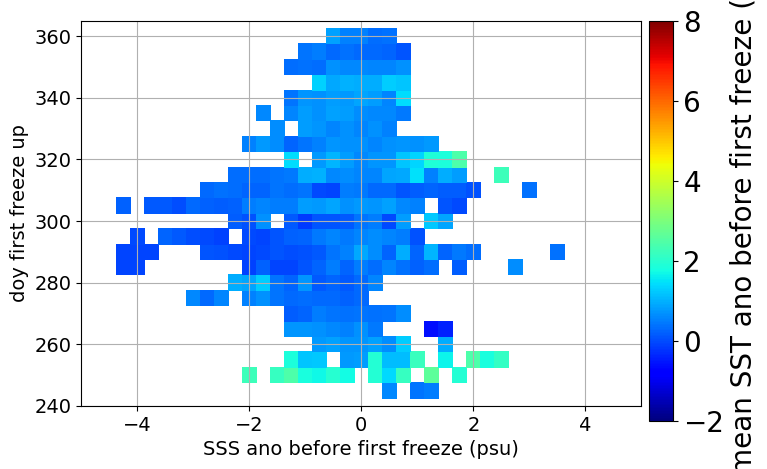

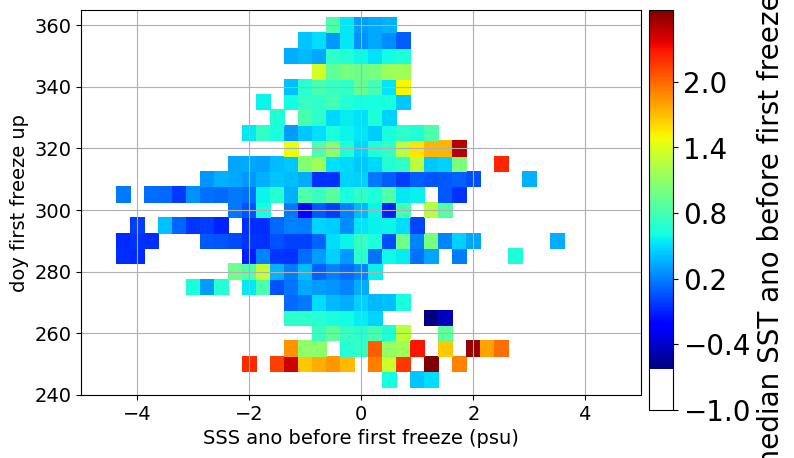

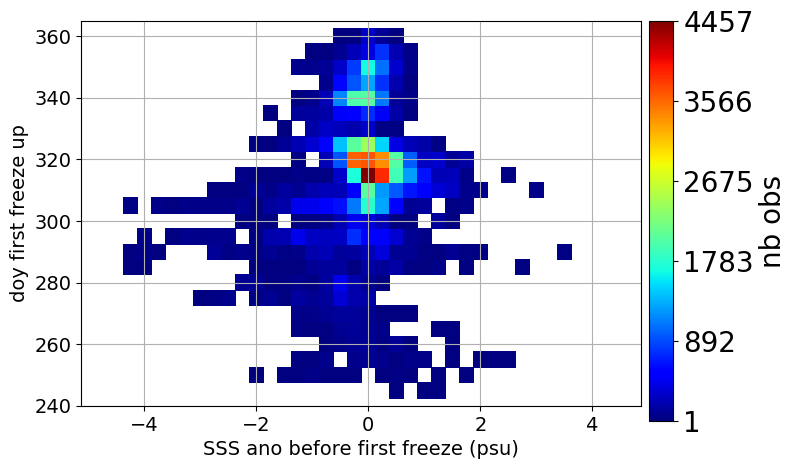

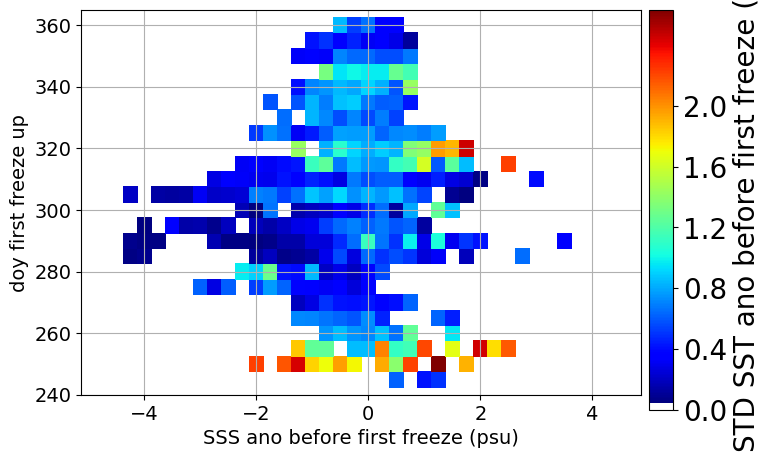

In [78]:
#grid SST/SSS ano of first/last freeze wrt SSS/SST ano and doy

SSSanogrid=np.arange(-5,5,0.25)
DOYgrid=np.arange(240,365,5)
SSTanogrid=np.arange(-10,10,0.25)

[datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms]=ffgridrms(ano_sal_beforefirstfreeze[:,:,0].squeeze(),doy_freeze_first,ano_temp_beforefirstfreeze[:,:,0].squeeze(),SSSanogrid,DOYgrid)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSanogrid,DOYgrid,datagrid_mean,cmap=plt.cm.jet,vmin=-2,vmax=8)
ax.grid()
ax.set_xlabel('SSS ano before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
plt.xlim([-5,5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('mean SST ano before first freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSanogrid,DOYgrid,datagrid_median,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
plt.xlim([-5,5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('median SST ano before first freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSanogrid,DOYgrid,ngrid,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
# plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('nb obs',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSanogrid,DOYgrid,datagridrms,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before first freeze (psu)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
# plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('STD SST ano before first freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

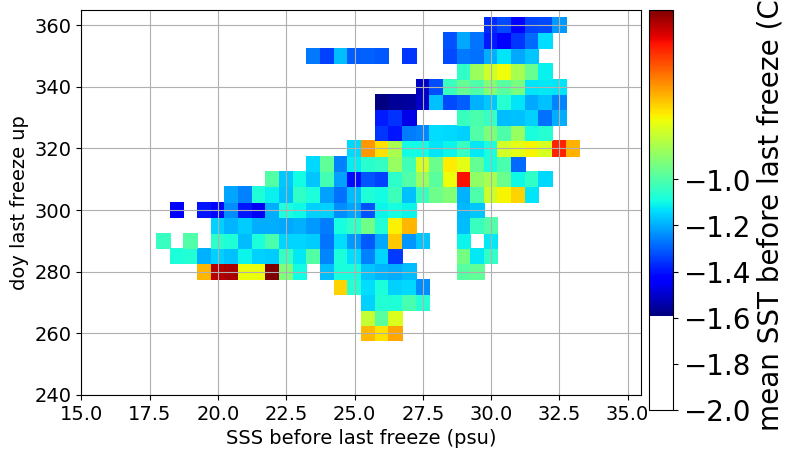

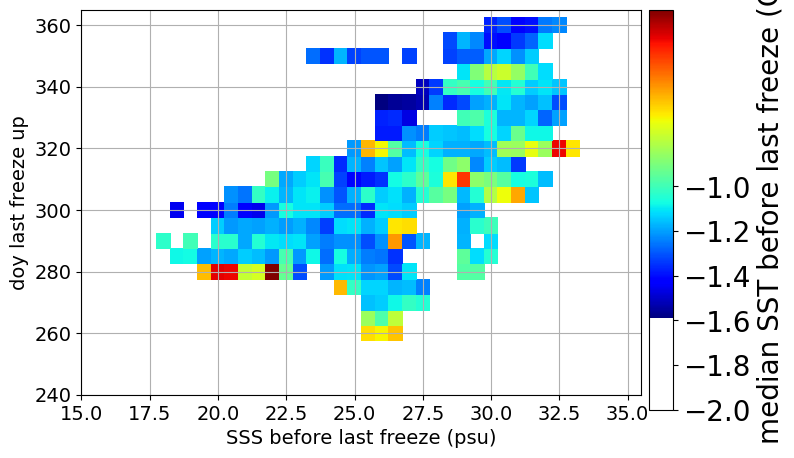

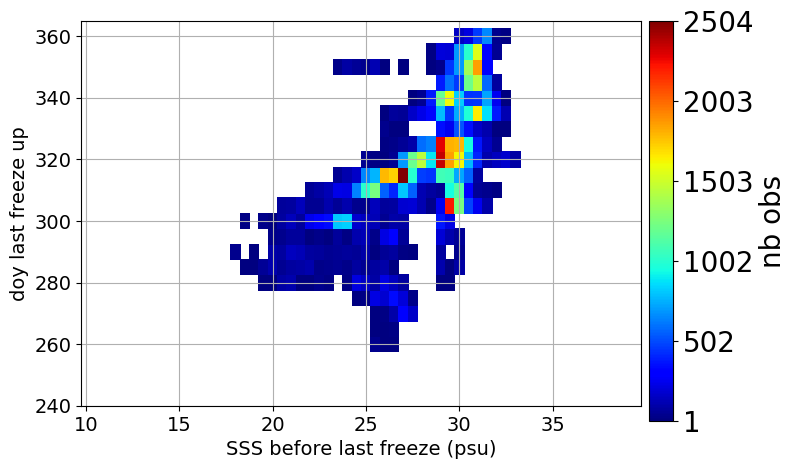

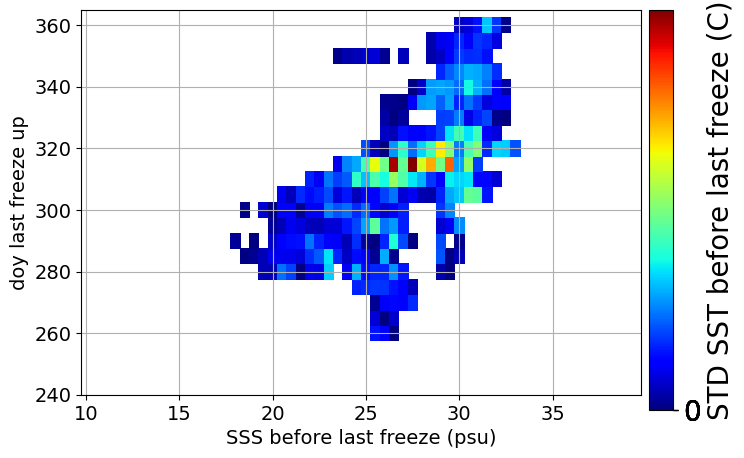

In [79]:
[datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms]=ffgridrms(sal_beforefirstfreeze[:,:,0].squeeze(),doy_open_last+1,temp_beforelastfreeze[:,:,0].squeeze(),SSSgrid,DOYgrid)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSgrid,DOYgrid,datagrid_mean,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('mean SST before last freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSgrid,DOYgrid,datagrid_median,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('median SST before last freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSgrid,DOYgrid,ngrid,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
# plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('nb obs',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSgrid,DOYgrid,datagridstd,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
# plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('STD SST before last freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

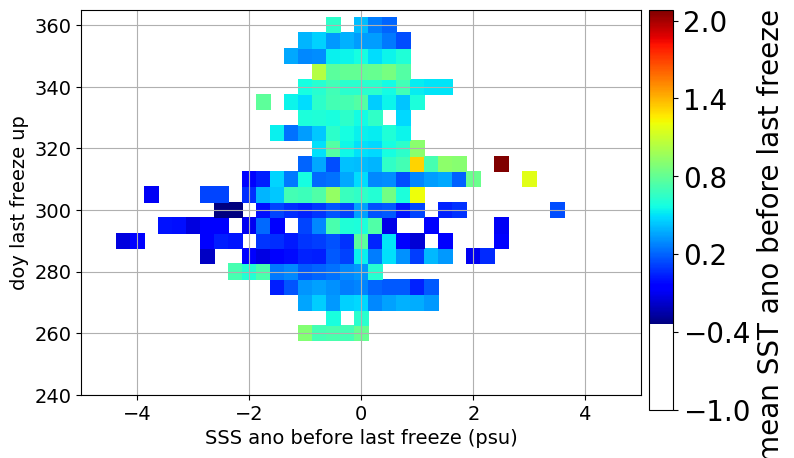

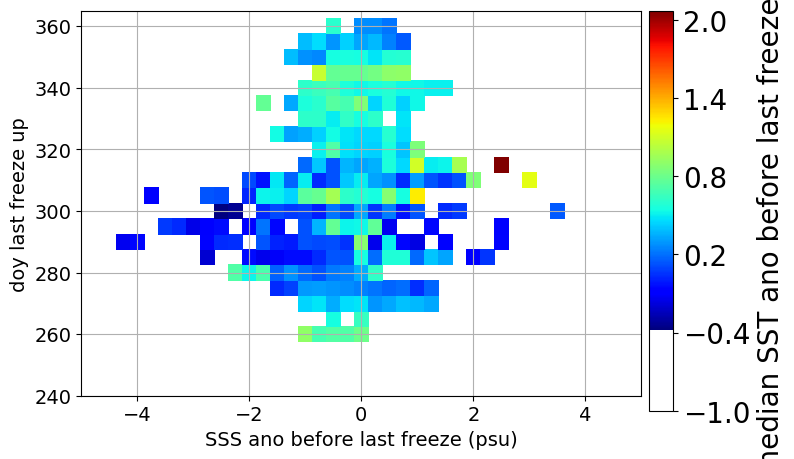

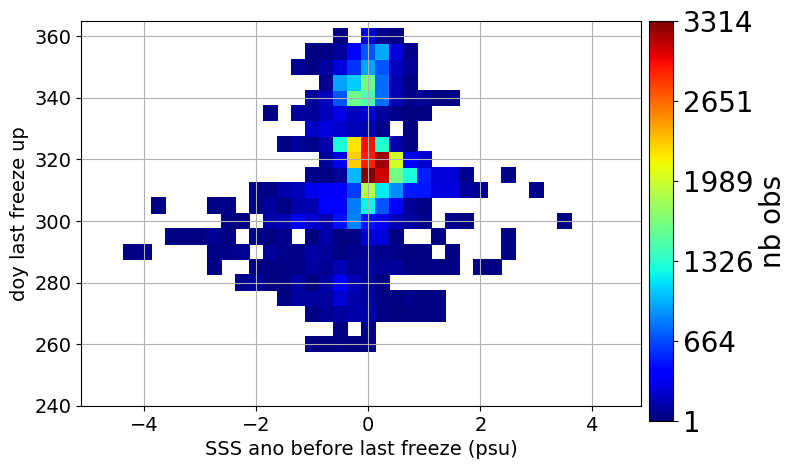

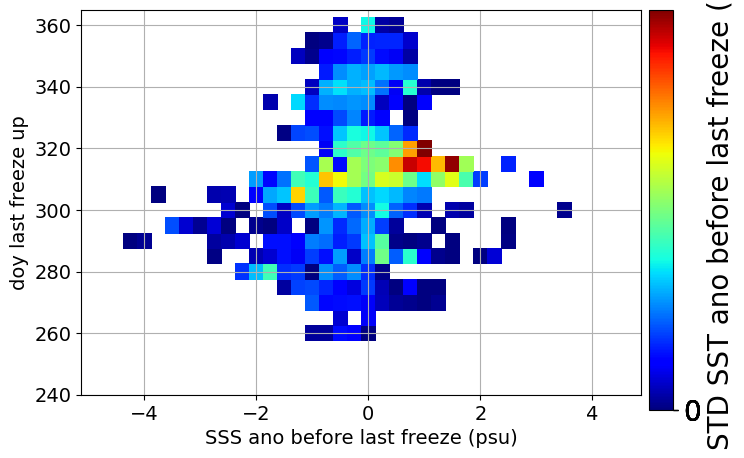

In [80]:
[datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms]=ffgridrms(ano_sal_beforefirstfreeze[:,:,0].squeeze(),doy_open_last+1,ano_temp_beforelastfreeze[:,:,0].squeeze(),SSSanogrid,DOYgrid)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSanogrid,DOYgrid,datagrid_mean,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
plt.xlim([-5,5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('mean SST ano before last freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSanogrid,DOYgrid,datagrid_median,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
plt.xlim([-5,5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('median SST ano before last freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSanogrid,DOYgrid,ngrid,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
# plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('nb obs',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSSanogrid,DOYgrid,datagridstd,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SSS ano before last freeze (psu)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
plt.ylim([240,365])
# plt.xlim([15,35.5])    
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('STD SST ano before last freeze (C)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

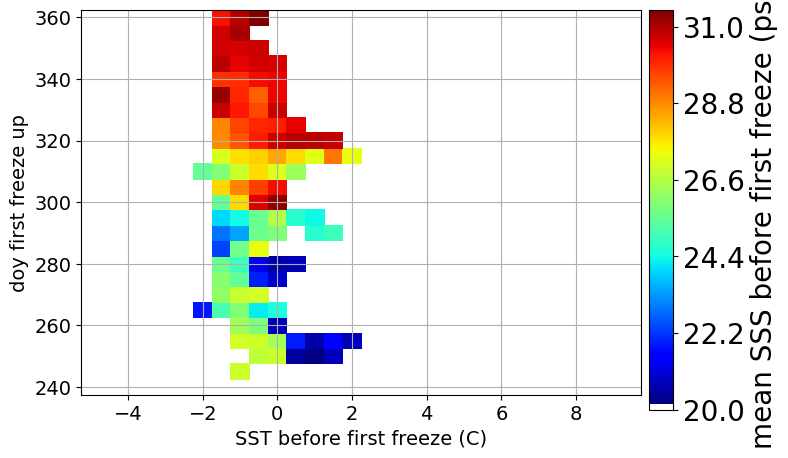

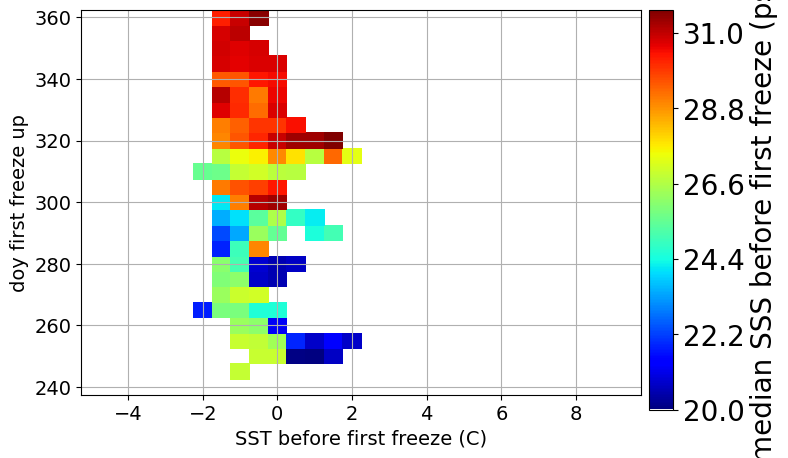

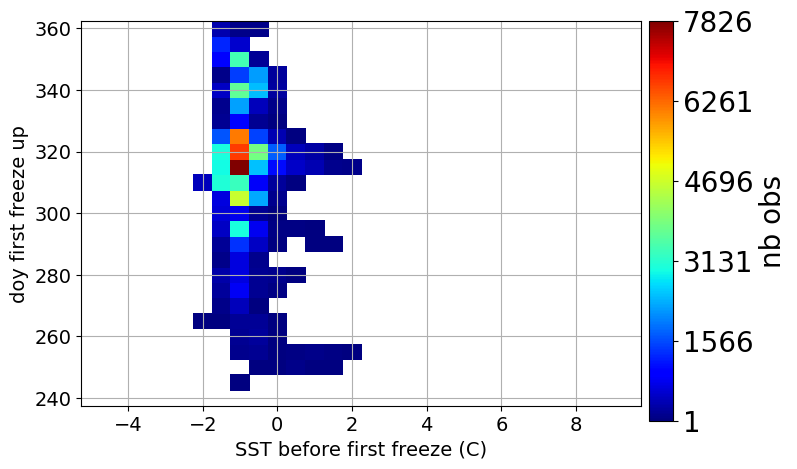

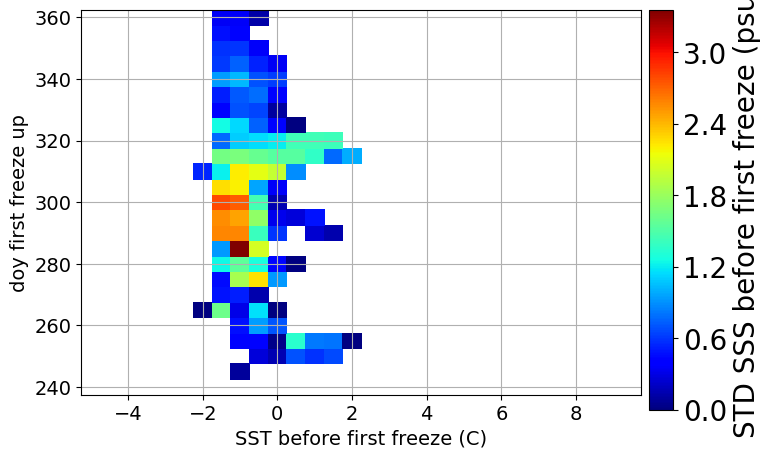

In [81]:
[datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms]=ffgridrms(temp_beforefirstfreeze[:,:,0].squeeze(),doy_freeze_first,sal_beforefirstfreeze[:,:,0].squeeze(),SSTgrid,DOYgrid)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTgrid,DOYgrid,datagrid_mean,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('mean SSS before first freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTgrid,DOYgrid,datagrid_median,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('median SSS before first freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTgrid,DOYgrid,ngrid,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('nb obs',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTgrid,DOYgrid,datagridstd,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('STD SSS before first freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

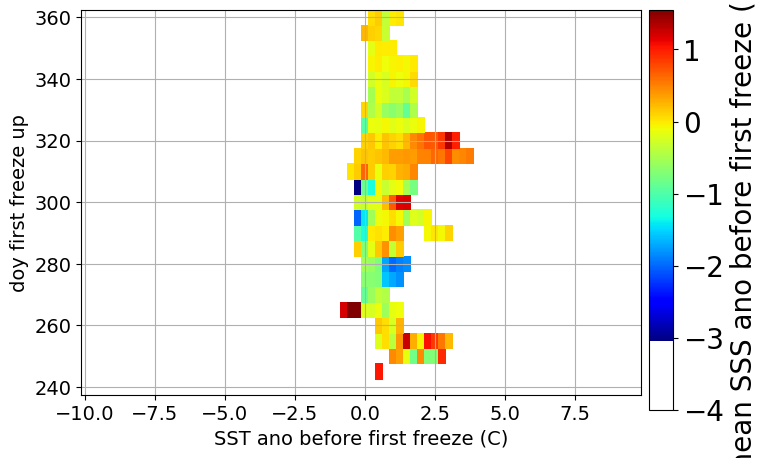

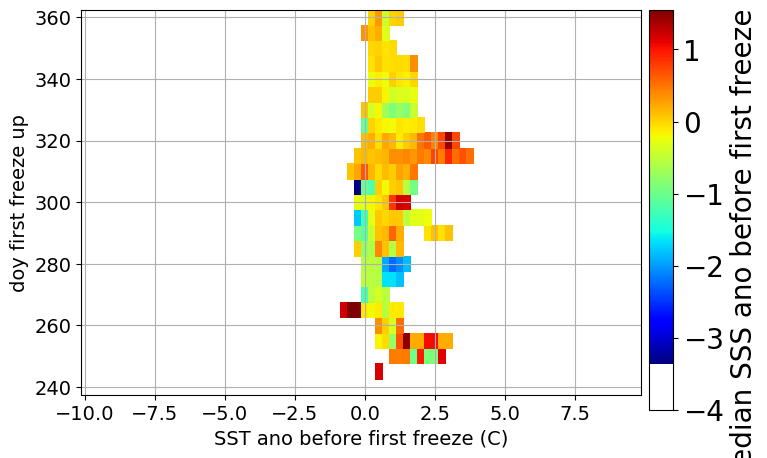

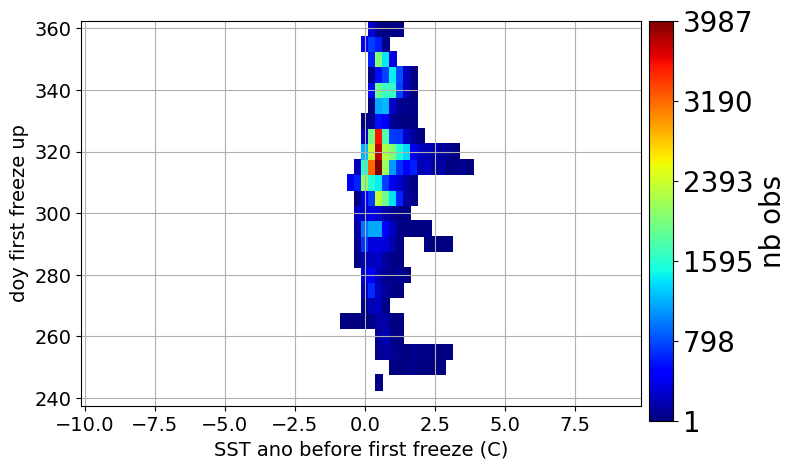

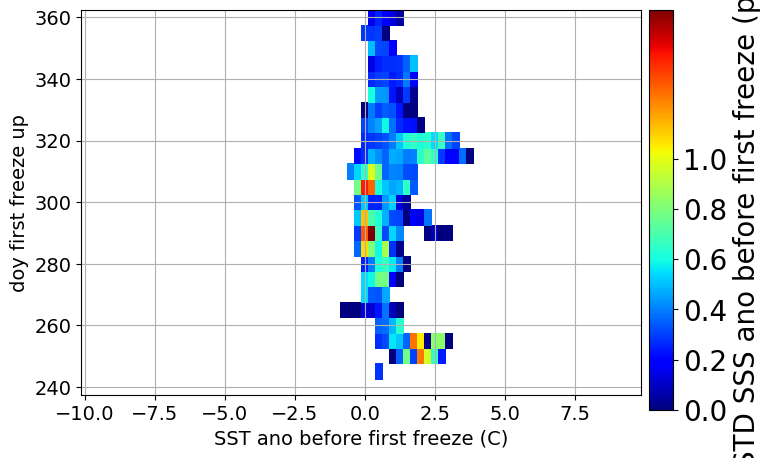

In [82]:
[datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms]=ffgridrms(ano_temp_beforefirstfreeze[:,:,0].squeeze(),doy_freeze_first,ano_sal_beforefirstfreeze[:,:,0].squeeze(),SSTanogrid,DOYgrid)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTanogrid,DOYgrid,datagrid_mean,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('mean SSS ano before first freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTanogrid,DOYgrid,datagrid_median,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('median SSS ano before first freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTanogrid,DOYgrid,ngrid,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('nb obs',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTanogrid,DOYgrid,datagridstd,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before first freeze (C)', fontsize = 14)
ax.set_ylabel('doy first freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('STD SSS ano before first freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

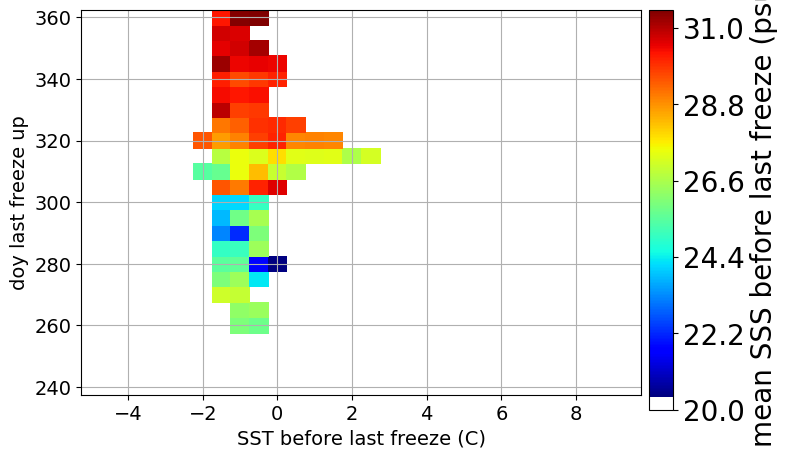

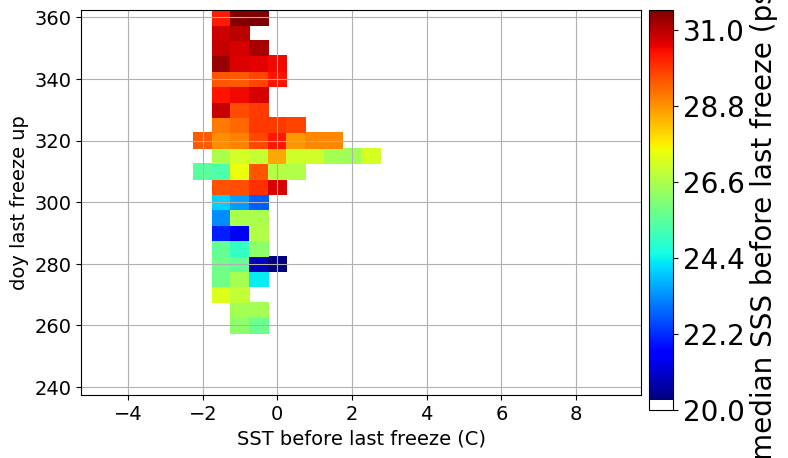

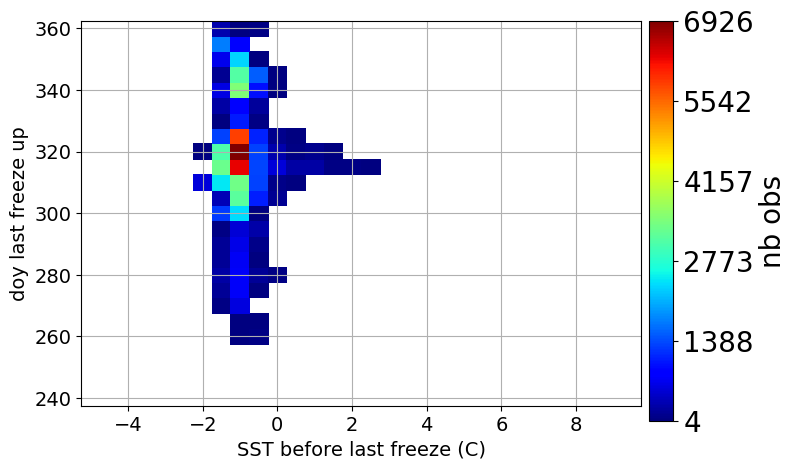

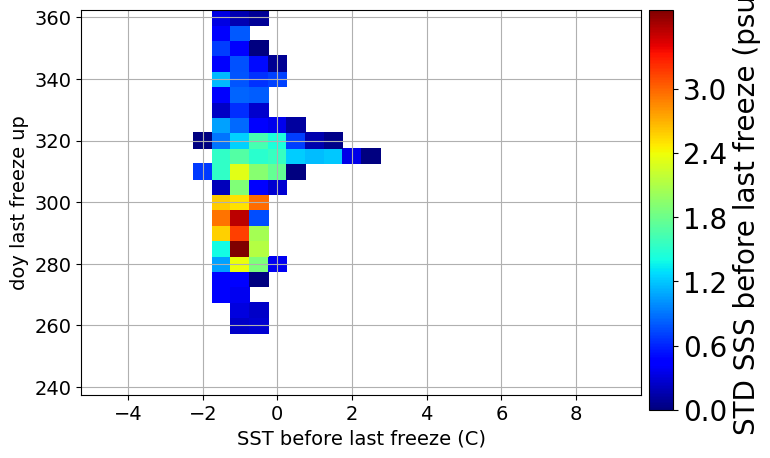

In [83]:
[datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms]=ffgridrms(temp_beforelastfreeze[:,:,0].squeeze(),doy_open_last+1,sal_beforelastfreeze[:,:,0].squeeze(),SSTgrid,DOYgrid)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTgrid,DOYgrid,datagrid_mean,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('mean SSS before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTgrid,DOYgrid,datagrid_median,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('median SSS before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTgrid,DOYgrid,ngrid,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('nb obs',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTgrid,DOYgrid,datagridstd,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('STD SSS before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)


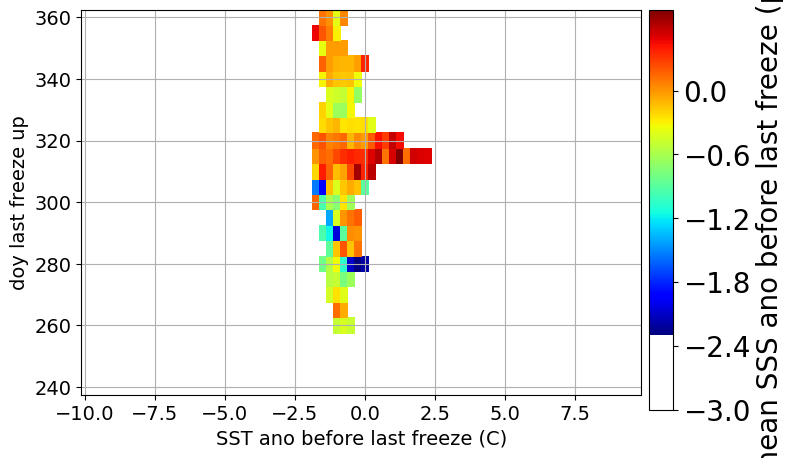

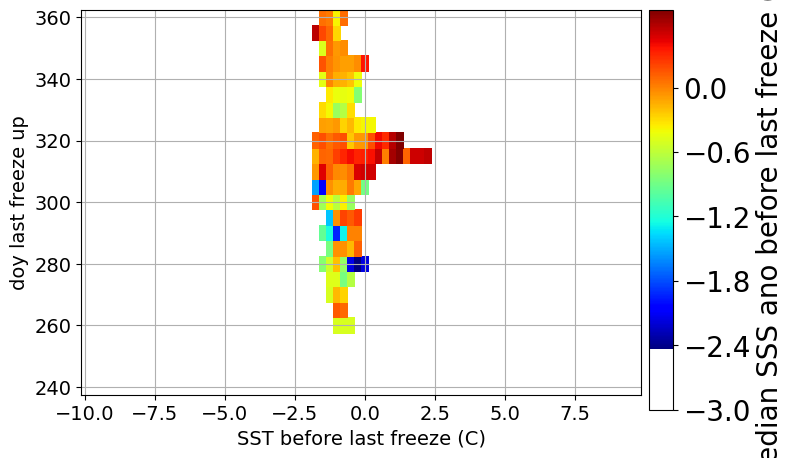

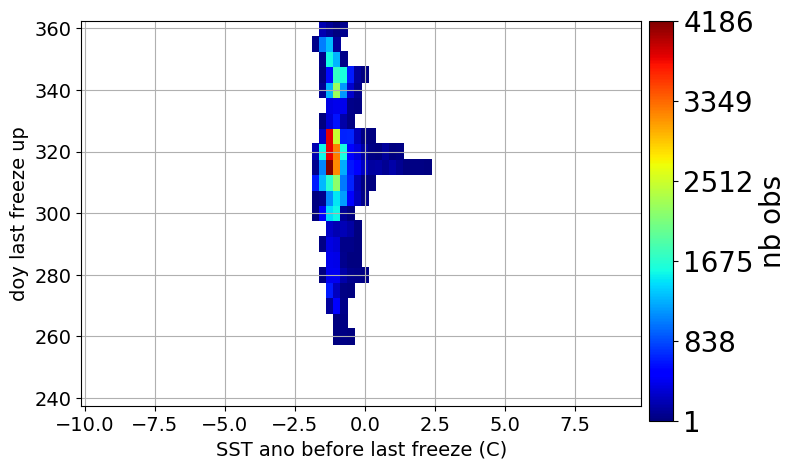

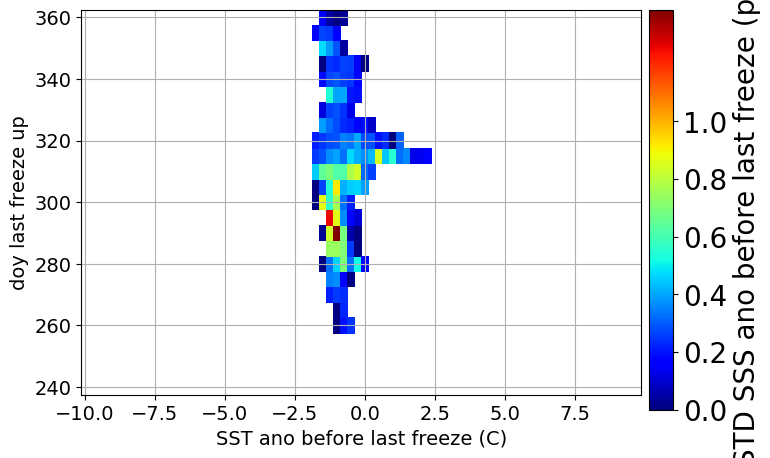

In [84]:
[datagrid_mean,datagrid_median,ngrid,datagridstd,datagridrms]=ffgridrms(temp_beforelastfreeze[:,:,0].squeeze(),doy_open_last+1,ano_sal_beforelastfreeze[:,:,0].squeeze(),SSTanogrid,DOYgrid)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTanogrid,DOYgrid,datagrid_mean,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('mean SSS ano before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTanogrid,DOYgrid,datagrid_median,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('median SSS ano before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTanogrid,DOYgrid,ngrid,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('nb obs',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)

fig,ax = plt.subplots(figsize=(8,5))
pp=plt.pcolor(SSTanogrid,DOYgrid,datagridstd,cmap=plt.cm.jet)
ax.grid()
ax.set_xlabel('SST ano before last freeze (C)', fontsize = 14)
ax.set_ylabel('doy last freeze up', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
# plt.xlim([0,30])
cbar_ax = fig.add_axes([0.81, 0.15, 0.03, 0.8])
h=plt.colorbar(pp, cax=cbar_ax,orientation='vertical',ax=ax)
h.ax.tick_params(labelsize=20)
h.set_label('STD SSS ano before last freeze (psu)',fontsize=20)
cmin,cmax = h.mappable.get_clim()
ticks = np.linspace(np.floor(cmin),np.floor(cmax),6)
h.set_ticks(ticks)
plt.subplots_adjust(right=0.8,left=0.1,top=0.95,bottom=0.18)


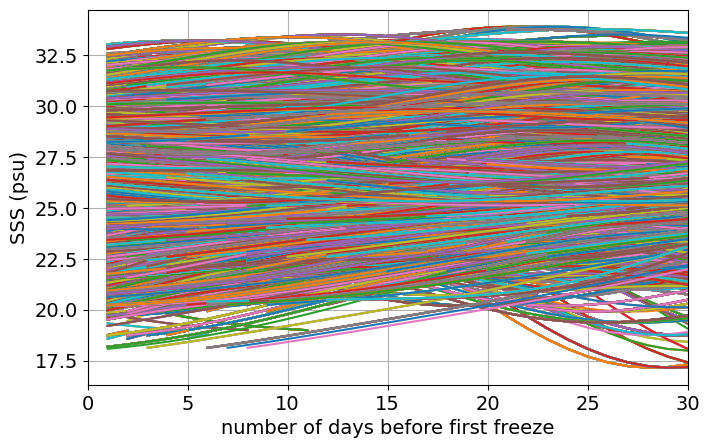

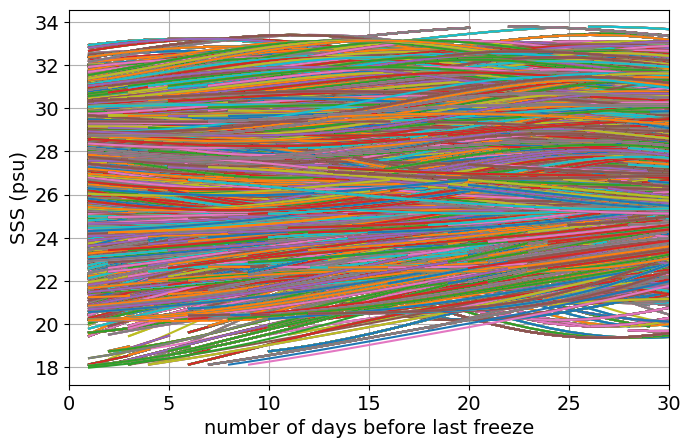

In [85]:
# SSS time series before first/last freeze
fig,ax = plt.subplots(figsize=(8,5))
for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        plt.plot(range(1,31),sal_beforefirstfreeze[i,j,:])
ax.grid()
ax.set_xlabel('number of days before first freeze', fontsize = 14)
ax.set_ylabel('SSS (psu)', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([0,30])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

fig,ax = plt.subplots(figsize=(8,5))
for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        plt.plot(range(1,31),sal_beforelastfreeze[i,j,:])
ax.grid()
ax.set_xlabel('number of days before last freeze', fontsize = 14)
ax.set_ylabel('SSS (psu)', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([0,30])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

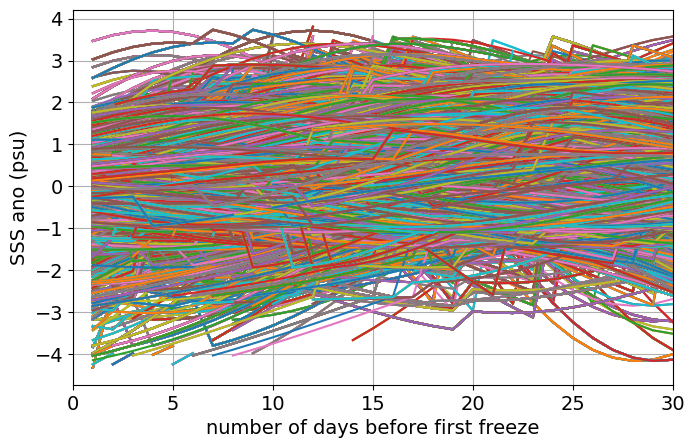

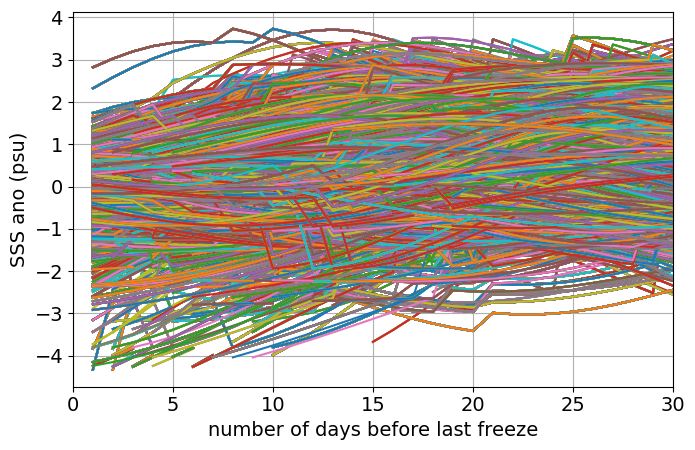

In [86]:
# SSS ano time series before first/last freeze
fig,ax = plt.subplots(figsize=(8,5))
for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        plt.plot(range(1,31),ano_sal_beforefirstfreeze[i,j,:])
ax.grid()
ax.set_xlabel('number of days before first freeze', fontsize = 14)
ax.set_ylabel('SSS ano (psu)', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([0,30])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

fig,ax = plt.subplots(figsize=(8,5))
for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        plt.plot(range(1,31),ano_sal_beforelastfreeze[i,j,:])
ax.grid()
ax.set_xlabel('number of days before last freeze', fontsize = 14)
ax.set_ylabel('SSS ano (psu)', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([0,30])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

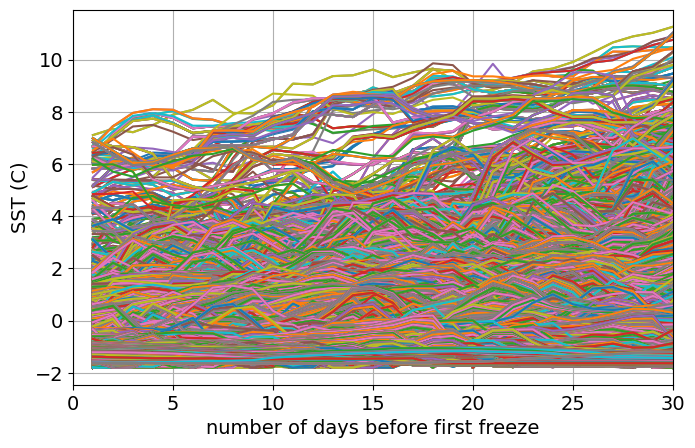

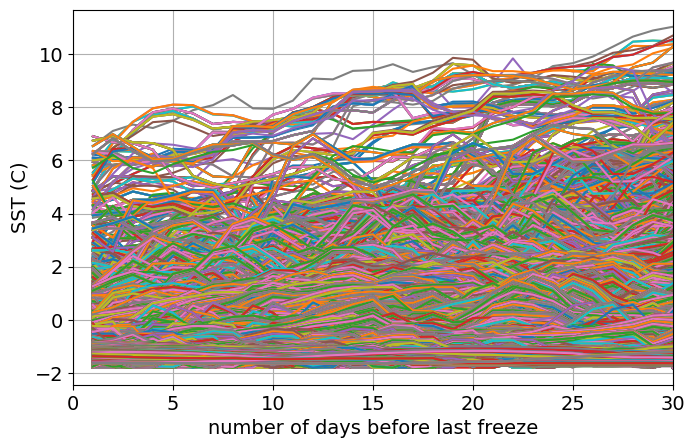

In [87]:
# SST time series before first/last freeze
fig,ax = plt.subplots(figsize=(8,5))
for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        plt.plot(range(1,31),temp_beforefirstfreeze[i,j,:])
ax.grid()
ax.set_xlabel('number of days before first freeze', fontsize = 14)
ax.set_ylabel('SST (C)', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([0,30])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

fig,ax = plt.subplots(figsize=(8,5))
for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        plt.plot(range(1,31),temp_beforelastfreeze[i,j,:])
ax.grid()
ax.set_xlabel('number of days before last freeze', fontsize = 14)
ax.set_ylabel('SST (C)', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([0,30])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

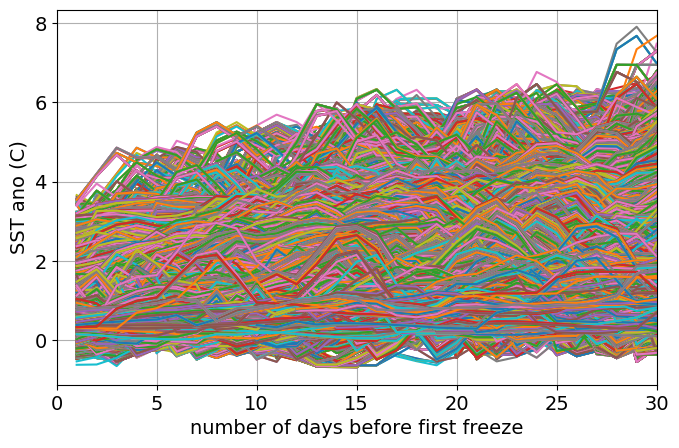

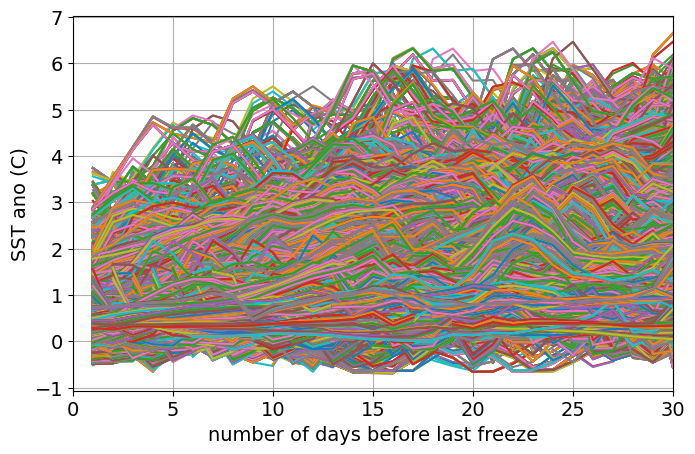

In [88]:
# SST time series before first/last freeze
fig,ax = plt.subplots(figsize=(8,5))
for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        plt.plot(range(1,31),ano_temp_beforefirstfreeze[i,j,:])
ax.grid()
ax.set_xlabel('number of days before first freeze', fontsize = 14)
ax.set_ylabel('SST ano (C)', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([0,30])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

fig,ax = plt.subplots(figsize=(8,5))
for i in range(0,len(nws.lat)):
    for j in range(0,len(nws.lon)):
        plt.plot(range(1,31),ano_temp_beforelastfreeze[i,j,:])
ax.grid()
ax.set_xlabel('number of days before last freeze', fontsize = 14)
ax.set_ylabel('SST ano (C)', fontsize = 14)
plt.tick_params(axis='both', which='major', labelsize = 14)
# plt.ylim([0,n.max()+n.max()*0.01])
plt.xlim([0,30])
plt.subplots_adjust(right=0.9,left=0.15,top=0.9,bottom=0.15)

In [89]:
year

2019